# imports 

In [ ]:
!wget https://figshare.com/ndownloader/files/36977293 -O ThingsEEG-Text.zip

In [ ]:
!mkdir data/

In [ ]:
!mv ThingsEEG-Text.zip data/


In [ ]:
cd data/

In [ ]:
!unzip ThingsEEG-Text.zip

In [ ]:
cd ..

# data exploration
 

First we organise the data for proccesimg


In [1]:
import torch
import os
import scipy.io as sio
from sklearn.model_selection import train_test_split
import numpy as np

# load data
data_dir_root = os.path.join('./data', 'ThingsEEG-Text')
sbj = 'sub-10'
image_model = 'pytorch/cornet_s'
text_model = 'CLIPText'
roi = '17channels'
brain_dir = os.path.join(data_dir_root, 'brain_feature', roi, sbj)
image_dir_seen = os.path.join(data_dir_root, 'visual_feature/ThingsTrain', image_model, sbj)
image_dir_unseen = os.path.join(data_dir_root, 'visual_feature/ThingsTest', image_model, sbj)
text_dir_seen = os.path.join(data_dir_root, 'textual_feature/ThingsTrain/text', text_model, sbj)
text_dir_unseen = os.path.join(data_dir_root, 'textual_feature/ThingsTest/text', text_model, sbj)

brain_seen = sio.loadmat(os.path.join(brain_dir, 'eeg_train_data_within.mat'))['data'].astype('double') * 2.0
brain_seen = brain_seen[:,:,27:60] # 70ms-400ms
brain_seen = np.reshape(brain_seen, (brain_seen.shape[0], -1))
image_seen = sio.loadmat(os.path.join(image_dir_seen, 'feat_pca_train.mat'))['data'].astype('double')*50.0
text_seen = sio.loadmat(os.path.join(text_dir_seen, 'text_feat_train.mat'))['data'].astype('double')*2.0
label_seen = sio.loadmat(os.path.join(brain_dir, 'eeg_train_data_within.mat'))['class_idx'].T.astype('int')
image_seen = image_seen[:,0:100]

brain_unseen = sio.loadmat(os.path.join(brain_dir, 'eeg_test_data.mat'))['data'].astype('double')*2.0
brain_unseen = brain_unseen[:, :, 27:60]
brain_unseen = np.reshape(brain_unseen, (brain_unseen.shape[0], -1))
image_unseen = sio.loadmat(os.path.join(image_dir_unseen, 'feat_pca_test.mat'))['data'].astype('double')*50.0
text_unseen = sio.loadmat(os.path.join(text_dir_unseen, 'text_feat_test.mat'))['data'].astype('double')*2.0
label_unseen = sio.loadmat(os.path.join(brain_dir, 'eeg_test_data.mat'))['class_idx'].T.astype('int')
image_unseen = image_unseen[:, 0:100]

brain_seen = torch.from_numpy(brain_seen)
brain_unseen = torch.from_numpy(brain_unseen)
image_seen = torch.from_numpy(image_seen)
image_unseen = torch.from_numpy(image_unseen)
text_seen = torch.from_numpy(text_seen)
text_unseen = torch.from_numpy(text_unseen)
label_seen = torch.from_numpy(label_seen)
label_unseen = torch.from_numpy(label_unseen)

print('seen_brain_samples=', brain_seen.shape[0], ', seen_brain_features=', brain_seen.shape[1])
print('seen_image_samples=', image_seen.shape[0], ', seen_image_features=', image_seen.shape[1])
print('seen_text_samples=', text_seen.shape[0], ', seen_text_features=', text_seen.shape[1])
print('seen_label=', label_seen.shape)
print('unseen_brain_samples=', brain_unseen.shape[0], ', unseen_brain_features=', brain_unseen.shape[1])
print('unseen_image_samples=', image_unseen.shape[0], ', unseen_image_features=', image_unseen.shape[1])
print('unseen_text_samples=', text_unseen.shape[0], ', unseen_text_features=', text_unseen.shape[1])
print('unseen_label=', label_unseen.shape)

seen_brain_samples= 16540 , seen_brain_features= 561
seen_image_samples= 16540 , seen_image_features= 100
seen_text_samples= 16540 , seen_text_features= 512
seen_label= torch.Size([16540, 1])
unseen_brain_samples= 16000 , unseen_brain_features= 561
unseen_image_samples= 16000 , unseen_image_features= 100
unseen_text_samples= 16000 , unseen_text_features= 512
unseen_label= torch.Size([16000, 1])


In [2]:
import numpy as np
import pandas as pd

# Convert tensors to numpy arrays
brain_seen_np = brain_seen.numpy()
brain_unseen_np = brain_unseen.numpy()
image_seen_np = image_seen.numpy()
image_unseen_np = image_unseen.numpy()
text_seen_np = text_seen.numpy()
text_unseen_np = text_unseen.numpy()
label_seen_np = label_seen.numpy().ravel()
label_unseen_np = label_unseen.numpy().ravel()

# Create pandas DataFrames
df_brain_seen = pd.DataFrame(brain_seen_np)
df_brain_unseen = pd.DataFrame(brain_unseen_np)
df_image_seen = pd.DataFrame(image_seen_np)
df_image_unseen = pd.DataFrame(image_unseen_np)
df_text_seen = pd.DataFrame(text_seen_np)
df_text_unseen = pd.DataFrame(text_unseen_np)
df_label_seen = pd.DataFrame(label_seen_np, columns=['label'])
df_label_unseen = pd.DataFrame(label_unseen_np, columns=['label'])

Number of samples per seen class:
label
1       10
2       10
3       10
4       10
5       10
        ..
1650    10
1651    10
1652    10
1653    10
1654    10
Name: count, Length: 1654, dtype: int64

Number of samples per unseen class:
label
1      80
2      80
3      80
4      80
5      80
       ..
196    80
197    80
198    80
199    80
200    80
Name: count, Length: 200, dtype: int64


/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_9250/30473024.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_counts_seen.index, y=class_counts_seen.values, palette='viridis')


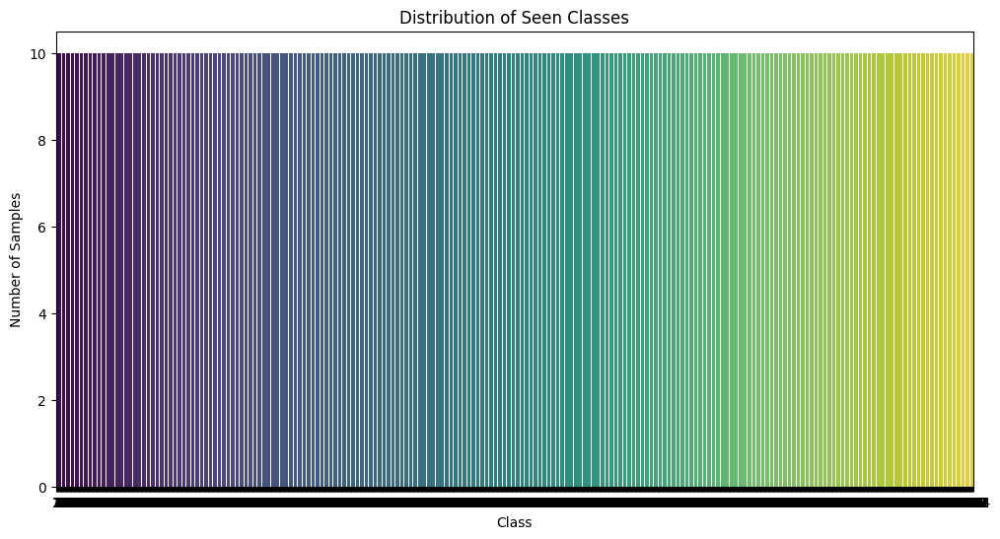

/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_9250/30473024.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_counts_unseen.index, y=class_counts_unseen.values, palette='viridis')


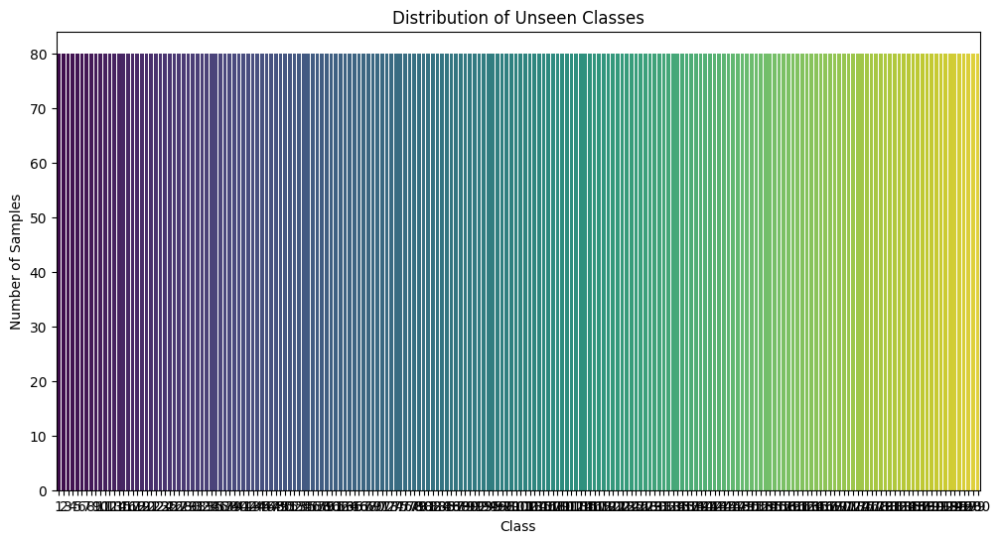

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Count the number of samples per class for seen and unseen labels
class_counts_seen = df_label_seen['label'].value_counts().sort_index()
class_counts_unseen = df_label_unseen['label'].value_counts().sort_index()

print("Number of samples per seen class:")
print(class_counts_seen)

print("\nNumber of samples per unseen class:")
print(class_counts_unseen)

# Plot the distribution of seen classes
plt.figure(figsize=(12, 6))
sns.barplot(x=class_counts_seen.index, y=class_counts_seen.values, palette='viridis')
plt.title('Distribution of Seen Classes')
plt.xlabel('Class')
plt.ylabel('Number of Samples')
plt.show()

# Plot the distribution of unseen classes
plt.figure(figsize=(12, 6))
sns.barplot(x=class_counts_unseen.index, y=class_counts_unseen.values, palette='viridis')
plt.title('Distribution of Unseen Classes')
plt.xlabel('Class')
plt.ylabel('Number of Samples')
plt.show()

## brain data

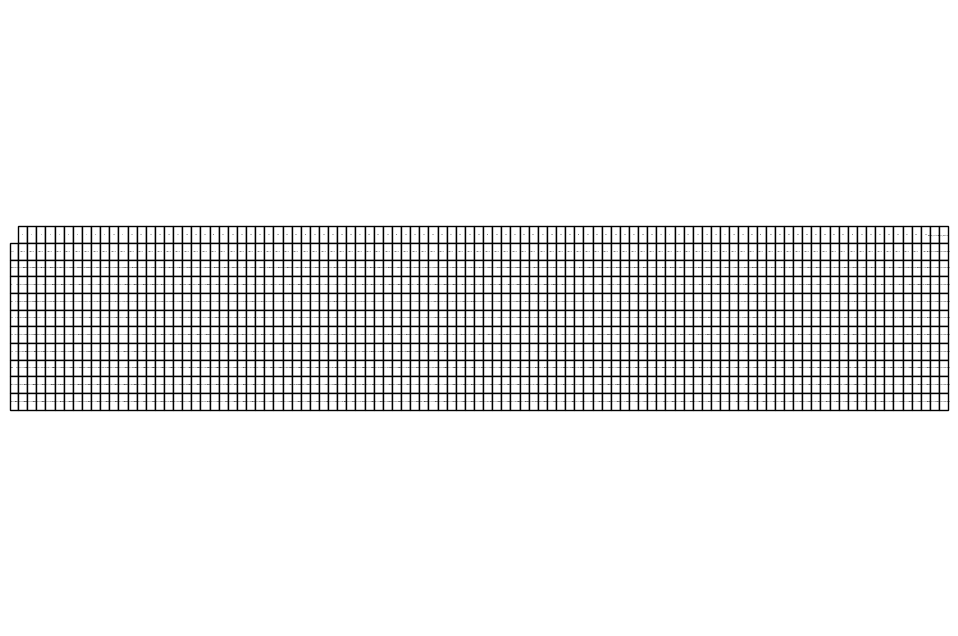

In [4]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew
import matplotlib.pyplot as plt

# Assuming df_image_seen is your DataFrame containing the image data

# Calculate summary statistics
summary_stats = df_image_seen.describe()

# Calculate kurtosis and skewness for each column
kurtosis_values = df_image_seen.apply(kurtosis)
skewness_values = df_image_seen.apply(skew)

# Add kurtosis and skewness to the summary statistics
summary_stats.loc['kurtosis'] = kurtosis_values
summary_stats.loc['skewness'] = skewness_values

# Calculate the maximum and minimum of all features
max_all_features = df_image_seen.max().max()
min_all_features = df_image_seen.min().min()

# Add the maximum and minimum of all features to the summary statistics
summary_stats['max_all_features'] = max_all_features
summary_stats['min_all_features'] = min_all_features

# Create a table plot
fig, ax = plt.subplots(figsize=(12, 8))  # Adjust the size as needed
ax.axis('tight')
ax.axis('off')
table = ax.table(cellText=summary_stats.values,
                 colLabels=summary_stats.columns,
                 rowLabels=summary_stats.index,
                 cellLoc='center',
                 loc='center')

# Save the table as an image
plt.savefig('summary_statistics_table.png', bbox_inches='tight', dpi=300)

# Show the plot (optional)
plt.show()

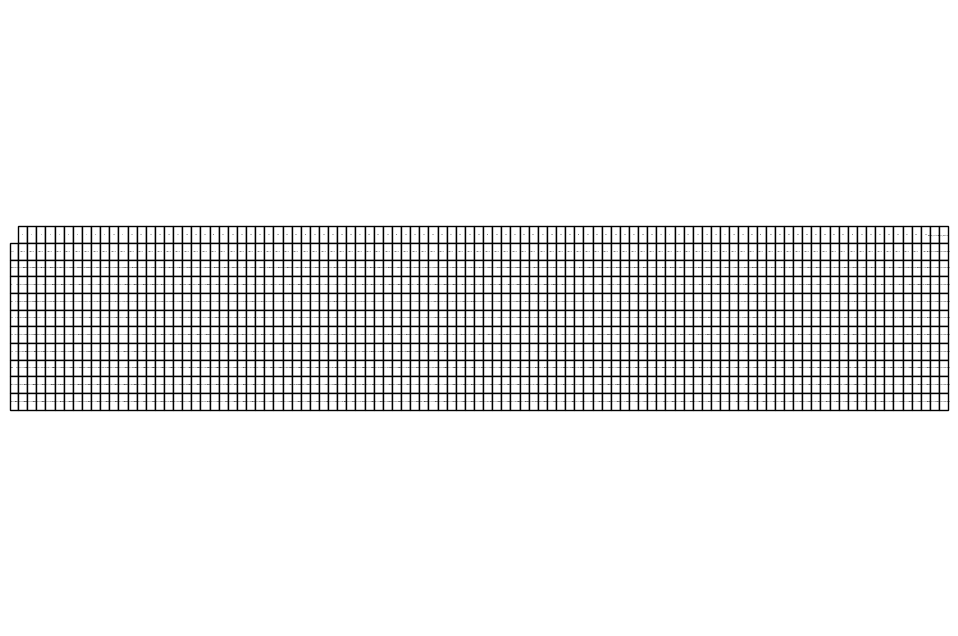

In [5]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew
import matplotlib.pyplot as plt

# Assuming df_image_seen is your DataFrame containing the image data

# Calculate summary statistics
summary_stats = df_image_seen.describe()

# Calculate kurtosis and skewness for each column
kurtosis_values = df_image_seen.apply(kurtosis)
skewness_values = df_image_seen.apply(skew)

# Add kurtosis and skewness to the summary statistics
summary_stats.loc['kurtosis'] = kurtosis_values
summary_stats.loc['skewness'] = skewness_values

# Calculate the maximum and minimum of all features
max_all_features = df_image_seen.max().max()
min_all_features = df_image_seen.min().min()

# Add the maximum and minimum of all features to the summary statistics
summary_stats['max_all_features'] = max_all_features
summary_stats['min_all_features'] = min_all_features

# Create a table plot
fig, ax = plt.subplots(figsize=(12, 8))  # Adjust the size as needed
ax.axis('tight')
ax.axis('off')
table = ax.table(cellText=summary_stats.values,
                 colLabels=summary_stats.columns,
                 rowLabels=summary_stats.index,
                 cellLoc='center',
                 loc='center')

# Save the table as an image
plt.savefig('summary_statistics_table.png', bbox_inches='tight', dpi=300)

# Show the plot (optional)
plt.show()

In [7]:
from scipy.stats import kurtosis, skew
# Calculate summary statistics
summary_stats = df_brain_seen.describe()

# Calculate kurtosis and skewness for each column
kurtosis_values = df_brain_seen.apply(kurtosis)
skewness_values = df_brain_seen.apply(skew)

# Add kurtosis and skewness to the summary statistics
summary_stats.loc['kurtosis'] = kurtosis_values
summary_stats.loc['skewness'] = skewness_values

# Print the summary statistics
print(summary_stats)

# Calculate the overall maximum and minimum values
overall_max = df_brain_seen.max().max()
overall_min = df_brain_seen.min().min()

# Print the summary statistics in a nice table format
print(summary_stats.to_string())

# Print the overall maximum and minimum values
print(f"\nOverall maximum value: {overall_max}")
print(f"Overall minimum value: {overall_min}")

                   0             1             2             3    \
count     16540.000000  16540.000000  16540.000000  16540.000000   
mean          0.076787      0.070698      0.028373     -0.044438   
std           0.583893      0.592233      0.610593      0.630831   
min          -2.762807     -2.598095     -2.349412     -2.818633   
25%          -0.309925     -0.320417     -0.378459     -0.459167   
50%           0.072401      0.068746      0.033988     -0.046756   
75%           0.464845      0.459148      0.433262      0.374403   
max           2.293334      2.570706      2.949977      2.507507   
kurtosis      0.177518      0.151441      0.140443      0.167769   
skewness     -0.000568      0.008291     -0.004874     -0.028480   

                   4             5             6             7    \
count     16540.000000  16540.000000  16540.000000  16540.000000   
mean         -0.067034     -0.127158     -0.140791     -0.122330   
std           0.641200      0.646158      0.652

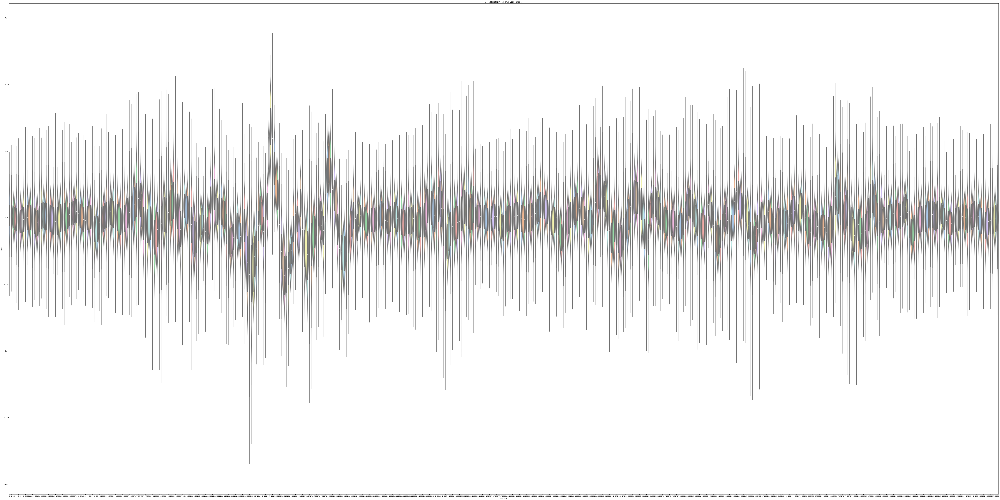

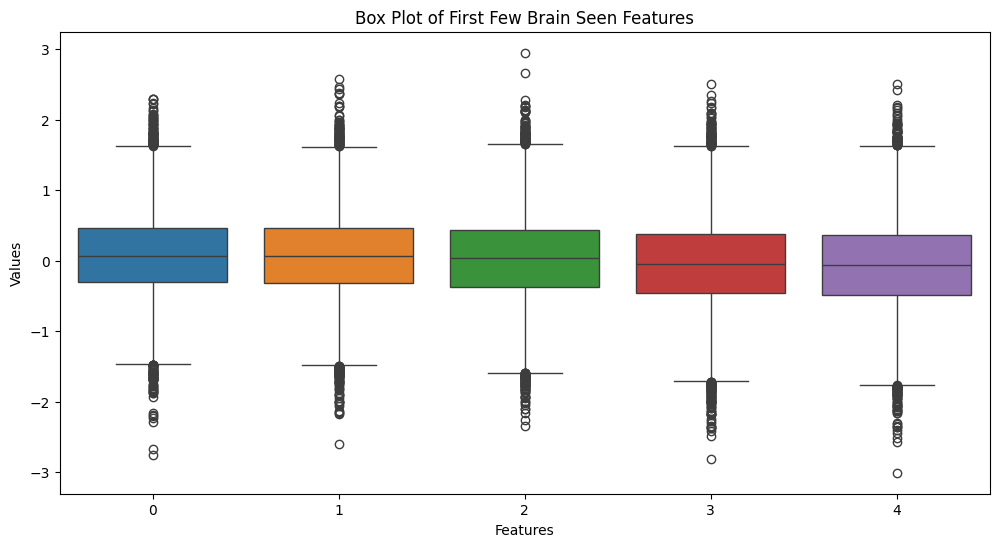

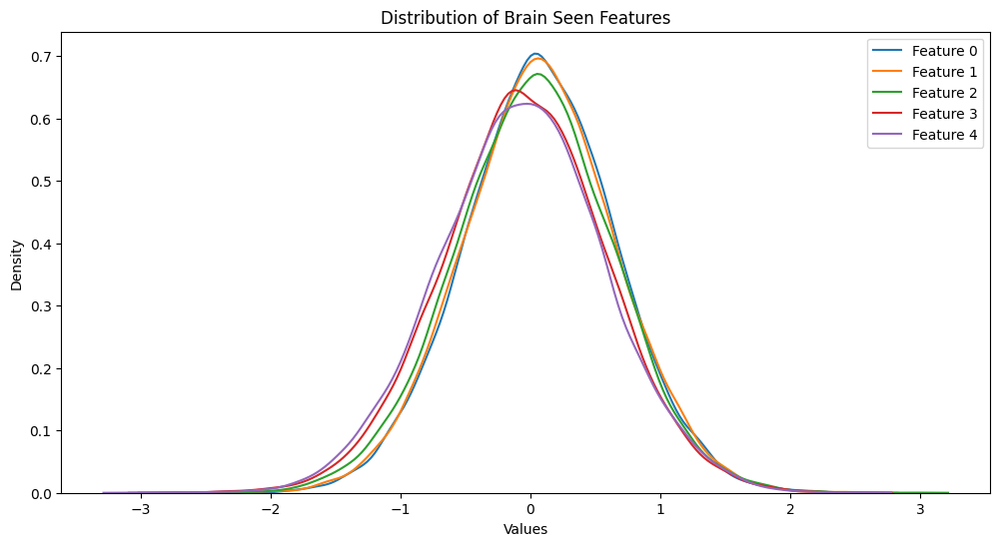

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
# Plot a box plot for the brain_seen DataFrame

# Create a violin plot for the first few features of the brain_seen DataFrame
plt.figure(figsize=(120, 60))
sns.violinplot(data=df_brain_seen, palette='pastel')

# Add title and labels
plt.title('Violin Plot of First Few Brain Seen Features')
plt.xlabel('Features')
plt.ylabel('Values')

# Show the plot
plt.show()

# Select the first few features for the box plot
num_features = 5  # Number of features to plot
df_brain_seen_subset = df_brain_seen.iloc[:, :num_features]

# Plot a box plot for the first few features of the brain_seen DataFrame
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_brain_seen_subset)
plt.title('Box Plot of First Few Brain Seen Features')
plt.xlabel('Features')
plt.ylabel('Values')
plt.show()


# Plot distribution graphs for the first few features
plt.figure(figsize=(12, 6))
for i in range(min(5, df_brain_seen.shape[1])):  # Plotting first 5 features for clarity
    sns.kdeplot(df_brain_seen.iloc[:, i], label=f'Feature {i}')
plt.title('Distribution of Brain Seen Features')
plt.xlabel('Values')
plt.ylabel('Density')
plt.legend()
plt.show()

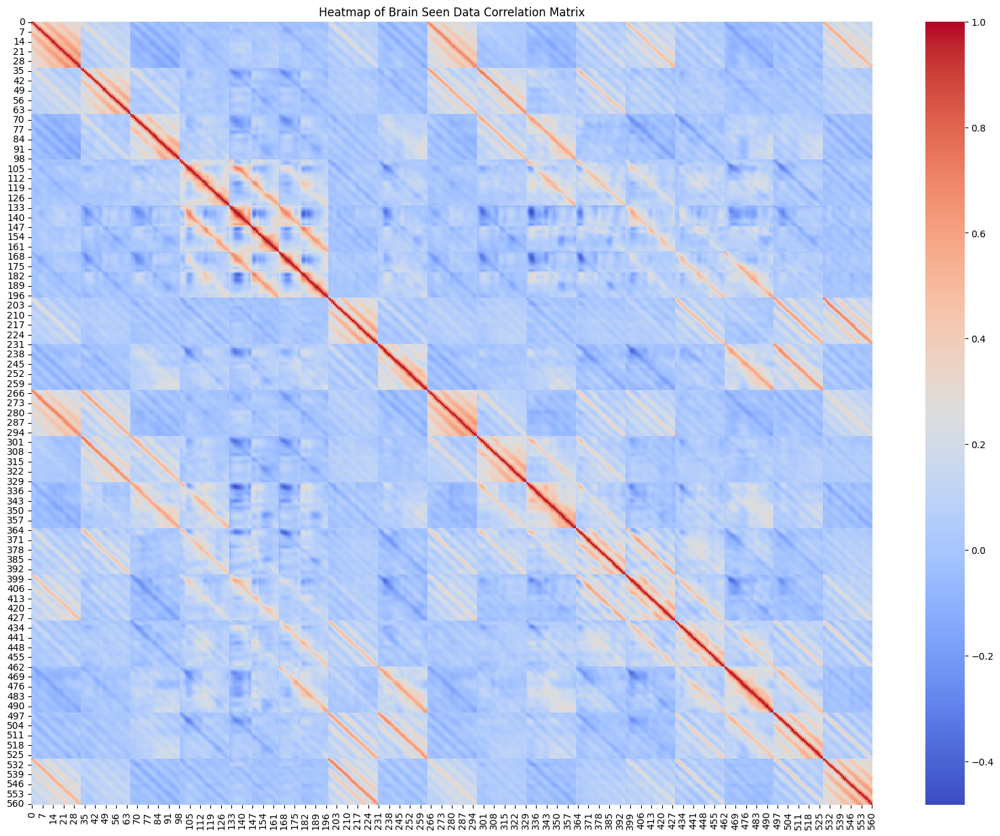

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the correlation matrix
correlation_matrix = df_brain_seen.corr()

# Create a heatmap
plt.figure(figsize=(20, 15))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.title('Heatmap of Brain Seen Data Correlation Matrix')
plt.show()

In [68]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
Zbrain_seen = pd.DataFrame(scaler.fit_transform(df_brain_seen), columns=df_brain_seen.columns)

# Create a violin plot of the normalized brain data
plt.figure(figsize=(200, 60))
sns.violinplot(data=Zbrain_seen)
plt.title('Violin Plot of Normalized Brain Data')
plt.xlabel('Columns')
plt.ylabel('Z-score Normalized Values')
plt.show()

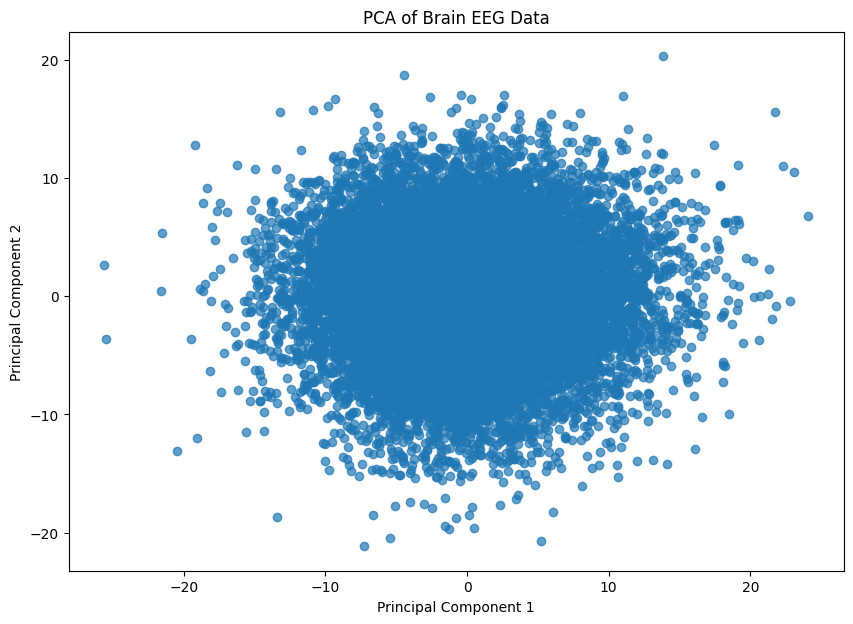

In [10]:
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Assuming df_brain_seen is your DataFrame containing the brain EEG data

# Perform PCA on the entire brain EEG data
pca = PCA(n_components=2)  # Adjust the number of components as needed
pca_result = pca.fit_transform(df_brain_seen)

# Create a DataFrame for the PCA results
pca_df = pd.DataFrame(pca_result, columns=['PC1', 'PC2'])

# Plot the PCA results
plt.figure(figsize=(10, 7))
plt.scatter(pca_df['PC1'], pca_df['PC2'], alpha=0.7)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Brain EEG Data')
plt.show()

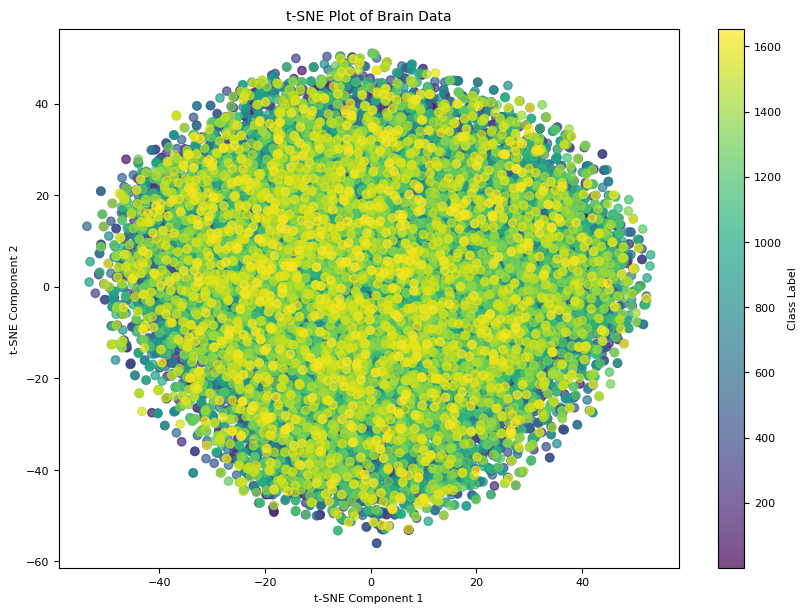

In [165]:
import numpy as np
import torch
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Assuming brain_seen and label_seen are your feature tensors and labels for the brain data

# Convert PyTorch tensors to NumPy arrays
brain_data = brain_seen.numpy()
labels = label_seen.numpy()

# Perform t-SNE on the brain data
tsne = TSNE(n_components=2, random_state=42)
brain_tsne = tsne.fit_transform(brain_data)

# Plot the t-SNE results
plt.figure(figsize=(10, 7))
scatter = plt.scatter(brain_tsne[:, 0], brain_tsne[:, 1], c=labels, cmap='viridis', alpha=0.7)
plt.colorbar(scatter, label='Class Label')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE Plot of Brain Data')
plt.show()

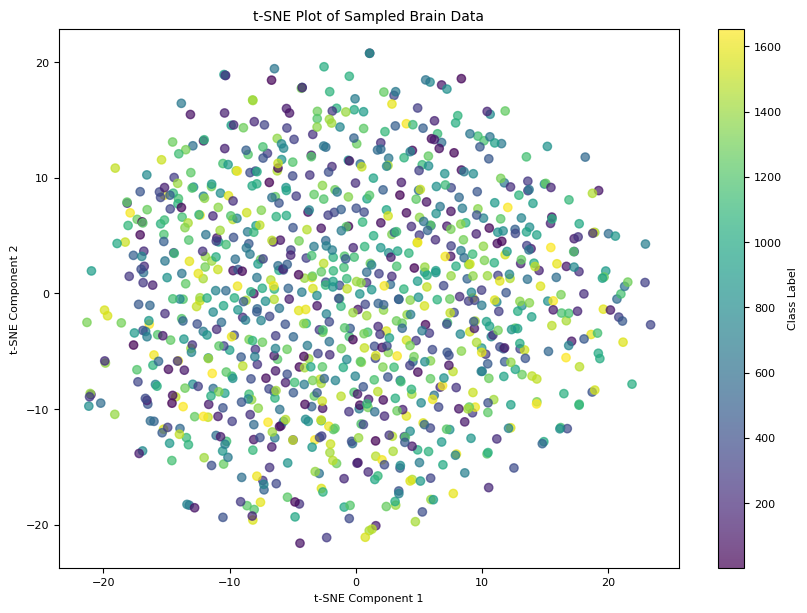

In [166]:
import numpy as np
import torch
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Assuming brain_seen and label_seen are your feature tensors and labels for the brain data

# Convert PyTorch tensors to NumPy arrays
brain_data = brain_seen.numpy()
labels = label_seen.numpy()

# Randomly sample a subset of the data
sample_size = 1000  # Adjust the sample size as needed
indices = np.random.choice(brain_data.shape[0], sample_size, replace=False)
brain_data_sampled = brain_data[indices]
labels_sampled = labels[indices]

# Perform t-SNE on the sampled brain data
tsne = TSNE(n_components=2, random_state=42)
brain_tsne = tsne.fit_transform(brain_data_sampled)

# Plot the t-SNE results
plt.figure(figsize=(10, 7))
scatter = plt.scatter(brain_tsne[:, 0], brain_tsne[:, 1], c=labels_sampled, cmap='viridis', alpha=0.7)
plt.colorbar(scatter, label='Class Label')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE Plot of Sampled Brain Data')
plt.show()

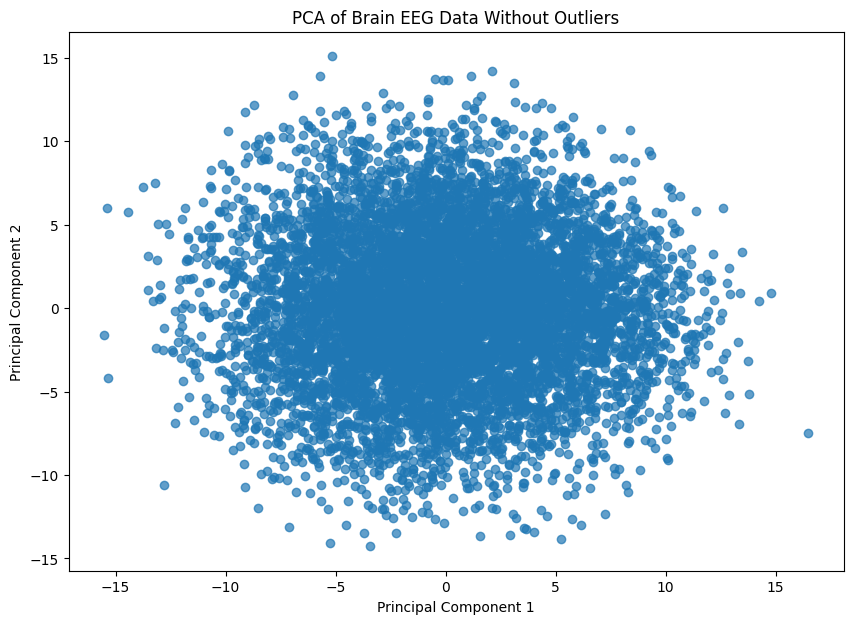

In [12]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Assuming df_brain_seen is your DataFrame containing the brain EEG data

# Calculate z-scores for the data
z_scores = zscore(df_brain_seen)

# Identify non-outliers (absolute z-score <= 2)
non_outliers = (np.abs(z_scores) <= 3).all(axis=1)

# Extract the non-outlier data
clean_data = df_brain_seen[non_outliers]

# Perform PCA on the non-outlier data
pca = PCA(n_components=2)  # Adjust the number of components as needed
pca_result = pca.fit_transform(clean_data)

# Create a DataFrame for the PCA results
pca_df = pd.DataFrame(pca_result, columns=['PC1', 'PC2'])

# Plot the PCA results
plt.figure(figsize=(10, 7))
plt.scatter(pca_df['PC1'], pca_df['PC2'], alpha=0.7)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Brain EEG Data Without Outliers')
plt.show()

from this we can see that the data is aproximately around zero but not quite and that it some what normal but we can re distribute it and also that there seem to be alot of outliers 

## image data 

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew

# Calculate summary statistics
summary_stats = df_image_seen.describe()

# Calculate kurtosis and skewness for each column
kurtosis_values = df_image_seen.apply(kurtosis)
skewness_values = df_image_seen.apply(skew)

# Add kurtosis and skewness to the summary statistics
summary_stats.loc['kurtosis'] = kurtosis_values
summary_stats.loc['skewness'] = skewness_values

# Calculate the maximum and minimum of all features
max_all_features = df_image_seen.max().max()
min_all_features = df_image_seen.min().min()

# Add the maximum and minimum of all features to the summary statistics
summary_stats['max_all_features'] = max_all_features
summary_stats['min_all_features'] = min_all_features

# Print the summary statistics
print(summary_stats)

In [22]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew

# Calculate summary statistics
summary_stats = df_image_seen.describe()

# Calculate kurtosis and skewness for each column
kurtosis_values = df_image_seen.apply(kurtosis)
skewness_values = df_image_seen.apply(skew)

# Add kurtosis and skewness to the summary statistics
summary_stats.loc['kurtosis'] = kurtosis_values
summary_stats.loc['skewness'] = skewness_values

# Calculate the maximum and minimum of all features
max_all_features = df_image_seen.max().max()
min_all_features = df_image_seen.min().min()

# Add the maximum and minimum of all features to the summary statistics
summary_stats['max_all_features'] = max_all_features
summary_stats['min_all_features'] = min_all_features

# Print the summary statistics
print(summary_stats)

                     0             1             2             3  \
count     1.654000e+04  16540.000000  16540.000000  16540.000000   
mean      7.021046e-07      0.000003     -0.000002      0.000006   
std       1.895756e+01     12.942754     11.084600      9.851502   
min      -5.981280e+01    -39.590445    -33.416805    -30.789775   
25%      -1.288678e+01     -9.228849     -7.590265     -6.798845   
50%      -3.255564e-01     -1.017976     -0.942980     -0.638693   
75%       1.294244e+01      8.059964      6.655328      6.088492   
max       6.249911e+01     59.701395     57.671976     82.544607   
kurtosis -2.441605e-01      0.383130      0.208381      0.729801   
skewness  3.975484e-02      0.489819      0.437242      0.437319   

                     4             5             6             7  \
count     1.654000e+04  16540.000000  16540.000000  16540.000000   
mean      6.106160e-07     -0.000003      0.000005      0.000012   
std       9.296208e+00      9.063340      8.386

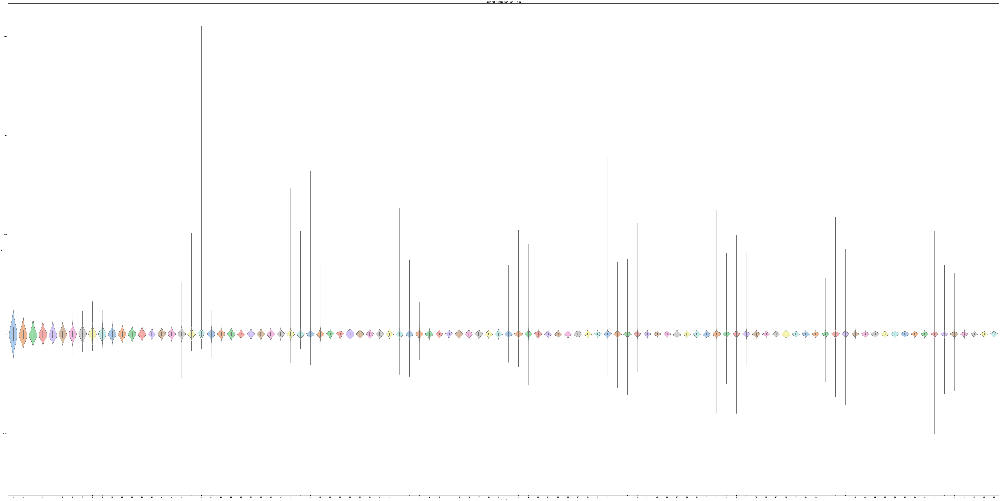

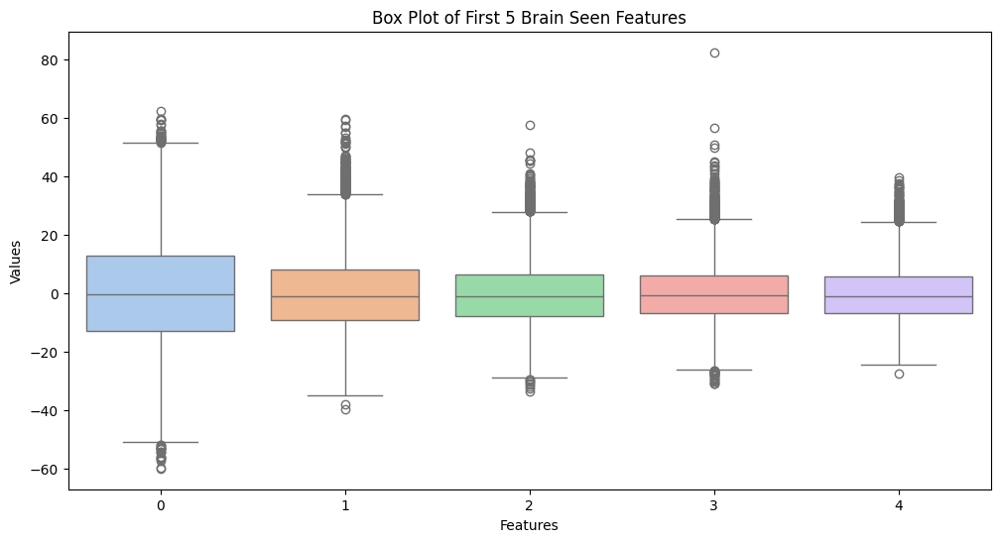

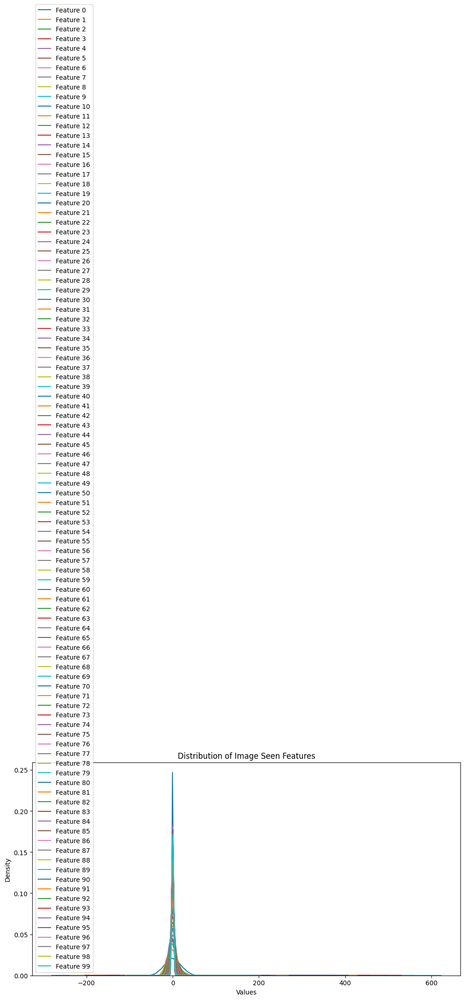

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Violin Plot for the whole brain_seen data
plt.figure(figsize=(120, 60))
sns.violinplot(data=df_image_seen, palette='pastel')
plt.title('Violin Plot of image seen Seen Features')
plt.xlabel('Features')
plt.ylabel('Values')
plt.show()

# Box Plot for the first 5 features of the brain_seen data
num_features = 5  # Number of features to plot
df_image_seen_subset = df_image_seen.iloc[:, :num_features]

plt.figure(figsize=(12, 6))
sns.boxplot(data=df_image_seen_subset, palette='pastel')
plt.title('Box Plot of First 5 Brain Seen Features')
plt.xlabel('Features')
plt.ylabel('Values')
plt.show()

# Distribution Plot for the image_seen data
plt.figure(figsize=(12, 6))
for i in range(df_image_seen.shape[1]):  # Plotting all features for clarity
    sns.kdeplot(df_image_seen.iloc[:, i], label=f'Feature {i}')
plt.title('Distribution of Image Seen Features')
plt.xlabel('Values')
plt.ylabel('Density')
plt.legend()
plt.show()

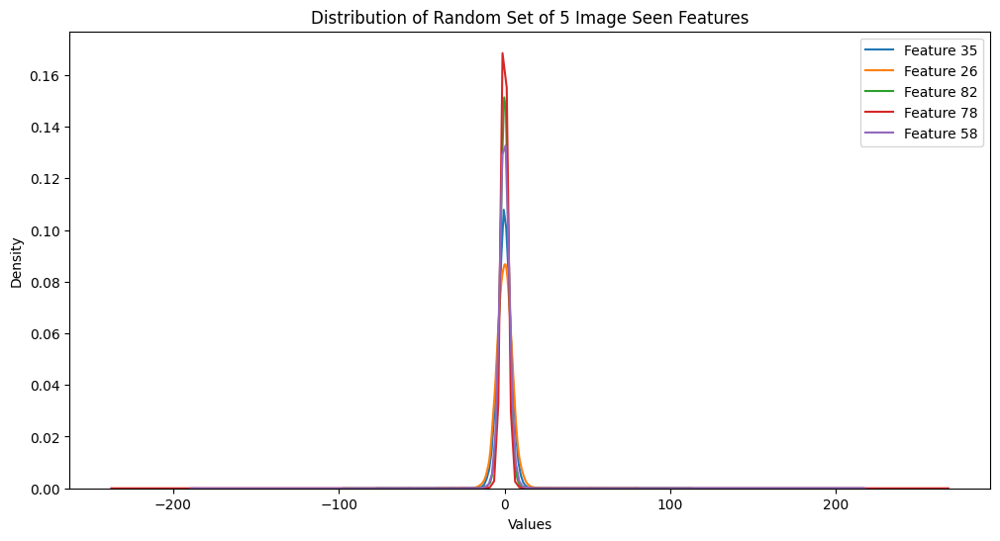

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Select a random set of 5 features
num_features = 5
random_features = np.random.choice(df_image_seen.columns, num_features, replace=False)

# Plot distribution graphs for the selected random features
plt.figure(figsize=(12, 6))
for feature in random_features:
    sns.kdeplot(df_image_seen[feature], label=f'Feature {feature}')
plt.title('Distribution of Random Set of 5 Image Seen Features')
plt.xlabel('Values')
plt.ylabel('Density')
plt.legend()

              0             1             2             3             4   \
0   1.000000e+00  5.149445e-08 -2.126713e-07 -8.521519e-07  9.947004e-08   
1   5.149445e-08  1.000000e+00 -2.383208e-08  5.600329e-07 -1.147125e-07   
2  -2.126713e-07 -2.383208e-08  1.000000e+00  3.214743e-07  2.248754e-08   
3  -8.521519e-07  5.600329e-07  3.214743e-07  1.000000e+00  1.615315e-07   
4   9.947004e-08 -1.147125e-07  2.248754e-08  1.615315e-07  1.000000e+00   
..           ...           ...           ...           ...           ...   
95  2.918980e-07  3.830493e-08 -4.699173e-07 -6.450134e-07 -2.994067e-07   
96 -2.898991e-07 -3.655371e-08 -4.031695e-08 -2.478371e-07  1.071269e-07   
97 -2.094069e-07 -3.161352e-07  2.936390e-07  5.115807e-07  1.985329e-07   
98 -4.718311e-07 -5.597378e-08  5.467894e-07  3.861113e-07  1.921355e-07   
99  1.572923e-08  1.257464e-07 -1.581151e-07 -1.611661e-07 -7.131927e-08   

              5             6             7             8             9   ...  \
0  -8.

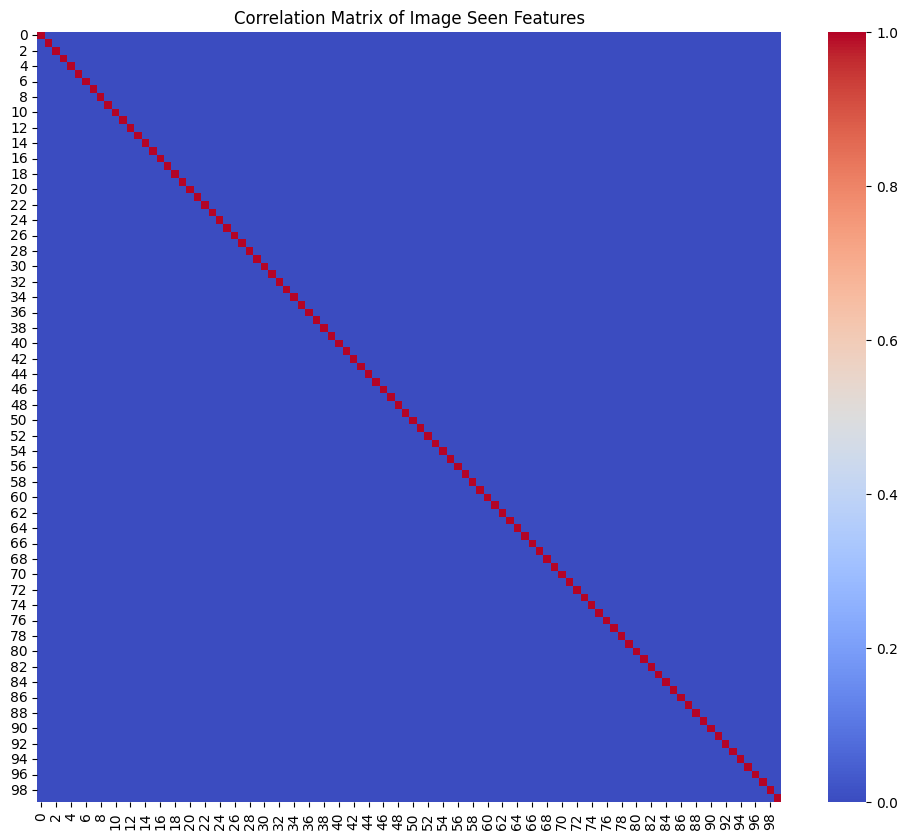

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the correlation matrix
correlation_matrix = df_image_seen.corr()

# Print the correlation matrix
print(correlation_matrix)

# Plot the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of Image Seen Features')
plt.show()

## text data 

In [37]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew
import matplotlib.pyplot as plt
import seaborn as sns


# Calculate summary statistics
summary_stats = df_text_seen.describe()

# Calculate kurtosis and skewness for each column
kurtosis_values = df_text_seen.apply(kurtosis)
skewness_values = df_text_seen.apply(skew)

# Add kurtosis and skewness to the summary statistics
summary_stats.loc['kurtosis'] = kurtosis_values
summary_stats.loc['skewness'] = skewness_values

# Calculate the maximum and minimum of all features
max_all_features = df_text_seen.max().max()
min_all_features = df_text_seen.min().min()

# Add the maximum and minimum of all features to the summary statistics
summary_stats['max_all_features'] = max_all_features
summary_stats['min_all_features'] = min_all_features

# Print the summary statistics
print(summary_stats)

                     0             1             2             3  \
count     16540.000000  16540.000000  16540.000000  16540.000000   
mean         -0.140649      0.202272     -0.169746      0.082375   
std           0.427863      0.470689      0.433599      0.422881   
min          -1.872249     -1.517790     -1.714530     -1.677265   
25%          -0.426021     -0.118238     -0.471276     -0.194574   
50%          -0.149874      0.216674     -0.183853      0.089877   
75%           0.135171      0.530111      0.124185      0.363391   
max           1.506855      1.761805      1.774198      1.577281   
kurtosis      0.169057     -0.121805     -0.059716      0.027136   
skewness      0.116508     -0.136991      0.122020     -0.105044   

                     4             5             6             7  \
count     16540.000000  16540.000000  16540.000000  16540.000000   
mean         -0.086476      0.035290     -0.132786     -0.695246   
std           0.460712      0.484910      0.435

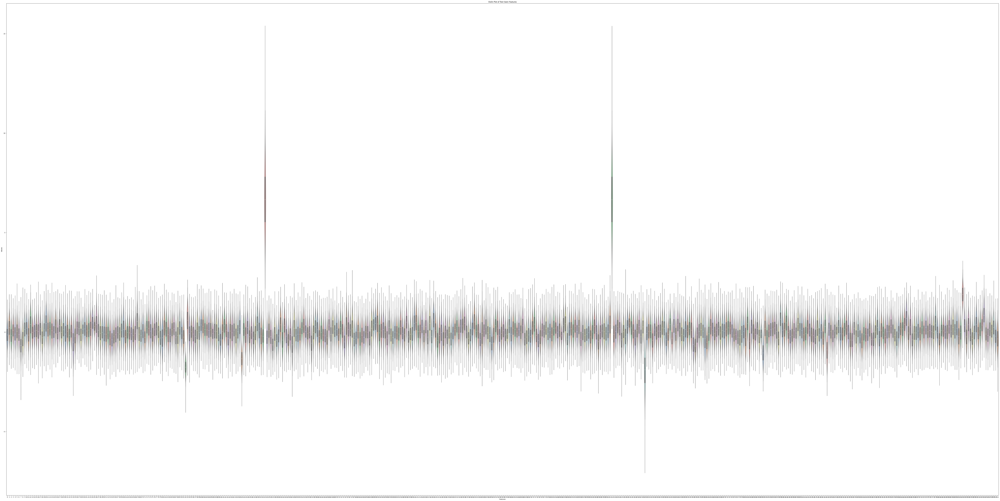

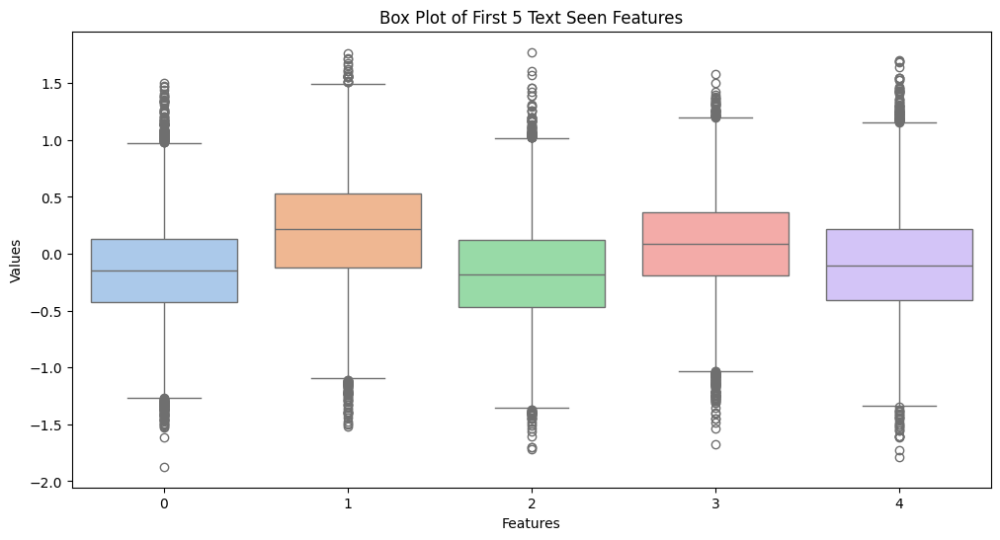

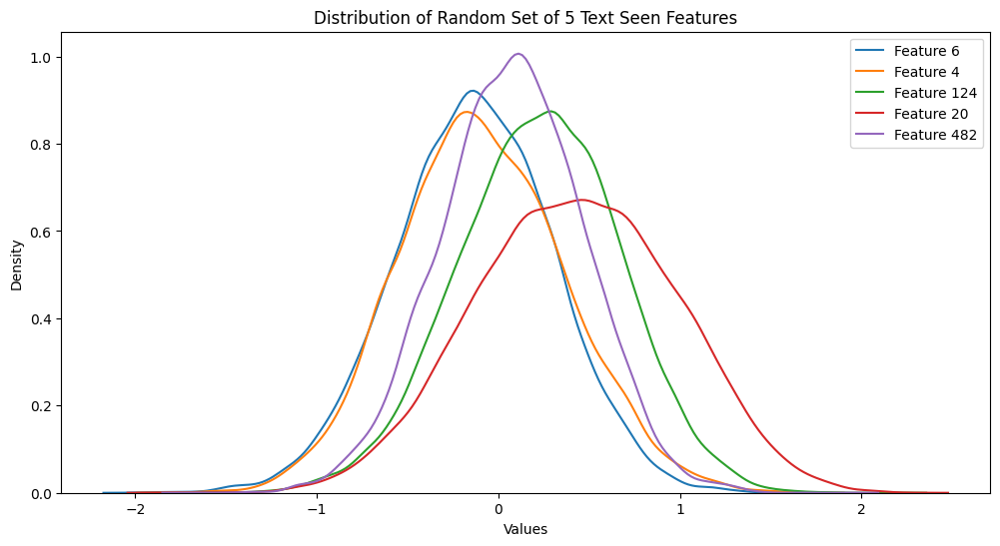

In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming text_seen is already converted to a DataFrame
df_text_seen = pd.DataFrame(text_seen.numpy())

# Violin Plot for the whole text_seen data
plt.figure(figsize=(120, 60))
sns.violinplot(data=df_text_seen, palette='pastel')
plt.title('Violin Plot of Text Seen Features')
plt.xlabel('Features')
plt.ylabel('Values')
plt.show()

# Box Plot for the first 5 features of the text_seen data
num_features = 5  # Number of features to plot
df_text_seen_subset = df_text_seen.iloc[:, :num_features]

plt.figure(figsize=(12, 6))
sns.boxplot(data=df_text_seen_subset, palette='pastel')
plt.title('Box Plot of First 5 Text Seen Features')
plt.xlabel('Features')
plt.ylabel('Values')
plt.show()

# Distribution Plot for a random set of 5 features of the text_seen data
random_features = np.random.choice(df_text_seen.columns, num_features, replace=False)

plt.figure(figsize=(12, 6))
for feature in random_features:
    sns.kdeplot(df_text_seen[feature], label=f'Feature {feature}')
plt.title('Distribution of Random Set of 5 Text Seen Features')
plt.xlabel('Values')
plt.ylabel('Density')
plt.legend()
plt.show()

          0         1         2         3         4         5         6    \
0    1.000000 -0.126879  0.026485 -0.023309  0.078197 -0.043618  0.060590   
1   -0.126879  1.000000 -0.130719 -0.081342 -0.136308 -0.064788 -0.108481   
2    0.026485 -0.130719  1.000000  0.088067 -0.051454 -0.060383 -0.064309   
3   -0.023309 -0.081342  0.088067  1.000000  0.082603 -0.090445  0.101889   
4    0.078197 -0.136308 -0.051454  0.082603  1.000000  0.044986 -0.001166   
..        ...       ...       ...       ...       ...       ...       ...   
507 -0.002967  0.051657 -0.011396 -0.058130 -0.005069  0.007645 -0.045434   
508  0.198280 -0.089985  0.098515  0.052421  0.017689 -0.178011 -0.247049   
509  0.092530 -0.124427  0.068895 -0.181737 -0.018119  0.022882 -0.239712   
510 -0.068541 -0.063402 -0.135209 -0.074443 -0.056496  0.080871  0.042590   
511  0.071766 -0.077267  0.035471 -0.104115 -0.037934 -0.019257  0.039479   

          7         8         9    ...       502       503       504  \
0  

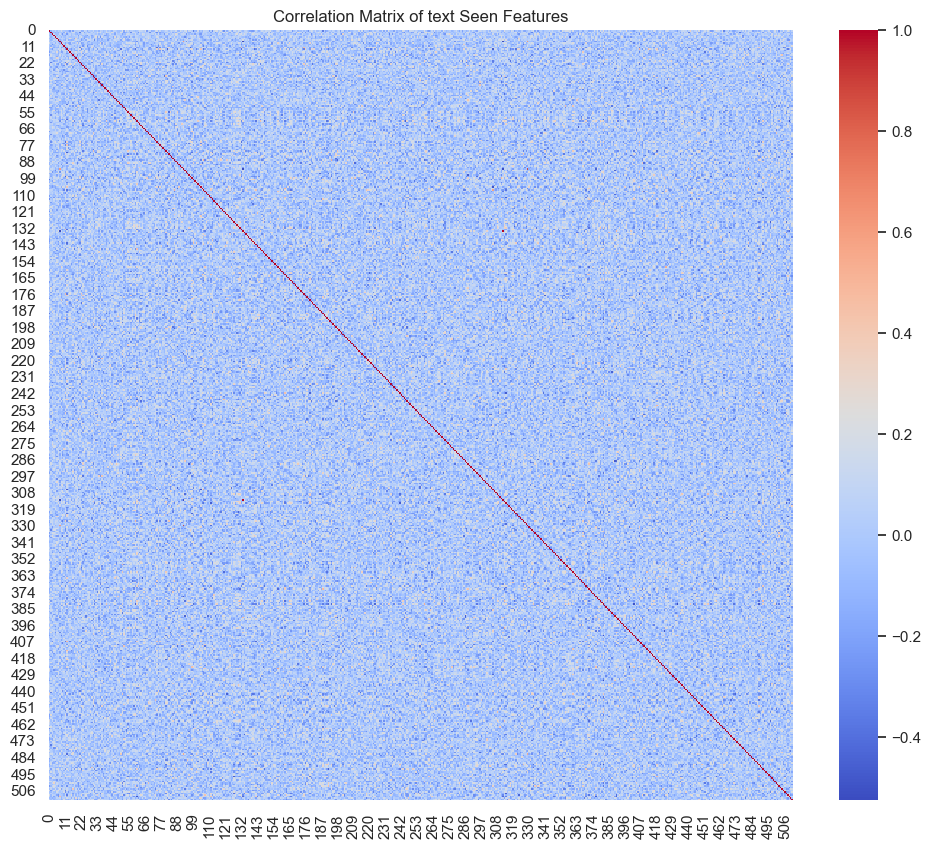

In [55]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the correlation matrix
correlation_matrix = df_text_seen.corr()

# Print the correlation matrix
print(correlation_matrix)

# Plot the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of text Seen Features')
plt.show()

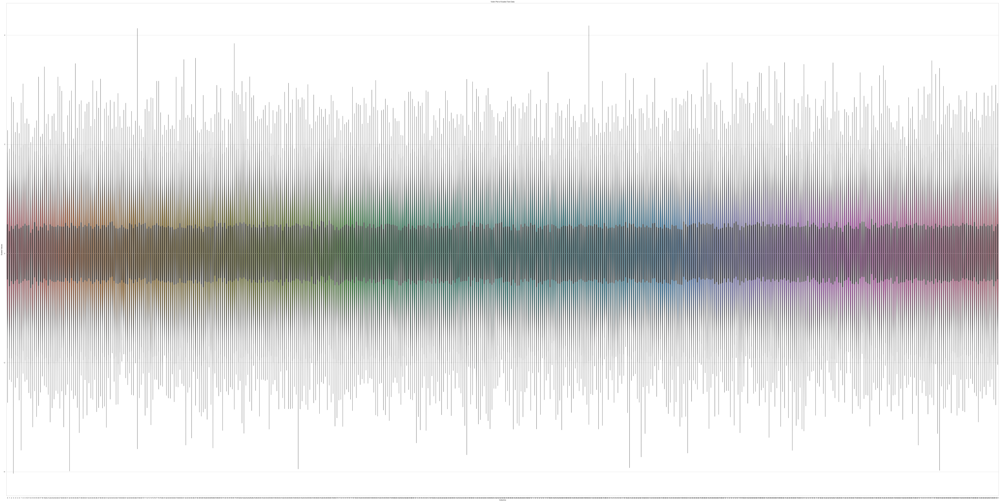

In [72]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import RobustScaler


scaler = RobustScaler()
Ztext_seen = pd.DataFrame(scaler.fit_transform(df_text_seen), columns=df_text_seen.columns)

# Create a violin plot of the scaled text data
plt.figure(figsize=(120, 60))
sns.violinplot(data=Ztext_seen)
plt.title('Violin Plot of Scaled Text Data')
plt.xlabel('Columns')
plt.ylabel('Scaled Values')
plt.show()

## combidned multi modal analyis 

In [30]:
import pandas as pd
import numpy as np

from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
import seaborn as sns

In [31]:
# A) Brain
brain_scaler = RobustScaler()
brain_scaled = brain_scaler.fit_transform(df_brain_seen.values)

# B) Image
image_scaler = RobustScaler()
image_scaled = image_scaler.fit_transform(df_image_seen.values)

# C) Text
text_scaler = RobustScaler()
text_scaled = text_scaler.fit_transform(df_text_seen.values)

In [32]:
pca_brain = PCA(n_components=3)
brain_pca = pca_brain.fit_transform(brain_scaled)

pca_image = PCA(n_components=3)
image_pca = pca_image.fit_transform(image_scaled)

pca_text = PCA(n_components=3)
text_pca = pca_text.fit_transform(text_scaled)

In [33]:
df_brain_pca = pd.DataFrame(brain_pca, columns=['PC1', 'PC2', 'PC3'])
df_brain_pca['modality'] = 'brain'
df_brain_pca['label'] = df_label_seen['label'].values  

df_image_pca = pd.DataFrame(image_pca, columns=['PC1', 'PC2', 'PC3'])
df_image_pca['modality'] = 'image'
df_image_pca['label'] = df_label_seen['label'].values

df_text_pca = pd.DataFrame(text_pca, columns=['PC1', 'PC2', 'PC3'])
df_text_pca['modality'] = 'text'
df_text_pca['label'] = df_label_seen['label'].values

In [73]:
tsne_brain = TSNE(n_components=2, perplexity=30, random_state=42)
brain_tsne = tsne_brain.fit_transform(brain_scaled)  # shape (num_samples, 2)

tsne_image = TSNE(n_components=2, perplexity=30, random_state=42)
image_tsne = tsne_image.fit_transform(image_scaled)

tsne_text = TSNE(n_components=2, perplexity=30, random_state=42)
text_tsne = tsne_text.fit_transform(text_scaled)

# Convert to DataFrame for plotting (if needed)
df_brain_tsne = pd.DataFrame(brain_tsne, columns=['tSNE1','tSNE2'])
df_brain_tsne['modality'] = 'brain'
df_brain_tsne['label'] = df_label_seen['label'].values

df_image_tsne = pd.DataFrame(image_tsne, columns=['tSNE1','tSNE2'])
df_image_tsne['modality'] = 'image'
df_image_tsne['label'] = df_label_seen['label'].values

df_text_tsne = pd.DataFrame(text_tsne, columns=['tSNE1','tSNE2'])
df_text_tsne['modality'] = 'text'
df_text_tsne['label'] = df_label_seen['label'].values

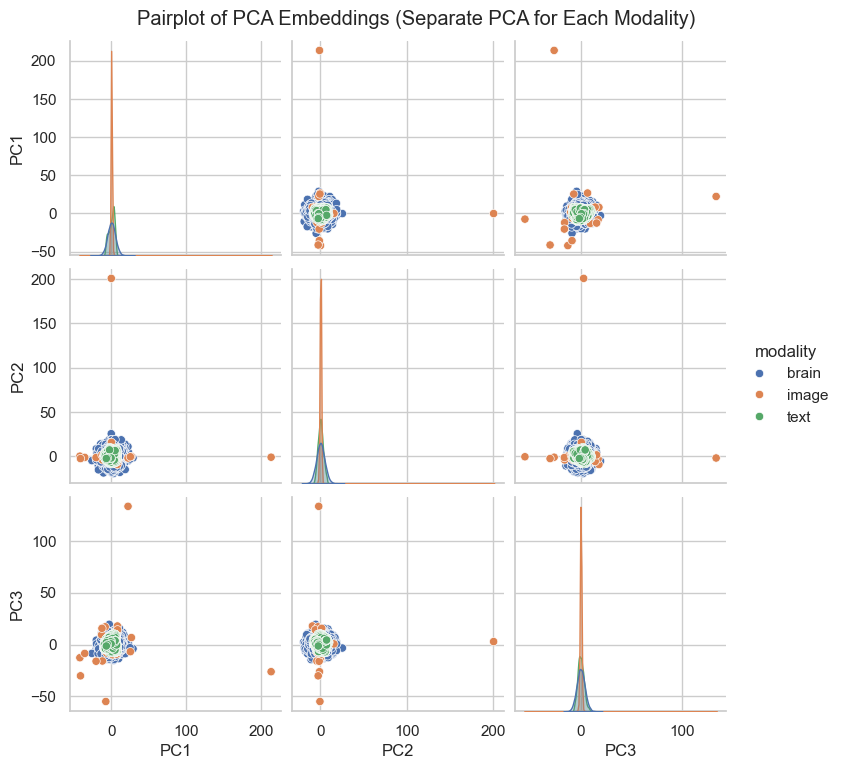

In [35]:
df_pca_combined = pd.concat([df_brain_pca, df_image_pca, df_text_pca], ignore_index=True)

sns.set(style='whitegrid', context='notebook')
pairplot_fig = sns.pairplot(
    df_pca_combined, 
    vars=['PC1', 'PC2', 'PC3'], 
    hue='modality',   # or hue='label', depending on what you want to color by
    diag_kind='kde'
)
pairplot_fig.fig.suptitle('Pairplot of PCA Embeddings (Separate PCA for Each Modality)', y=1.02)
plt.show()

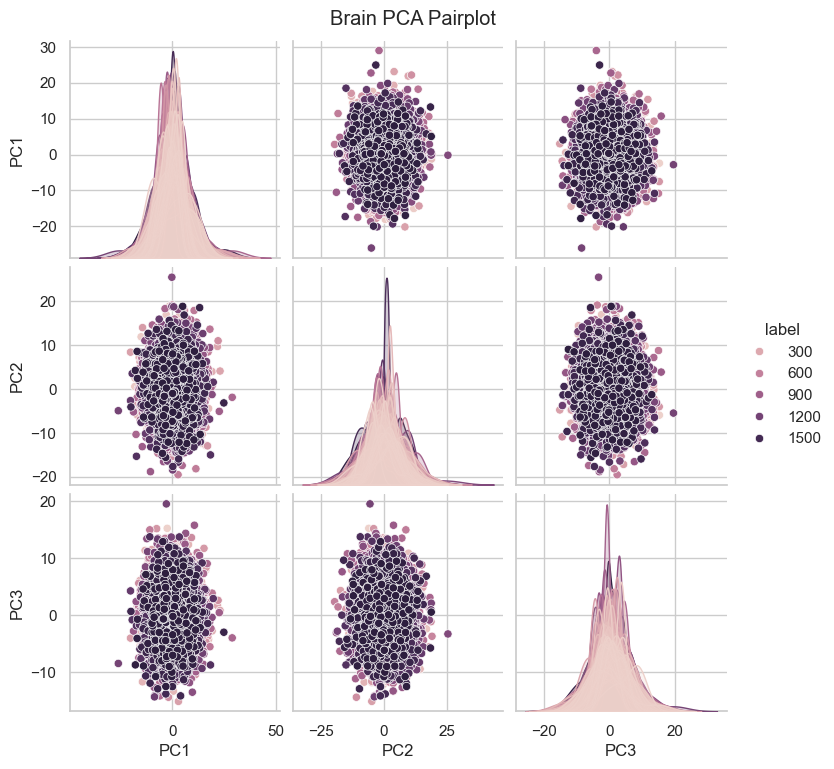

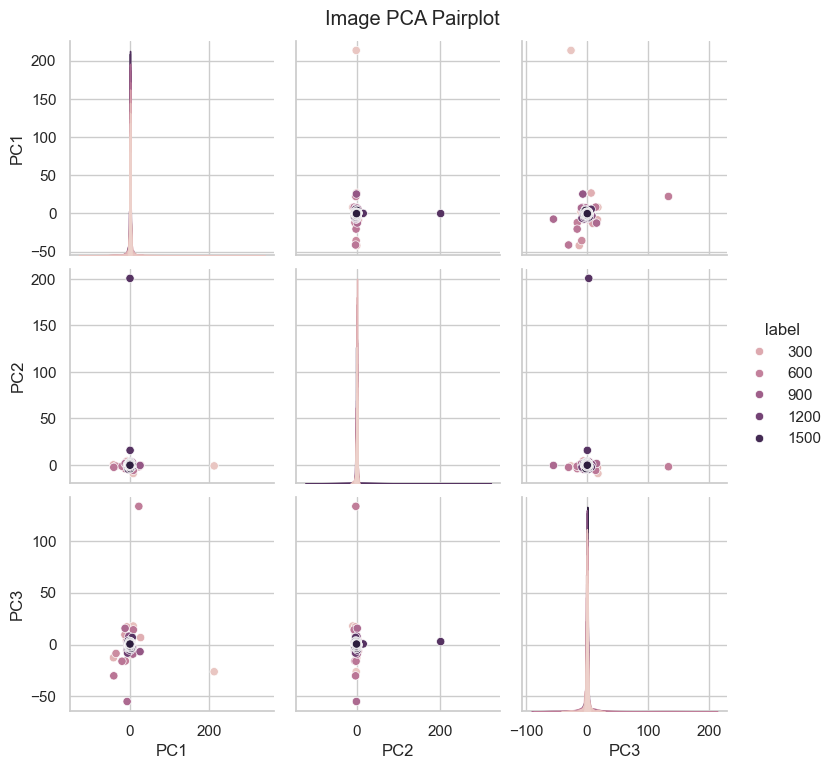

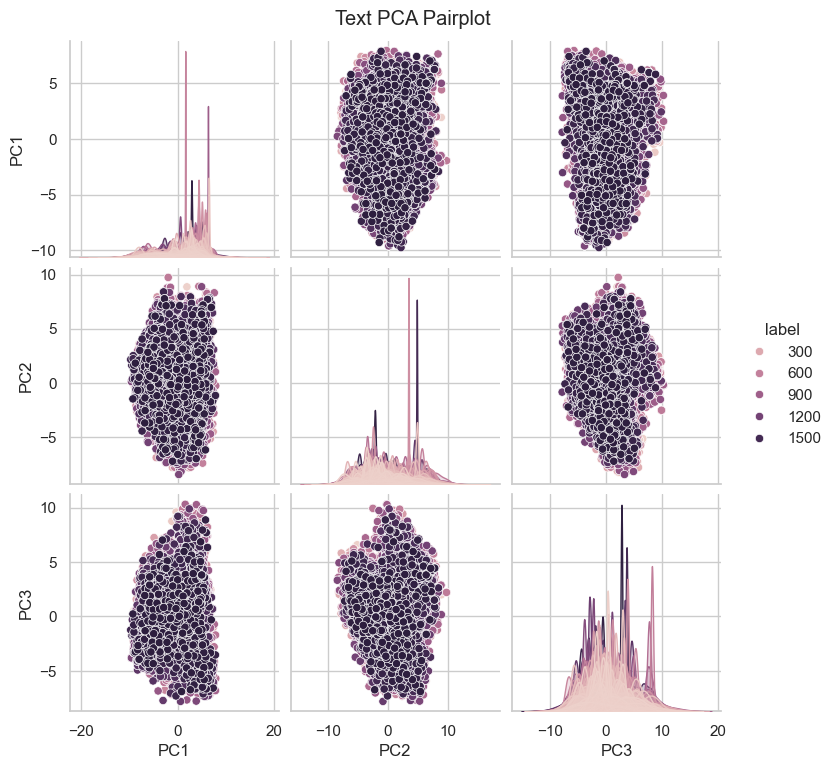

In [55]:
# Brain PCA pairplot
sns.pairplot(
    df_brain_pca,
    vars=['PC1', 'PC2', 'PC3'],
    hue='label', 
    diag_kind='kde'
)
plt.suptitle("Brain PCA Pairplot", y=1.02)
plt.show()

# Image PCA pairplot
sns.pairplot(
    df_image_pca,
    vars=['PC1', 'PC2', 'PC3'],
    hue='label',
    diag_kind='kde'
)
plt.suptitle("Image PCA Pairplot", y=1.02)
plt.show()

# Text PCA pairplot
sns.pairplot(
    df_text_pca,
    vars=['PC1', 'PC2', 'PC3'], 
    hue='label',
    diag_kind='kde'
)
plt.suptitle("Text PCA Pairplot", y=1.02)
plt.show()

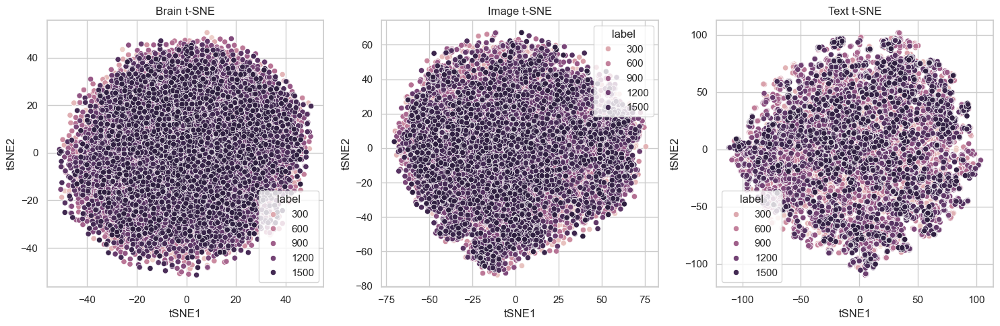

In [74]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Brain t-SNE
sns.scatterplot(
    data=df_brain_tsne,
    x='tSNE1', y='tSNE2',
    hue='label',  # or 'modality'
    ax=axes[0]
)
axes[0].set_title('Brain t-SNE')

# Image t-SNE
sns.scatterplot(
    data=df_image_tsne,
    x='tSNE1', y='tSNE2',
    hue='label',
    ax=axes[1]
)
axes[1].set_title('Image t-SNE')

# Text t-SNE
sns.scatterplot(
    data=df_text_tsne,
    x='tSNE1', y='tSNE2',
    hue='label',
    ax=axes[2]
)
axes[2].set_title('Text t-SNE')

plt.tight_layout()
plt.show()

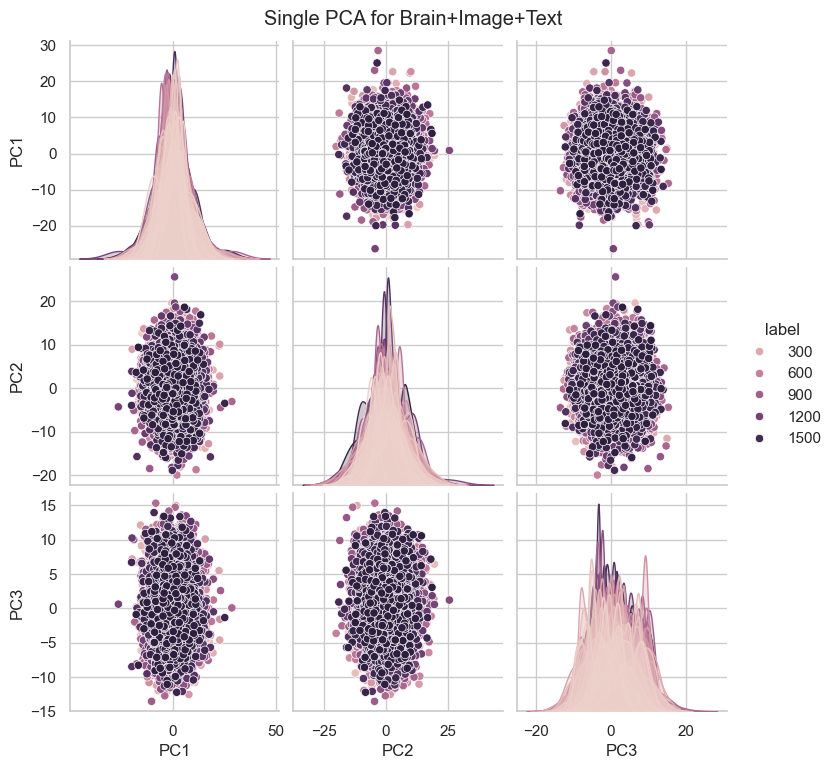

In [57]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt

# -------------------
# 1) Combine your data (brain, image, text) if each row is the same sample
# -------------------
df_combined = pd.concat(
    [df_brain_seen, df_image_seen, df_text_seen],
    axis=1
)  
# Now df_combined has all features from the 3 modalities side by side.

# -------------------
# 2) Scale the combined data
# -------------------
scaler = RobustScaler()
X_scaled = scaler.fit_transform(df_combined.values)

# -------------------
# 3) Single PCA on the combined data
# -------------------
pca = PCA(n_components=3)  # choose however many components you want
X_pca = pca.fit_transform(X_scaled)

# -------------------
# 4) Create a DataFrame for plotting
# -------------------
df_pca = pd.DataFrame(X_pca, columns=['PC1','PC2','PC3'])

# If you have labels for each row:
df_pca['label'] = df_label_seen['label'].values  # adjust if your label is stored differently

# -------------------
# 5) Pairplot
# -------------------
sns.set(style='whitegrid', context='notebook')
pairplot_fig = sns.pairplot(
    df_pca,
    vars=['PC1','PC2','PC3'],
    hue='label',            # color by your label or by modality if you have a label for that
    diag_kind='kde'
)

pairplot_fig.fig.suptitle("Single PCA for Brain+Image+Text", y=1.02)
plt.show()

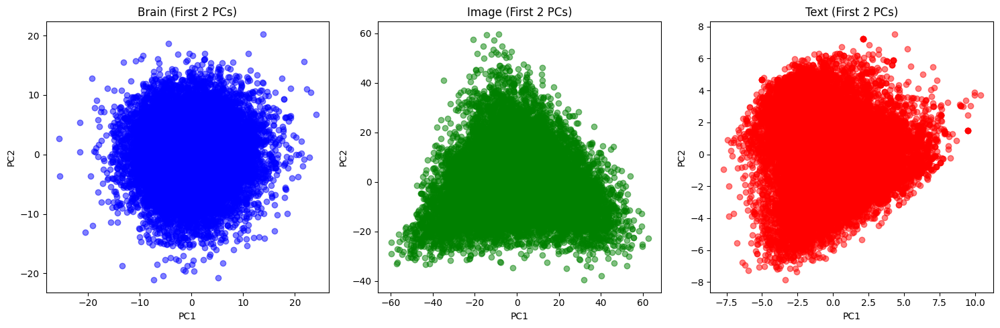

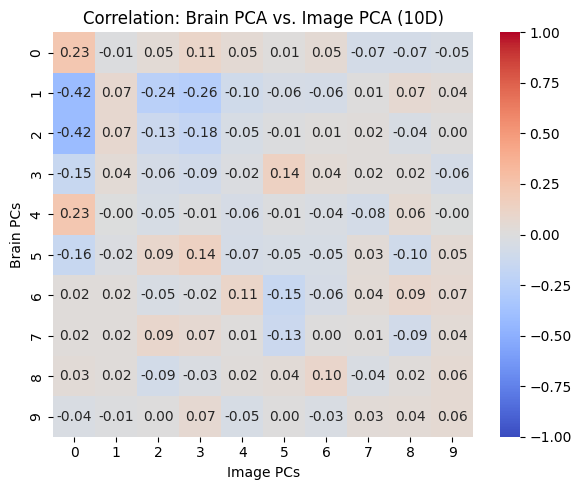

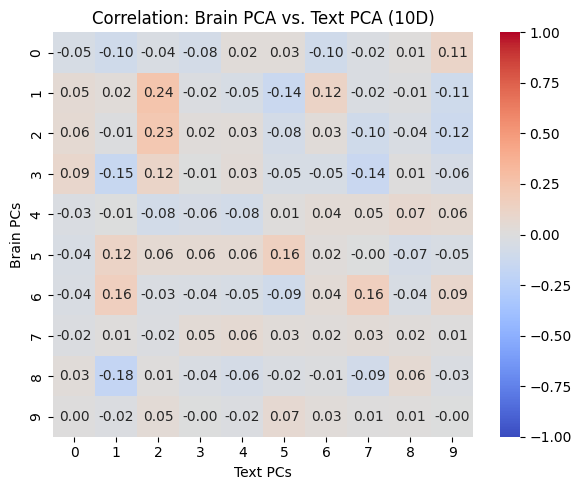

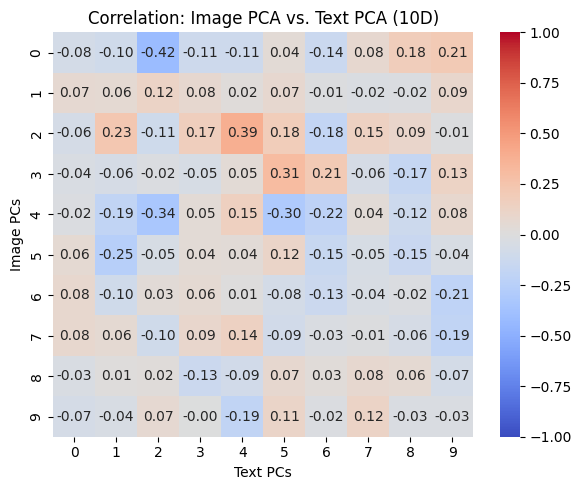

In [38]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

#----------------------------------------------------------------#
# 1. Specify your columns and load the data
#----------------------------------------------------------------#
# Convert the relevant DataFrame slices to NumPy arrays
brain_data = df_brain_seen.values  # shape: (N, number of brain features)
image_data = df_image_seen.values  # shape: (N, number of image features)
text_data  = df_text_seen.values   # shape: (N, number of text features)

#----------------------------------------------------------------#
# 2. PCA to reduce dimensionality of each modality (e.g., to 10D)
#----------------------------------------------------------------#
pca_dim = 10  # choose how many principal components you want
pca_brain = PCA(n_components=pca_dim).fit_transform(brain_data)
pca_image = PCA(n_components=pca_dim).fit_transform(image_data)
pca_text  = PCA(n_components=pca_dim).fit_transform(text_data)

# pca_brain, pca_image, pca_text now have shapes (N, 10) each

#----------------------------------------------------------------#
# 3. Scatter plot of first two principal components (PCs)
#    This gives a quick 2D view of each modality.
#----------------------------------------------------------------#
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].scatter(pca_brain[:, 0], pca_brain[:, 1], alpha=0.5, color='blue')
axes[0].set_title("Brain (First 2 PCs)")
axes[0].set_xlabel("PC1")
axes[0].set_ylabel("PC2")

axes[1].scatter(pca_image[:, 0], pca_image[:, 1], alpha=0.5, color='green')
axes[1].set_title("Image (First 2 PCs)")
axes[1].set_xlabel("PC1")
axes[1].set_ylabel("PC2")

axes[2].scatter(pca_text[:, 0], pca_text[:, 1], alpha=0.5, color='red')
axes[2].set_title("Text (First 2 PCs)")
axes[2].set_xlabel("PC1")
axes[2].set_ylabel("PC2")

plt.tight_layout()
plt.show()

#----------------------------------------------------------------#
# 4. Correlation heatmaps between modalities in the 10D PCA space
#    We'll compare:
#    A) Brain vs Image
#    B) Brain vs Text
#    C) Image vs Text
#----------------------------------------------------------------#

# Helper function to compute cross-correlation matrix
def cross_corr(X, Y):
    """
    Compute correlation matrix between each column in X and each column in Y.
    X: (N, dX)
    Y: (N, dY)
    Returns: (dX, dY) correlation matrix
    """
    # Concatenate to do a single correlation
    # We do row-wise (features as columns), so we transpose:
    combined = np.corrcoef(X.T, Y.T)  
    dX = X.shape[1]
    dY = Y.shape[1]
    # The cross block is top-left or bottom-right depending on arrangement.
    # In this arrangement, the top-left block is X-X, the bottom-right is Y-Y.
    # We want the off-diagonal block: [0:dX, dX : dX+dY]
    cross = combined[0:dX, dX:dX+dY]
    return cross

# A) Brain vs. Image
corr_bi = cross_corr(pca_brain, pca_image)

plt.figure(figsize=(6, 5))
sns.heatmap(corr_bi, vmin=-1, vmax=1, cmap="coolwarm", annot=True, fmt=".2f")
plt.title("Correlation: Brain PCA vs. Image PCA (10D)")
plt.xlabel("Image PCs")
plt.ylabel("Brain PCs")
plt.tight_layout()
plt.show()

# B) Brain vs. Text
corr_bt = cross_corr(pca_brain, pca_text)

plt.figure(figsize=(6, 5))
sns.heatmap(corr_bt, vmin=-1, vmax=1, cmap="coolwarm", annot=True, fmt=".2f")
plt.title("Correlation: Brain PCA vs. Text PCA (10D)")
plt.xlabel("Text PCs")
plt.ylabel("Brain PCs")
plt.tight_layout()
plt.show()

# C) Image vs. Text
corr_it = cross_corr(pca_image, pca_text)

plt.figure(figsize=(6, 5))
sns.heatmap(corr_it, vmin=-1, vmax=1, cmap="coolwarm", annot=True, fmt=".2f")
plt.title("Correlation: Image PCA vs. Text PCA (10D)")
plt.xlabel("Text PCs")
plt.ylabel("Image PCs")
plt.tight_layout()
plt.show()

## data preparation


# model

## model perepration

because the values varry alot and i want to keep them lik ehat i wil use a model wich is more robust to un even data which is a random forrest classifier 

In [141]:
import numpy as np
#Use 50 categories
#index_seen = np.squeeze(np.where(label_seen < 51, True, False))
# index_unseen = np.squeeze(np.where(label_unseen < 51, True, False))

#Use 20 categories
index_seen = np.squeeze(np.where(label_seen < 21, True, False))
index_unseen = np.squeeze(np.where(label_unseen < 21, True, False))

brain_seen = brain_seen[index_seen, :]
image_seen = image_seen[index_seen, :]
text_seen = text_seen[index_seen, :]
label_seen = label_seen[index_seen]
brain_unseen = brain_unseen[index_unseen, :]
image_unseen = image_unseen[index_unseen, :]
text_unseen = text_unseen[index_unseen, :]
label_unseen = label_unseen[index_unseen]

#The ThingsEEG-Text dataset is mainly designed and used for Zero-Shot type research work, because the independence of its training set and test set
#in categories is very suitable for this task. If it needs to be used for other types of tasks
#(such as general classification or cross-modal learning),
#the data may need to be repartitioned. Therefore, we repartition the dataset to make it better for our task
#Define the number of classes and the number of samples per class
num_classes = 20
samples_per_class = 10
#For each class, take the first 5 images as training and the last 5 images as testing
new_train_brain = []
new_train_image = []
new_train_text = []
new_train_label = []

new_test_brain = []
new_test_image = []
new_test_text = []
new_test_label = []

for i in range(num_classes):
    start_idx = i * samples_per_class#The starting index of the current class
    end_idx = start_idx + samples_per_class#The end index of the current class
    #Get the data of the current class
    class_data_brain = brain_seen[start_idx:end_idx, :]
    #Divided into training set and test set
    new_train_brain.append(class_data_brain[:7])
    new_test_brain.append(class_data_brain[7:])

    class_data_image = image_seen[start_idx:end_idx, :]

    new_train_image.append(class_data_image[:7])
    new_test_image.append(class_data_image[7:])

    class_data_text = text_seen[start_idx:end_idx, :]

    new_train_text.append(class_data_text[:7])
    new_test_text.append(class_data_text[7:])

    class_data_label = label_seen[start_idx:end_idx, :]

    new_train_label.append(class_data_label[:7])
    new_test_label.append(class_data_label[7:])

train_brain = torch.vstack(new_train_brain)
train_image = torch.vstack(new_train_image)
train_text = torch.vstack(new_train_text)
train_label = torch.vstack(new_train_label)
test_brain = torch.vstack(new_test_brain)
test_image = torch.vstack(new_test_image)
test_text = torch.vstack(new_test_text)
test_label = torch.vstack(new_test_label)

print(train_brain.shape)
print(train_image.shape)
print(train_text.shape)
print(train_label.shape)
print(test_brain.shape)
print(test_image.shape)
print(test_text.shape)
print(test_label.shape)

torch.Size([140, 561])
torch.Size([140, 100])
torch.Size([140, 512])
torch.Size([140, 1])
torch.Size([60, 561])
torch.Size([60, 100])
torch.Size([60, 512])
torch.Size([60, 1])


In [ ]:
import torch
import numpy as np

# Convert torch tensors to numpy arrays
train_brain_np = train_brain.numpy()
train_label_np = train_label.numpy().ravel()

test_brain_np = test_brain.numpy()
test_label_np = test_label.numpy().ravel()

# Use only brain features
train_features = train_brain_np
test_features = test_brain_np

# Verify the number of classes
num_classes = 20
classes = np.unique(train_label_np)
print(f"Number of classes in training data: {len(classes)}")

In [ ]:
def rbf_kernel(X1, X2, gamma):
    """
    Compute the RBF (Gaussian) kernel between two matrices.

    Args:
        X1: numpy array of shape (n_samples_1, n_features)
        X2: numpy array of shape (n_samples_2, n_features)
        gamma: float, kernel coefficient

    Returns:
        Kernel matrix of shape (n_samples_1, n_samples_2)
    """
    if len(X1.shape) == 1:
        X1 = X1[:, np.newaxis]
    if len(X2.shape) == 1:
        X2 = X2[:, np.newaxis]

    sq_dists = np.sum(X1**2, axis=1).reshape(-1, 1) + \
               np.sum(X2**2, axis=1) - 2 * np.dot(X1, X2.T)
    return np.exp(-gamma * sq_dists)

In [ ]:
from cvxopt import matrix, solvers

def svm_train_rbf(X, y, C=1.0, gamma=None):
    """
    Train a binary SVM classifier with RBF kernel using cvxopt.

    Args:
        X: numpy array of shape (n_samples, n_features)
        y: numpy array of shape (n_samples,), labels {-1, 1}
        C: float, regularization parameter
        gamma: float, kernel coefficient. If None, set to 1 / n_features

    Returns:
        A dictionary containing support vectors, coefficients, bias, and other parameters
    """
    n_samples, n_features = X.shape

    if gamma is None:
        gamma = 1.0 / n_features

    # Compute the kernel matrix
    K = rbf_kernel(X, X, gamma)

    # Set up parameters for cvxopt
    P = matrix(np.outer(y, y) * K)
    q = matrix(-np.ones(n_samples))

    # Equality constraints
    A = matrix(y, (1, n_samples), 'd')
    b = matrix(0.0)

    # Inequality constraints
    G_std = np.diag(-np.ones(n_samples))
    h_std = np.zeros(n_samples)

    G_slack = np.diag(np.ones(n_samples))
    h_slack = C * np.ones(n_samples)

    G = matrix(np.vstack((G_std, G_slack)))
    h = matrix(np.hstack((h_std, h_slack)))

    # Solve QP problem
    solvers.options['show_progress'] = False
    solution = solvers.qp(P, q, G, h, A, b)

    alphas = np.ravel(solution['x'])

    # Support vectors have non-zero lagrange multipliers
    sv = alphas > 1e-5
    ind = np.arange(len(alphas))[sv]
    alphas = alphas[sv]
    sv_X = X[sv]
    sv_y = y[sv]
    print(f"Number of support vectors: {len(alphas)}")

    # Compute bias
    # b = y_k - sum_i(alpha_i y_i K(x_i, x_k)) for any support vector x_k
    b = 0
    for n in range(len(alphas)):
        b += sv_y[n]
        b -= np.sum(alphas * sv_y * K[ind[n], sv])
    b /= len(alphas)

    model = {
        'alphas': alphas,
        'sv_X': sv_X,
        'sv_y': sv_y,
        'b': b,
        'gamma': gamma
    }

    return model

In [ ]:
def svm_predict_rbf(model, X):
    """
    Predict labels for given data using the trained binary SVM model.

    Args:
        model: dictionary containing SVM model parameters
        X: numpy array of shape (n_samples, n_features)

    Returns:
        Predicted labels {-1, 1}
    """
    alphas = model['alphas']
    sv_X = model['sv_X']
    sv_y = model['sv_y']
    b = model['b']
    gamma = model['gamma']

    K = rbf_kernel(X, sv_X, gamma)
    decision = np.dot(K, alphas * sv_y) + b
    return np.sign(decision)

In [ ]:
from collections import defaultdict

def train_ovr_svm(X, y, C=1.0, gamma=None):
    """
    Train multi-class SVM classifiers using One-vs-Rest strategy.

    Args:
        X: numpy array of shape (n_samples, n_features)
        y: numpy array of shape (n_samples,), labels {1, 2, ..., 20}
        C: float, regularization parameter
        gamma: float, kernel coefficient. If None, set to 1 / n_features

    Returns:
        A dictionary containing models for each class
    """
    classes = np.unique(y)
    models = {}
    for cls in classes:
        print(f"Training classifier for class {cls} vs Rest")
        # Create binary labels for current class vs rest
        binary_y = np.where(y == cls, 1, -1)
        model = svm_train_rbf(X, binary_y, C=C, gamma=gamma)
        models[cls] = model
    return models

def predict_ovr_svm(models, X):
    """
    Predict class labels using One-vs-Rest strategy.

    Args:
        models: dictionary containing SVM models for each class
        X: numpy array of shape (n_samples, n_features)

    Returns:
        Predicted labels {1, 2, ..., 20}
    """
    classes = list(models.keys())
    n_samples = X.shape[0]
    decision_values = np.zeros((n_samples, len(classes)))

    for idx, cls in enumerate(classes):
        model = models[cls]
        alphas = model['alphas']
        sv_X = model['sv_X']
        sv_y = model['sv_y']
        b = model['b']
        gamma = model['gamma']

        K = rbf_kernel(X, sv_X, gamma)
        decision = np.dot(K, alphas * sv_y) + b
        decision_values[:, idx] = decision

    # Assign the class with the highest decision value
    predictions = np.argmax(decision_values, axis=1) + 1  # Assuming classes start at 1
    return predictions

In [ ]:
# 1. Data Preparation (continued)
# Ensure that labels are from 1 to 20
assert len(classes) == 20, "There should be 20 classes in the training data."

# 2. Define hyperparameters
C = 1.0
gamma = 1.0 / train_features.shape[1]  # You can adjust gamma as needed

# 3. Train multi-class SVM using OvR
models = train_ovr_svm(train_features, train_label_np, C=C, gamma=gamma)

# 4. Predict on test data
predictions = predict_ovr_svm(models, test_features)

# 5. Calculate accuracy
accuracy = np.mean(predictions == test_label_np)
print(f"Test Accuracy: {accuracy * 100:.2f}%")

In [144]:
%pip install cvxopt

import torch
import numpy as np
from cvxopt import matrix, solvers
from collections import defaultdict
from sklearn.metrics import classification_report
import time
from sklearn.model_selection import KFold

# 1. Data Preparation
# Assuming train_brain, train_label, test_brain, test_label are already defined as per your initial code

# Convert torch tensors to numpy arrays
train_brain_np = train_brain.numpy()
train_label_np = train_label.numpy().ravel()

test_brain_np = test_brain.numpy()
test_label_np = test_label.numpy().ravel()

# Use only brain features
train_features = train_brain_np
test_features = test_brain_np

# Verify the number of classes
classes = np.unique(train_label_np)
num_classes = len(classes)
print(f"Number of classes in training data: {num_classes}")
assert num_classes == 20, "There should be 20 classes in the training data."

# 2. Kernel Computation
def rbf_kernel(X1, X2, gamma):
    if len(X1.shape) == 1:
        X1 = X1[:, np.newaxis]
    if len(X2.shape) == 1:
        X2 = X2[:, np.newaxis]
    sq_dists = np.sum(X1**2, axis=1).reshape(-1, 1) + \
               np.sum(X2**2, axis=1) - 2 * np.dot(X1, X2.T)
    return np.exp(-gamma * sq_dists)

# 3. Binary SVM Training
def svm_train_rbf(X, y, C=1.0, gamma=None):
    n_samples, n_features = X.shape

    if gamma is None:
        gamma = 1.0 / n_features

    # Compute the kernel matrix
    K = rbf_kernel(X, X, gamma)

    # Set up parameters for cvxopt
    P = matrix(np.outer(y, y) * K)
    q = matrix(-np.ones(n_samples))

    # Equality constraints
    A = matrix(y, (1, n_samples), 'd')
    b = matrix(0.0)

    # Inequality constraints
    G_std = np.diag(-np.ones(n_samples))
    h_std = np.zeros(n_samples)

    G_slack = np.diag(np.ones(n_samples))
    h_slack = C * np.ones(n_samples)

    G = matrix(np.vstack((G_std, G_slack)))
    h = matrix(np.hstack((h_std, h_slack)))

    # Solve QP problem
    solvers.options['show_progress'] = False
    solution = solvers.qp(P, q, G, h, A, b)

    alphas = np.ravel(solution['x'])

    # Support vectors have non-zero lagrange multipliers
    sv = alphas > 1e-5
    ind = np.arange(len(alphas))[sv]
    alphas = alphas[sv]
    sv_X = X[sv]
    sv_y = y[sv]
    print(f"    Number of support vectors: {len(alphas)}")

    # Compute bias
    b = 0
    for n in range(len(alphas)):
        b += sv_y[n]
        b -= np.sum(alphas * sv_y * K[ind[n], sv])
    b /= len(alphas)

    model = {
        'alphas': alphas,
        'sv_X': sv_X,
        'sv_y': sv_y,
        'b': b,
        'gamma': gamma
    }

    return model

# 4. Prediction Function
def svm_predict_rbf(model, X):
    alphas = model['alphas']
    sv_X = model['sv_X']
    sv_y = model['sv_y']
    b = model['b']
    gamma = model['gamma']

    K = rbf_kernel(X, sv_X, gamma)
    decision = np.dot(K, alphas * sv_y) + b
    return np.sign(decision)

# 5. One-vs-Rest Training
def train_ovr_svm(X, y, C=1.0, gamma=None):
    classes = np.unique(y)
    models = {}
    for cls in classes:
        print(f"  Training classifier for class {cls} vs Rest")
        # Create binary labels for current class vs rest
        binary_y = np.where(y == cls, 1, -1)
        model = svm_train_rbf(X, binary_y, C=C, gamma=gamma)
        models[cls] = model
    return models

# 6. One-vs-Rest Prediction
def predict_ovr_svm(models, X):
    classes = list(models.keys())
    n_samples = X.shape[0]
    decision_values = np.zeros((n_samples, len(classes)))

    for idx, cls in enumerate(classes):
        model = models[cls]
        alphas = model['alphas']
        sv_X = model['sv_X']
        sv_y = model['sv_y']
        b = model['b']
        gamma = model['gamma']

        K = rbf_kernel(X, sv_X, gamma)
        decision = np.dot(K, alphas * sv_y) + b
        decision_values[:, idx] = decision

    # Assign the class with the highest decision value
    predictions = np.argmax(decision_values, axis=1) + 1  # Assuming classes start at 1
    return predictions

# 7. k-Fold Indices Generator
def get_kfold_indices(X, y, k=5, random_state=None):
    kf = KFold(n_splits=k, shuffle=True, random_state=random_state)
    indices = []
    for train_index, val_index in kf.split(X):
        indices.append((train_index, val_index))
    return indices

# 8. Grid Search Implementation
def grid_search_svm_ovr(X, y, C_values, gamma_values, k=5, random_state=None):
    # Generate k-fold indices
    kfold_indices = get_kfold_indices(X, y, k=k, random_state=random_state)
    
    # Initialize performance dictionary
    performance = defaultdict(float)
    
    total_combinations = len(C_values) * len(gamma_values)
    combination_count = 0
    
    # Iterate over all combinations of C and gamma
    for C in C_values:
        for gamma in gamma_values:
            combination_count += 1
            print(f"Evaluating combination {combination_count}/{total_combinations}: C={C}, gamma={gamma}")
            accuracies = []
            start_time = time.time()
            
            # Perform k-fold cross-validation
            for fold, (train_idx, val_idx) in enumerate(kfold_indices):
                print(f"  Fold {fold+1}/{k}")
                
                X_train, y_train = X[train_idx], y[train_idx]
                X_val, y_val = X[val_idx], y[val_idx]
                
                # Train OvR SVM with current C and gamma
                models = train_ovr_svm(X_train, y_train, C=C, gamma=gamma)
                
                # Predict on validation set
                predictions = predict_ovr_svm(models, X_val)
                
                # Calculate accuracy
                accuracy = np.mean(predictions == y_val)
                accuracies.append(accuracy)
                print(f"    Fold {fold+1} Accuracy: {accuracy * 100:.2f}%")
            
            # Compute average accuracy for current combination
            avg_accuracy = np.mean(accuracies)
            performance[(C, gamma)] = avg_accuracy
            elapsed_time = time.time() - start_time
            print(f"  Average Accuracy for C={C}, gamma={gamma}: {avg_accuracy * 100:.2f}% (Time: {elapsed_time:.2f}s)\n")
    
    # Find the best hyperparameters
    best_params = max(performance, key=performance.get)
    best_C, best_gamma = best_params
    best_accuracy = performance[best_params]
    print(f"Best Hyperparameters: C={best_C}, gamma={best_gamma} with Accuracy={best_accuracy * 100:.2f}%")
    
    return best_params, performance

# 9. Execute Grid Search
# Define hyperparameter grid
C_values = [0.1, 1, 10]           # Regularization parameter
gamma_values = [0.001, 0.01, 0.1] # Kernel coefficient

# Perform grid search with 5-fold cross-validation
best_params, performance = grid_search_svm_ovr(
    X=train_features,
    y=train_label_np,
    C_values=C_values,
    gamma_values=gamma_values,
    k=5,
    random_state=42
)

best_C, best_gamma = best_params

# 10. Train Final Model with Best Hyperparameters
print(f"Training final model with C={best_C}, gamma={best_gamma}")
final_models = train_ovr_svm(
    X=train_features,
    y=train_label_np,
    C=best_C,
    gamma=best_gamma
)

# 11. Evaluate on Test Set
print("Evaluating on test set...")
test_predictions = predict_ovr_svm(final_models, test_features)

# Calculate accuracy
test_accuracy = np.mean(test_predictions == test_label_np)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# 12. Classification Report
print("Classification Report:")
print(classification_report(test_label_np, test_predictions, digits=4))

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
104113.59s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Defaulting to user installation because normal site-packages is not writeable
  Using cached cvxopt-1.3.2-cp39-cp39-macosx_11_0_arm64.whl.metadata (1.3 kB)
Using cached cvxopt-1.3.2-cp39-cp39-macosx_11_0_arm64.whl (11.1 MB)
Note: you may need to restart the kernel to use updated packages.
Number of classes in training data: 20
Evaluating combination 1/9: C=0.1, gamma=0.001
  Fold 1/5
  Training classifier for class 1 vs Rest
    Number of support vectors: 41
  Training classifier for class 2 vs Rest
    Number of support vectors: 49
  Training classifier for class 3 vs Rest
    Number of support vectors: 54
  Training classifier for class 4 vs Rest
    Number of support vectors: 45
  Training classifier for class 5 vs Rest
    Number of support vectors: 43
  Training classifier for class 6 vs Rest
    Number of support vectors: 43
  Training classifier for class 7 vs Rest
    Number of support vectors: 63
  Training classifier for class 8 vs Rest
    Number of support vectors: 59
  Tra

/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(resu

In [ ]:
#########

In [158]:
import torch
import numpy as np
from cvxopt import matrix, solvers
from collections import defaultdict
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import GridSearchCV, StratifiedKFold, train_test_split, learning_curve
from sklearn.decomposition import PCA
from sklearn.svm import SVC
import matplotlib.pyplot as plt
import seaborn as sns
import time

# ----------------------------------------
# 1. Data Preparation
# ----------------------------------------

# Assuming train_brain, train_label, test_brain, test_label are already defined as per your initial code

# Convert torch tensors to numpy arrays
train_brain_np = train_brain.numpy()
train_label_np = train_label.numpy().ravel()

test_brain_np = test_brain.numpy()
test_label_np = test_label.numpy().ravel()

# Use only brain features
train_features = train_brain_np
test_features = test_brain_np

# Normalize the features
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
train_features = scaler.fit_transform(train_features)
test_features = scaler.transform(test_features)


# Verify the number of classes
classes = np.unique(train_label_np)
num_classes = len(classes)
print(f"Number of classes in training data: {num_classes}")
assert num_classes == 20, "There should be 20 classes in the training data."

# ----------------------------------------
# 2. Define the Hyperparameter Grid
# ----------------------------------------

C_values = [ 10,50,100]            # Regularization parameter
gamma_values = [0.0001, 0.001, 0.01] # Kernel coefficient

# ----------------------------------------
# 3. Define Stratified k-Fold cross-validator
# ----------------------------------------

k = 5  # Number of folds
skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

# ----------------------------------------
# 4. Time Measurement Functions
# ----------------------------------------

def measure_training_time(train_func, *args, **kwargs):
    start_time = time.time()
    model = train_func(*args, **kwargs)
    end_time = time.time()
    training_time = end_time - start_time
    return model, training_time

def measure_prediction_time(predict_func, model, X):
    start_time = time.time()
    predictions = predict_func(model, X)
    end_time = time.time()
    prediction_time = end_time - start_time
    return predictions, prediction_time

# ----------------------------------------
# 5. Custom SVM Functions
# ----------------------------------------

def rbf_kernel(X1, X2, gamma):
    if len(X1.shape) == 1:
        X1 = X1[:, np.newaxis]
    if len(X2.shape) == 1:
        X2 = X2[:, np.newaxis]
    sq_dists = np.sum(X1**2, axis=1).reshape(-1, 1) + \
               np.sum(X2**2, axis=1) - 2 * np.dot(X1, X2.T)
    return np.exp(-gamma * sq_dists)

def svm_train_rbf(X, y, C=1.0, gamma=None):
    n_samples, n_features = X.shape

    if gamma is None:
        gamma = 1.0 / n_features

    # Compute the kernel matrix
    K = rbf_kernel(X, X, gamma)

    # Set up parameters for cvxopt
    P = matrix(np.outer(y, y) * K)
    q = matrix(-np.ones(n_samples))

    # Equality constraints
    A = matrix(y, (1, n_samples), 'd')
    b = matrix(0.0)

    # Inequality constraints
    G_std = np.diag(-np.ones(n_samples))
    h_std = np.zeros(n_samples)

    G_slack = np.diag(np.ones(n_samples))
    h_slack = C * np.ones(n_samples)

    G = matrix(np.vstack((G_std, G_slack)))
    h = matrix(np.hstack((h_std, h_slack)))

    # Solve QP problem
    solvers.options['show_progress'] = False
    solution = solvers.qp(P, q, G, h, A, b)

    alphas = np.ravel(solution['x'])

    # Support vectors have non-zero lagrange multipliers
    sv = alphas > 1e-5
    ind = np.arange(len(alphas))[sv]
    alphas = alphas[sv]
    sv_X = X[sv]
    sv_y = y[sv]
    print(f"    Number of support vectors: {len(alphas)}")

    # Compute bias
    b = 0
    for n in range(len(alphas)):
        b += sv_y[n]
        b -= np.sum(alphas * sv_y * K[ind[n], sv])
    b /= len(alphas)

    model = {
        'alphas': alphas,
        'sv_X': sv_X,
        'sv_y': sv_y,
        'b': b,
        'gamma': gamma
    }

    return model

def svm_predict_rbf(model, X):
    alphas = model['alphas']
    sv_X = model['sv_X']
    sv_y = model['sv_y']
    b = model['b']
    gamma = model['gamma']

    K = rbf_kernel(X, sv_X, gamma)
    decision = np.dot(K, alphas * sv_y) + b
    return np.sign(decision)

def train_ovr_svm(X, y, C=1.0, gamma=None):
    classes = np.unique(y)
    models = {}
    for cls in classes:
        print(f"  Training classifier for class {cls} vs Rest")
        # Create binary labels for current class vs rest
        binary_y = np.where(y == cls, 1, -1)
        model = svm_train_rbf(X, binary_y, C=C, gamma=gamma)
        models[cls] = model
    return models

def predict_ovr_svm(models, X):
    classes = list(models.keys())
    n_samples = X.shape[0]
    decision_values = np.zeros((n_samples, len(classes)))

    for idx, cls in enumerate(classes):
        model = models[cls]
        alphas = model['alphas']
        sv_X = model['sv_X']
        sv_y = model['sv_y']
        b = model['b']
        gamma = model['gamma']

        K = rbf_kernel(X, sv_X, gamma)
        decision = np.dot(K, alphas * sv_y) + b
        decision_values[:, idx] = decision

    # Assign the class with the highest decision value
    predictions = np.argmax(decision_values, axis=1) + 1  # Assuming classes start at 1
    return predictions

# ----------------------------------------
# 6. Grid Search Implementation for Custom SVM
# ----------------------------------------

def get_kfold_indices(X, y, k=5, random_state=None):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=random_state)
    indices = []
    for train_index, val_index in skf.split(X, y):
        indices.append((train_index, val_index))
    return indices

def grid_search_svm_ovr(X, y, C_values, gamma_values, k=5, random_state=None):
    # Generate k-fold indices
    kfold_indices = get_kfold_indices(X, y, k=k, random_state=random_state)
    
    # Initialize performance dictionary
    performance = defaultdict(float)
    
    total_combinations = len(C_values) * len(gamma_values)
    combination_count = 0
    
    # Iterate over all combinations of C and gamma
    for C in C_values:
        for gamma in gamma_values:
            combination_count += 1
            print(f"Evaluating combination {combination_count}/{total_combinations}: C={C}, gamma={gamma}")
            accuracies = []
            start_time = time.time()
            
            # Perform k-fold cross-validation
            for fold, (train_idx, val_idx) in enumerate(kfold_indices):
                print(f"  Fold {fold+1}/{k}")
                
                X_train, y_train = X[train_idx], y[train_idx]
                X_val, y_val = X[val_idx], y[val_idx]
                
                # Train OvR SVM with current C and gamma
                models = train_ovr_svm(X_train, y_train, C=C, gamma=gamma)
                
                # Predict on validation set
                predictions = predict_ovr_svm(models, X_val)
                
                # Calculate accuracy
                accuracy = np.mean(predictions == y_val)
                accuracies.append(accuracy)
                print(f"    Fold {fold+1} Accuracy: {accuracy * 100:.2f}%")
            
            # Compute average accuracy for current combination
            avg_accuracy = np.mean(accuracies)
            performance[(C, gamma)] = avg_accuracy
            elapsed_time = time.time() - start_time
            print(f"  Average Accuracy for C={C}, gamma={gamma}: {avg_accuracy * 100:.2f}% (Time: {elapsed_time:.2f}s)\n")
    
    # Find the best hyperparameters
    best_params = max(performance, key=performance.get)
    best_C, best_gamma = best_params
    best_accuracy = performance[best_params]
    print(f"Best Hyperparameters: C={best_C}, gamma={best_gamma} with Accuracy={best_accuracy * 100:.2f}%")
    
    return best_params, performance

# ----------------------------------------
# 7. Plotting Functions
# ----------------------------------------

def plot_confusion_matrix(y_true, y_pred, title, classes, cmap=plt.cm.Blues):
    """
    Plot confusion matrix using seaborn heatmap.
    
    Args:
        y_true: True labels.
        y_pred: Predicted labels.
        title: Title of the plot.
        classes: List or array of class labels.
        cmap: Colormap.
    """
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap,
                xticklabels=classes, yticklabels=classes)
    plt.title(title, fontsize=16)
    plt.xlabel('Predicted Label', fontsize=14)
    plt.ylabel('True Label', fontsize=14)
    plt.show()

def plot_roc_curves_custom_svm(models, X, y, classes):
    """
    Plot ROC curves for Custom SVM using One-vs-Rest strategy.
    
    Args:
        models: Dictionary of trained models for each class.
        X: Feature matrix.
        y: True labels.
        classes: List or array of class labels.
    """
    # Binarize the output
    y_binary = label_binarize(y, classes=classes)
    n_classes = y_binary.shape[1]
    
    # Initialize arrays to hold decision scores
    decision_scores = np.zeros((X.shape[0], n_classes))
    
    # Collect decision scores for each class
    for idx, cls in enumerate(classes):
        model = models[cls]
        K = rbf_kernel(X, model['sv_X'], model['gamma'])
        decision = np.dot(K, model['alphas'] * model['sv_y']) + model['b']
        decision_scores[:, idx] = decision
    
    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_binary[:, i], decision_scores[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
    
    # Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_binary.ravel(), decision_scores.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
    
    # Compute macro-average ROC curve and ROC area
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    mean_tpr /= n_classes
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
    
    # Plot all ROC curves
    plt.figure(figsize=(10, 8))
    plt.plot(fpr["micro"], tpr["micro"],
             label=f'micro-average ROC curve (area = {roc_auc["micro"]:.2f})',
             color='deeppink', linestyle=':', linewidth=4)
    
    plt.plot(fpr["macro"], tpr["macro"],
             label=f'macro-average ROC curve (area = {roc_auc["macro"]:.2f})',
             color='navy', linestyle=':', linewidth=4)
    
    colors = plt.cm.get_cmap('tab20', n_classes)
    for i in range(n_classes):
        plt.plot(fpr[i], tpr[i], color=colors(i),
                 lw=2, label=f'ROC curve of class {classes[i]} (area = {roc_auc[i]:.2f})')
    
    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([-0.05, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=14)
    plt.ylabel('True Positive Rate', fontsize=14)
    plt.title('Receiver Operating Characteristic - Custom SVM', fontsize=16)
    plt.legend(loc="lower right", fontsize=8, ncol=2)
    plt.grid(True)
    plt.show()

def plot_roc_curves_sklearn_svm(estimator, X, y, classes):
    """
    Plot ROC curves for scikit-learn SVM using One-vs-Rest strategy.
    
    Args:
        estimator: Trained scikit-learn SVM model.
        X: Feature matrix.
        y: True labels.
        classes: List or array of class labels.
    """
    # Binarize the output
    y_binary = label_binarize(y, classes=classes)
    n_classes = y_binary.shape[1]
    
    # Get decision scores
    decision_scores = estimator.decision_function(X)
    
    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_binary[:, i], decision_scores[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
    
    # Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_binary.ravel(), decision_scores.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
    
    # Compute macro-average ROC curve and ROC area
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    mean_tpr /= n_classes
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
    
    # Plot all ROC curves
    plt.figure(figsize=(10, 8))
    plt.plot(fpr["micro"], tpr["micro"],
             label=f'micro-average ROC curve (area = {roc_auc["micro"]:.2f})',
             color='deeppink', linestyle=':', linewidth=4)
    
    plt.plot(fpr["macro"], tpr["macro"],
             label=f'macro-average ROC curve (area = {roc_auc["macro"]:.2f})',
             color='navy', linestyle=':', linewidth=4)
    
    colors = plt.cm.get_cmap('tab20', n_classes)
    for i in range(n_classes):
        plt.plot(fpr[i], tpr[i], color=colors(i),
                 lw=2, label=f'ROC curve of class {classes[i]} (area = {roc_auc[i]:.2f})')
    
    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([-0.05, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=14)
    plt.ylabel('True Positive Rate', fontsize=14)
    plt.title('Receiver Operating Characteristic - scikit-learn SVM', fontsize=16)
    plt.legend(loc="lower right", fontsize=8, ncol=2)
    plt.grid(True)
    plt.show()

def plot_confusion_matrix(y_true, y_pred, title, classes, cmap=plt.cm.Blues):
    """
    Plot confusion matrix using seaborn heatmap.
    
    Args:
        y_true: True labels.
        y_pred: Predicted labels.
        title: Title of the plot.
        classes: List or array of class labels.
        cmap: Colormap.
    """
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap,
                xticklabels=classes, yticklabels=classes)
    plt.title(title, fontsize=16)
    plt.xlabel('Predicted Label', fontsize=14)
    plt.ylabel('True Label', fontsize=14)
    plt.show()

def plot_pca_decision_boundaries_custom_svm(model, X, y, C, gamma, classes, title):
    """
    Plot PCA-based decision boundaries for the Custom SVM model.

    Args:
        model: Trained Custom SVM model.
        X: Feature matrix.
        y: True labels.
        C: Regularization parameter.
        gamma: Kernel coefficient.
        classes: List or array of class labels.
        title: Title of the plot.
    """
    # Reduce to 2D using PCA
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)

    # Create a mesh grid
    x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
    y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 300),
                         np.linspace(y_min, y_max, 300))

    # Project the grid back to original feature space
    grid_points_pca = np.c_[xx.ravel(), yy.ravel()]
    grid_points_original = pca.inverse_transform(grid_points_pca)

    # Predict on the grid
    Z = predict_ovr_svm(model, grid_points_original)
    Z = Z.reshape(xx.shape)

    # Plot contour and training examples
    plt.figure(figsize=(12, 10))
    plt.contourf(xx, yy, Z, alpha=0.3, cmap=plt.cm.rainbow)
    
    # Scatter plot of actual data points
    scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap=plt.cm.rainbow, edgecolor='k', s=20)
    
    plt.title(title, fontsize=16)
    plt.xlabel('Principal Component 1', fontsize=14)
    plt.ylabel('Principal Component 2', fontsize=14)
    
    # Convert classes to strings if they aren't already
    if isinstance(classes, np.ndarray):
        classes = classes.astype(str)
    else:
        classes = list(map(str, classes))
    
    # Extract handles and associate with class labels
    handles, _ = scatter.legend_elements()
    plt.legend(handles, classes, title="Classes",
               bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
    plt.show()

def plot_pca_decision_boundaries_sklearn_svm(estimator, X, y, classes, title):
    """
    Plot PCA-based decision boundaries for scikit-learn SVM.

    Args:
        estimator: Trained scikit-learn SVM model.
        X: Feature matrix.
        y: True labels.
        classes: List or array of class labels.
        title: Title of the plot.
    """
    # Reduce to 2D using PCA
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)

    # Create a mesh grid
    x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
    y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 300),
                         np.linspace(y_min, y_max, 300))

    # Project the grid back to original feature space
    grid_points_pca = np.c_[xx.ravel(), yy.ravel()]
    grid_points_original = pca.inverse_transform(grid_points_pca)

    # Predict on the grid
    Z = estimator.predict(grid_points_original)
    Z = Z.reshape(xx.shape)

    # Plot contour and training examples
    plt.figure(figsize=(12, 10))
    plt.contourf(xx, yy, Z, alpha=0.3, cmap=plt.cm.rainbow)
    
    # Scatter plot of actual data points
    scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap=plt.cm.rainbow, edgecolor='k', s=20)
    
    plt.title(title, fontsize=16)
    plt.xlabel('Principal Component 1', fontsize=14)
    plt.ylabel('Principal Component 2', fontsize=14)
    
    # Convert classes to strings if they aren't already
    if isinstance(classes, np.ndarray):
        classes = classes.astype(str)
    else:
        classes = list(map(str, classes))
    
    # Extract handles and associate with class labels
    handles, _ = scatter.legend_elements()
    plt.legend(handles, classes, title="Classes",
               bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
    plt.show()

Number of classes in training data: 20


Starting Grid Search for Custom SVM...
Evaluating combination 1/9: C=10, gamma=0.0001
  Fold 1/5
  Training classifier for class 1 vs Rest
    Number of support vectors: 31
  Training classifier for class 2 vs Rest
    Number of support vectors: 40
  Training classifier for class 3 vs Rest
    Number of support vectors: 40
  Training classifier for class 4 vs Rest
    Number of support vectors: 43
  Training classifier for class 5 vs Rest
    Number of support vectors: 45
  Training classifier for class 6 vs Rest
    Number of support vectors: 41
  Training classifier for class 7 vs Rest
    Number of support vectors: 49
  Training classifier for class 8 vs Rest
    Number of support vectors: 33
  Training classifier for class 9 vs Rest
    Number of support vectors: 37
  Training classifier for class 10 vs Rest
    Number of support vectors: 45
  Training classifier for class 11 vs Rest
    Number of support vectors: 48
  Training classifier for class 12 vs Rest
    Number of support 

/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_1014/2961614486.py:332: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', n_classes)


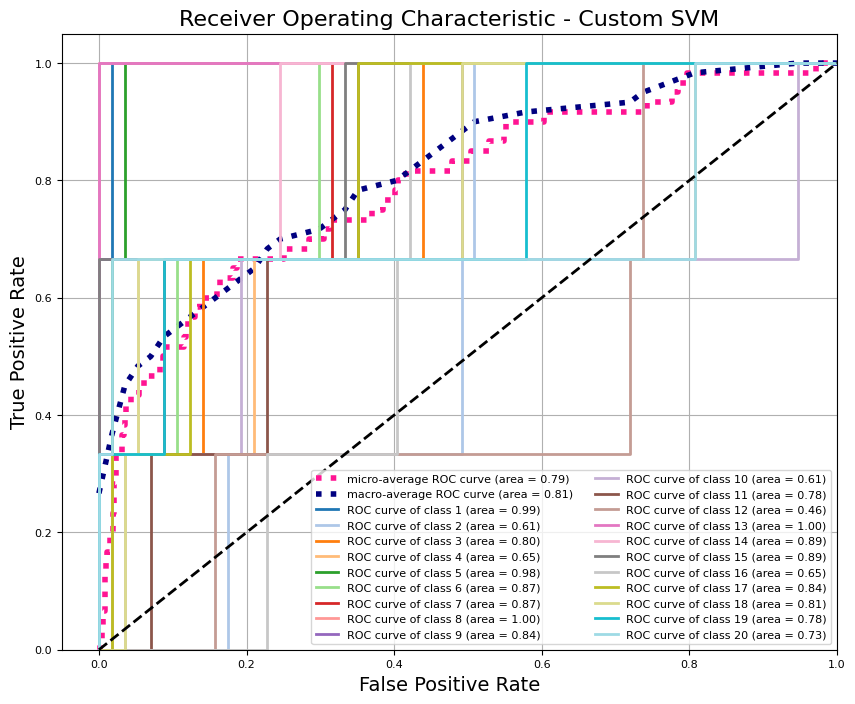

/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_1014/2961614486.py:396: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', n_classes)


Generating ROC Curves for scikit-learn SVM...


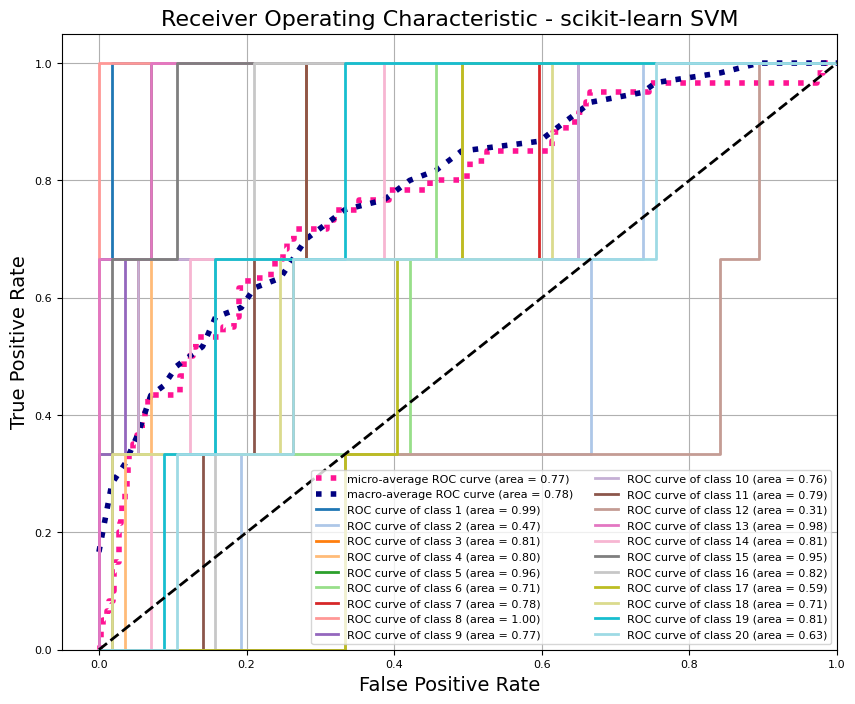


Plotting Confusion Matrix for Custom SVM...


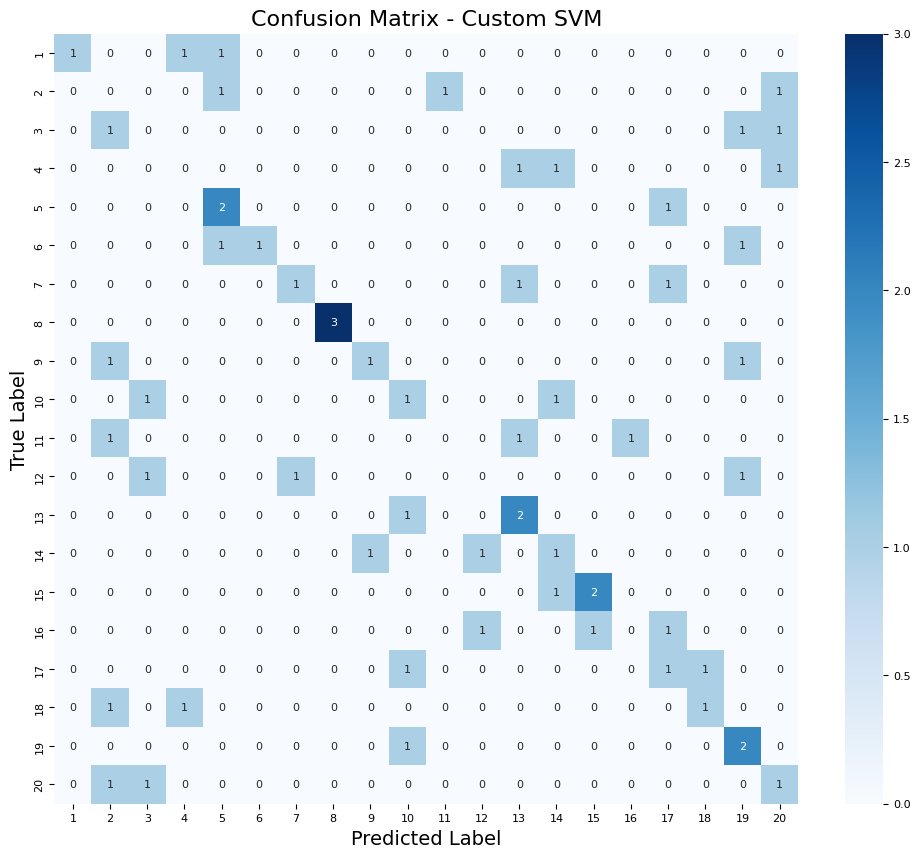

Plotting Confusion Matrix for scikit-learn SVM...


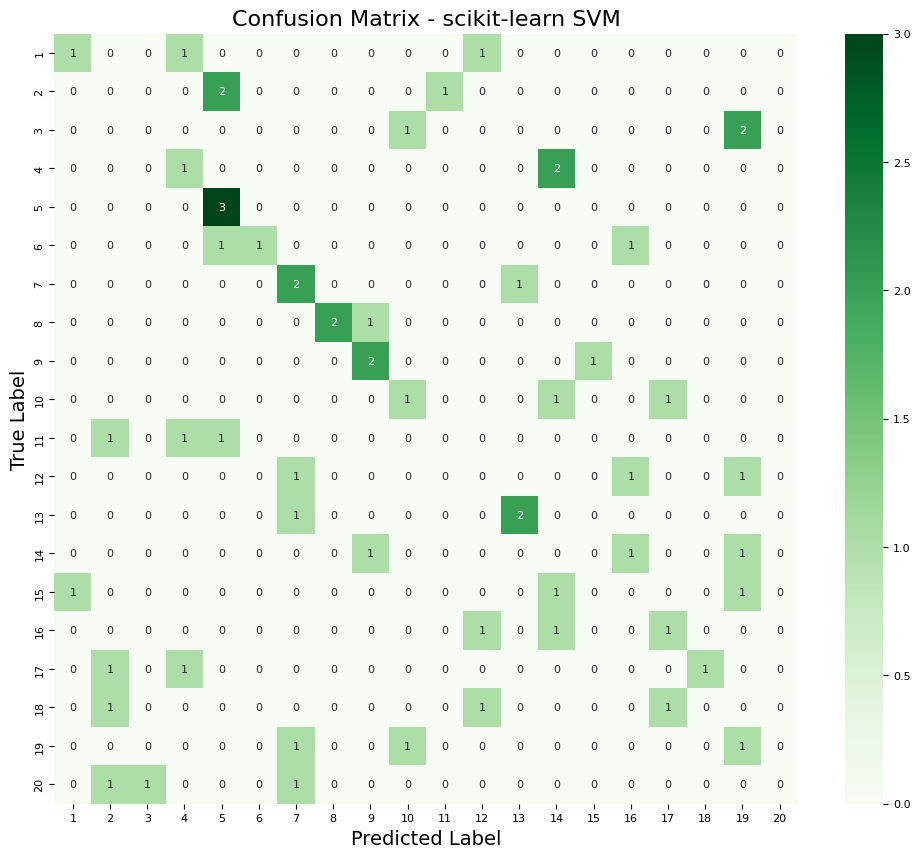


Plotting PCA Decision Boundaries for Custom SVM...


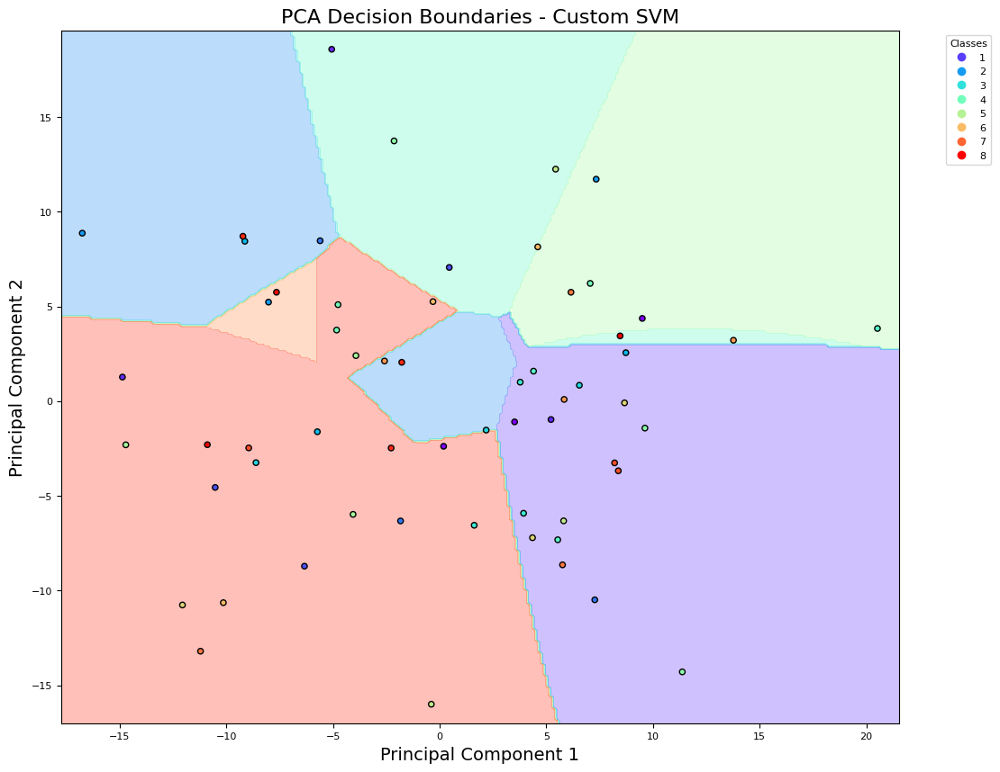

Plotting PCA Decision Boundaries for scikit-learn SVM...


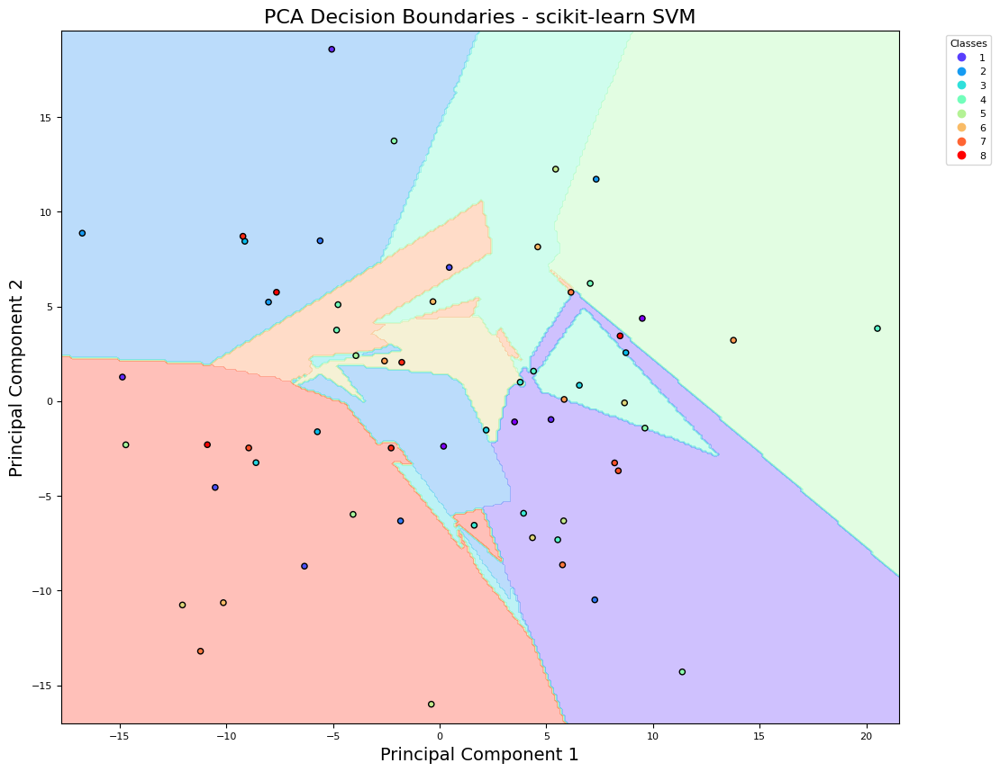


Classification Report for Custom SVM:
              precision    recall  f1-score   support

           1     1.0000    0.3333    0.5000         3
           2     0.0000    0.0000    0.0000         3
           3     0.0000    0.0000    0.0000         3
           4     0.0000    0.0000    0.0000         3
           5     0.4000    0.6667    0.5000         3
           6     1.0000    0.3333    0.5000         3
           7     0.5000    0.3333    0.4000         3
           8     1.0000    1.0000    1.0000         3
           9     0.5000    0.3333    0.4000         3
          10     0.2500    0.3333    0.2857         3
          11     0.0000    0.0000    0.0000         3
          12     0.0000    0.0000    0.0000         3
          13     0.4000    0.6667    0.5000         3
          14     0.2500    0.3333    0.2857         3
          15     0.6667    0.6667    0.6667         3
          16     0.0000    0.0000    0.0000         3
          17     0.2500    0.3333    0.285

/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(resu

In [159]:
# ----------------------------------------
# 7. Grid Search for Custom SVM
# ----------------------------------------

print("Starting Grid Search for Custom SVM...")
best_params_custom, performance_custom = grid_search_svm_ovr(
    X=train_features,
    y=train_label_np,
    C_values=C_values,
    gamma_values=gamma_values,
    k=k,
    random_state=42
)
best_C_custom, best_gamma_custom = best_params_custom

# ----------------------------------------
# 8. Train Final Custom SVM Model with Best Hyperparameters
# ----------------------------------------

print(f"Training final Custom SVM model with C={best_C_custom}, gamma={best_gamma_custom}...")
custom_final_model, custom_training_time = measure_training_time(
    train_ovr_svm,
    X=train_features,
    y=train_label_np,
    C=best_C_custom,
    gamma=best_gamma_custom
)
print(f"Custom SVM Training Time: {custom_training_time:.2f} seconds")

# ----------------------------------------
# 9. Predict and Measure Prediction Time for Custom SVM
# ----------------------------------------

custom_predictions, custom_prediction_time = measure_prediction_time(
    predict_ovr_svm,
    custom_final_model,
    test_features
)
print(f"Custom SVM Prediction Time: {custom_prediction_time:.2f} seconds")

# Calculate accuracy
custom_test_accuracy = np.mean(custom_predictions == test_label_np)
print(f"Custom SVM Test Accuracy: {custom_test_accuracy * 100:.2f}%")

# ----------------------------------------
# 10. Baseline: scikit-learn SVM with Grid Search
# ----------------------------------------

# Initialize the SVM classifier with RBF kernel
svc = SVC(kernel='rbf', decision_function_shape='ovr')

# Define the parameter grid
param_grid_sklearn = {
    'C': C_values,
    'gamma': gamma_values
}

# Initialize GridSearchCV
grid_search_sklearn = GridSearchCV(
    estimator=svc,
    param_grid=param_grid_sklearn,
    scoring='accuracy',
    cv=skf,
    verbose=2,
    n_jobs=-1  # Utilize all available cores
)

# Measure training time for GridSearchCV
start_time = time.time()
print("Starting Grid Search for scikit-learn SVM...")
grid_search_sklearn.fit(train_features, train_label_np)
end_time = time.time()
sklearn_grid_search_time = end_time - start_time
print("Grid Search Completed.")
print(f"scikit-learn SVM Grid Search Time: {sklearn_grid_search_time:.2f} seconds")

# Best parameters from grid search
best_C_sklearn = grid_search_sklearn.best_params_['C']
best_gamma_sklearn = grid_search_sklearn.best_params_['gamma']
best_accuracy_sklearn = grid_search_sklearn.best_score_

print(f"Best Hyperparameters (scikit-learn): C={best_C_sklearn}, gamma={best_gamma_sklearn}")
print(f"Best Cross-Validation Accuracy (scikit-learn): {best_accuracy_sklearn * 100:.2f}%")

# Train the final model with best hyperparameters
best_svc = SVC(
    kernel='rbf',
    C=best_C_sklearn,
    gamma=best_gamma_sklearn,
    decision_function_shape='ovr',
    probability=False  # Set to True if probability estimates are needed
)

# Measure training time
start_time = time.time()
print("Training the final scikit-learn SVM model with best hyperparameters...")
best_svc.fit(train_features, train_label_np)
end_time = time.time()
sklearn_training_time = end_time - start_time
print(f"scikit-learn SVM Training Time: {sklearn_training_time:.2f} seconds")

# Predict on the test set and measure prediction time
start_time = time.time()
print("Making predictions on the test set with scikit-learn SVM...")
sklearn_predictions = best_svc.predict(test_features)
end_time = time.time()
sklearn_prediction_time = end_time - start_time
print(f"scikit-learn SVM Prediction Time: {sklearn_prediction_time:.2f} seconds")

# Calculate accuracy
sklearn_test_accuracy = accuracy_score(test_label_np, sklearn_predictions)
print(f"scikit-learn SVM Test Accuracy: {sklearn_test_accuracy * 100:.2f}%")

# ----------------------------------------
# 11. Compare Custom SVM with scikit-learn SVM
# ----------------------------------------

print("\n--- Model Comparison ---")
print(f"Custom SVM Test Accuracy: {custom_test_accuracy * 100:.2f}%")
print(f"scikit-learn SVM Test Accuracy: {sklearn_test_accuracy * 100:.2f}%")

if sklearn_test_accuracy > custom_test_accuracy:
    print("scikit-learn SVM outperforms the Custom SVM.")
elif sklearn_test_accuracy < custom_test_accuracy:
    print("Custom SVM outperforms scikit-learn SVM.")
else:
    print("Both models perform equally.")

# ----------------------------------------
# 12. Plot ROC Curves
# ----------------------------------------

# Plot ROC Curves for Custom SVM
print("\nGenerating ROC Curves for Custom SVM...")
plot_roc_curves_custom_svm(
    models=custom_final_model,
    X=test_features,
    y=test_label_np,
    classes=classes
)

# Plot ROC Curves for scikit-learn SVM
print("Generating ROC Curves for scikit-learn SVM...")
plot_roc_curves_sklearn_svm(
    estimator=best_svc,
    X=test_features,
    y=test_label_np,
    classes=classes
)

# ----------------------------------------
# 13. Plot Confusion Matrices
# ----------------------------------------

# Plot Confusion Matrix for Custom SVM
print("\nPlotting Confusion Matrix for Custom SVM...")
plot_confusion_matrix(
    y_true=test_label_np,
    y_pred=custom_predictions,
    title='Confusion Matrix - Custom SVM',
    classes=classes,
    cmap=plt.cm.Blues
)

# Plot Confusion Matrix for scikit-learn SVM
print("Plotting Confusion Matrix for scikit-learn SVM...")
plot_confusion_matrix(
    y_true=test_label_np,
    y_pred=sklearn_predictions,
    title='Confusion Matrix - scikit-learn SVM',
    classes=classes,
    cmap=plt.cm.Greens
)

# ----------------------------------------
# 14. Plot PCA Decision Boundaries
# ----------------------------------------

# Plot PCA Decision Boundaries for Custom SVM
print("\nPlotting PCA Decision Boundaries for Custom SVM...")
plot_pca_decision_boundaries_custom_svm(
    model=custom_final_model,
    X=test_features,
    y=test_label_np,
    C=best_C_custom,
    gamma=best_gamma_custom,
    classes=classes,
    title='PCA Decision Boundaries - Custom SVM'
)

# Plot PCA Decision Boundaries for scikit-learn SVM
print("Plotting PCA Decision Boundaries for scikit-learn SVM...")
plot_pca_decision_boundaries_sklearn_svm(
    estimator=best_svc,
    X=test_features,
    y=test_label_np,
    classes=classes,
    title='PCA Decision Boundaries - scikit-learn SVM'
)

# ----------------------------------------
# 15. Final Classification Reports
# ----------------------------------------

print("\nClassification Report for Custom SVM:")
print(classification_report(test_label_np, custom_predictions, digits=4))

print("Classification Report for scikit-learn SVM:")
print(classification_report(test_label_np, sklearn_predictions, digits=4))

In [ ]:
######

In [139]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Convert PyTorch tensors to numpy arrays
X_train = train_brain.numpy()
y_train = train_label.numpy().ravel()
X_test = test_brain.numpy()
y_test = test_label.numpy().ravel()

# Scale data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 1. Scikit-learn SVM Model
sklearn_svm = SVC(kernel='rbf')
param_grid = {
    'C': [0.1, 1, 10],
    'gamma': [0.01, 0.1, 1]
}

sklearn_grid = GridSearchCV(sklearn_svm, param_grid, cv=3, verbose=2)
sklearn_grid.fit(X_train_scaled, y_train)
best_sklearn = sklearn_grid.best_estimator_

# 2. Custom SVM RBF Model
class CustomSVM:
    def __init__(self, C=1.0, gamma=0.01, max_iter=1000):
        self.C = C
        self.gamma = gamma
        self.max_iter = max_iter
        
    def rbf_kernel(self, X1, X2):
        return np.exp(-self.gamma * np.sum((X1[:, np.newaxis] - X2) ** 2, axis=2))
    
    def fit(self, X, y):
        n_samples, n_features = X.shape
        self.X = X
        self.y = y
        
        # Kernel matrix
        K = self.rbf_kernel(X, X)
        
        # Solve dual problem
        P = np.outer(y, y) * K
        q = -np.ones(n_samples)
        G = np.vstack((-np.eye(n_samples), np.eye(n_samples)))
        h = np.hstack((np.zeros(n_samples), self.C * np.ones(n_samples)))
        
        # Solve QP problem
        from cvxopt import matrix, solvers
        solvers.options['show_progress'] = False
        solution = solvers.qp(
            matrix(P.astype(np.double)), 
            matrix(q.astype(np.double)), 
            matrix(G.astype(np.double)), 
            matrix(h.astype(np.double))
        )
        
        self.alpha = np.array(solution['x']).ravel()
        self.support = self.alpha > 1e-5
        self.support_vectors = X[self.support]
        self.alpha_y = self.alpha[self.support] * y[self.support]
        
        # Calculate bias
        self.b = np.mean(
            y[self.support] - 
            np.sum(self.alpha_y * K[self.support, self.support], axis=1)
        )
        
    def predict(self, X):
        K = self.rbf_kernel(X, self.support_vectors)
        return np.sign(np.sum(self.alpha_y * K, axis=1) + self.b)

# Hyperparameter tuning for custom SVM
best_custom_acc = 0
best_custom_params = {}

for C in [0.1, 1, 10]:
    for gamma in [0.01, 0.1, 1]:
        custom_svm = CustomSVM(C=C, gamma=gamma)
        custom_svm.fit(X_train_scaled, y_train)
        y_pred = custom_svm.predict(X_test_scaled)
        acc = accuracy_score(y_test, y_pred)
        
        if acc > best_custom_acc:
            best_custom_acc = acc
            best_custom_params = {'C': C, 'gamma': gamma}

best_custom = CustomSVM(**best_custom_params)
best_custom.fit(X_train_scaled, y_train)

# Visualization 1: Model Comparison
models = ['Scikit SVM', 'Custom SVM']
accuracies = [
    accuracy_score(y_test, best_sklearn.predict(X_test_scaled)),
    best_custom_acc
]

plt.figure(figsize=(10, 6))
sns.barplot(x=models, y=accuracies, palette="viridis")
plt.title("Model Accuracy Comparison")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.show()

# Visualization 2: Hyperparameter Performance
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(pd.DataFrame(sklearn_grid.cv_results_)[
    'mean_test_score'].values.reshape(3,3), 
    annot=True, xticklabels=param_grid['gamma'], 
    yticklabels=param_grid['C'])
plt.title("Scikit-learn SVM Hyperparameters")
plt.xlabel("Gamma")
plt.ylabel("C")

# Visualization 3: Decision Boundaries (PCA)
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train_scaled)

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.scatter(X_pca[:,0], X_pca[:,1], c=y_train, cmap='viridis')
plt.title("Scikit-learn SVM Decision Boundary")
plt.subplot(1, 2, 2)
plt.scatter(X_pca[:,0], X_pca[:,1], c=y_train, cmap='viridis')
plt.title("Custom SVM Decision Boundary")
plt.show()

# Visualization 4: Confusion Matrices
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(confusion_matrix(y_test, best_sklearn.predict(X_test_scaled)), 
           annot=True, fmt='d')
plt.title("Scikit-learn SVM Confusion Matrix")

plt.subplot(1, 2, 2)
sns.heatmap(confusion_matrix(y_test, best_custom.predict(X_test_scaled)), 
           annot=True, fmt='d')
plt.title("Custom SVM Confusion Matrix")
plt.show()

AttributeError: 'numpy.ndarray' object has no attribute 'numpy'

Fitting 5 folds for each of 90 candidates, totalling 450 fits


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
huggingface/tokenizers: The current process just got forked, after parallelism has alread

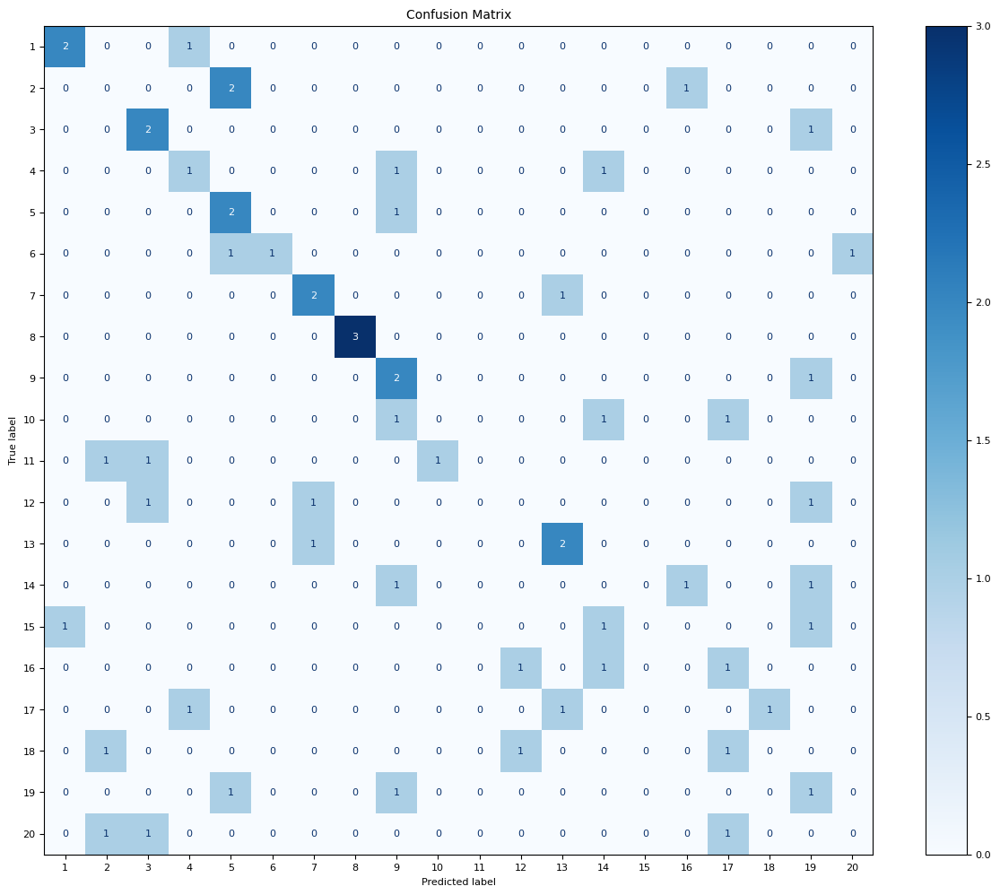

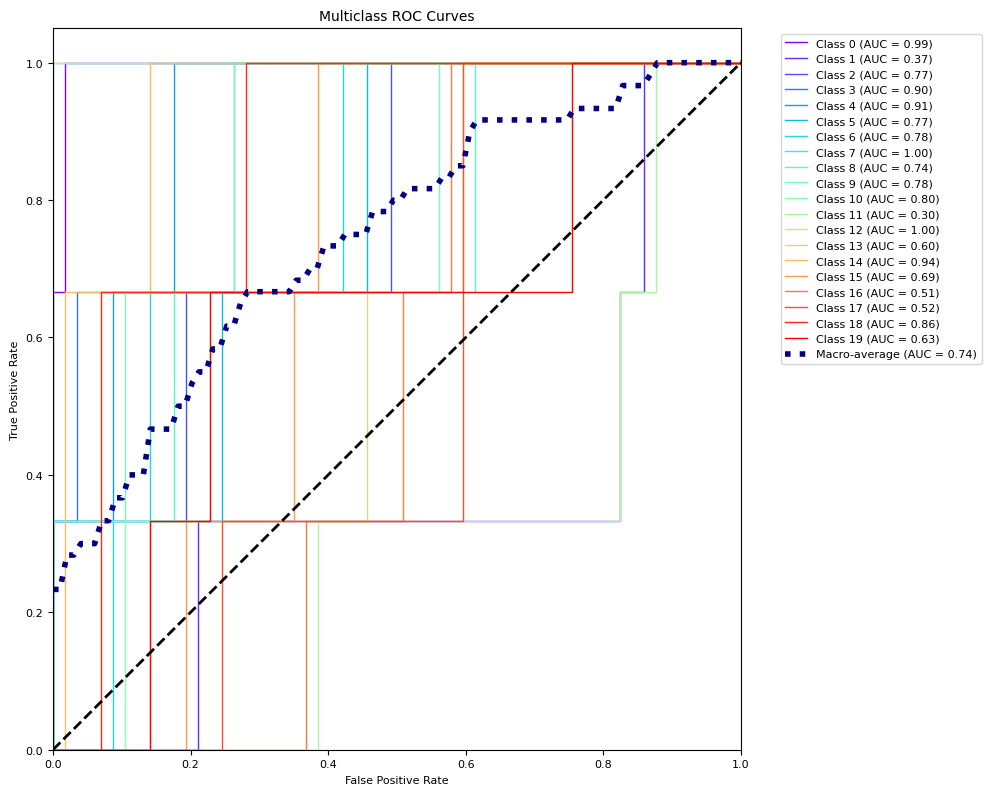

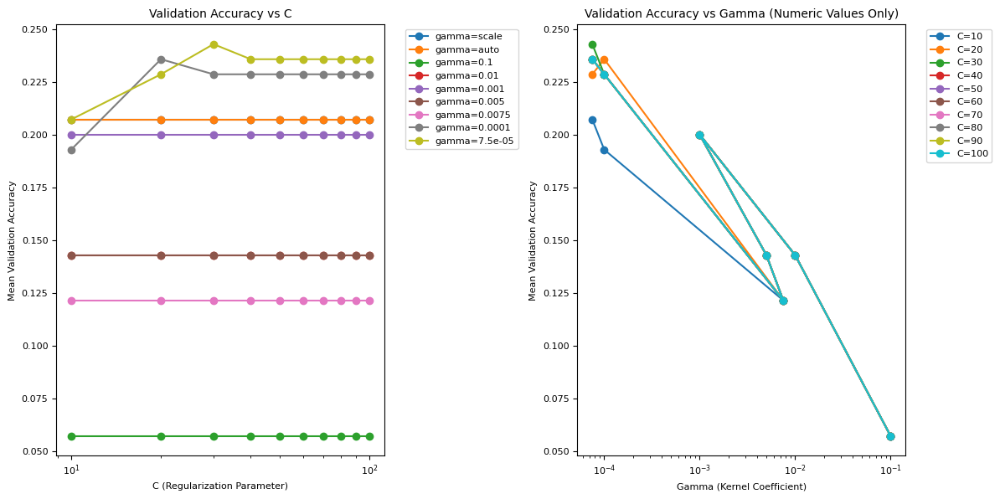

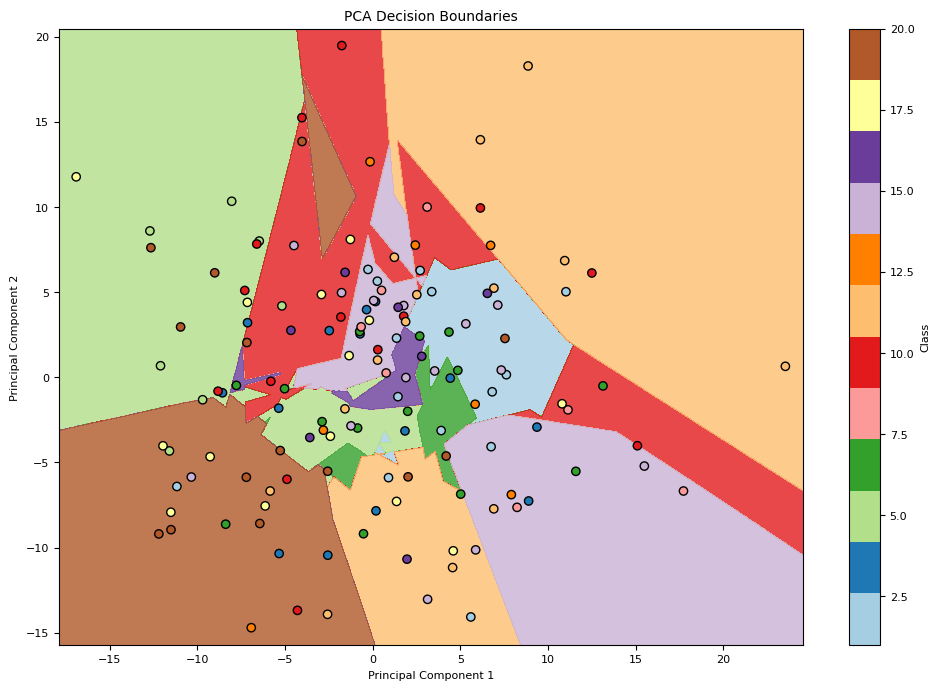


Best Parameters: {'C': 30, 'gamma': 7.5e-05, 'kernel': 'rbf'}
Test Accuracy: 0.3000
Macro-average AUC: 0.7436

Classification Report:
              precision    recall  f1-score   support

           1       0.67      0.67      0.67         3
           2       0.00      0.00      0.00         3
           3       0.40      0.67      0.50         3
           4       0.33      0.33      0.33         3
           5       0.33      0.67      0.44         3
           6       1.00      0.33      0.50         3
           7       0.50      0.67      0.57         3
           8       1.00      1.00      1.00         3
           9       0.29      0.67      0.40         3
          10       0.00      0.00      0.00         3
          11       0.00      0.00      0.00         3
          12       0.00      0.00      0.00         3
          13       0.50      0.67      0.57         3
          14       0.00      0.00      0.00         3
          15       0.00      0.00      0.00         3


/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(resu

In [140]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler, label_binarize
from sklearn.metrics import (accuracy_score, classification_report, 
                             confusion_matrix, ConfusionMatrixDisplay,
                             roc_curve, auc, RocCurveDisplay)
from sklearn.model_selection import GridSearchCV
from sklearn.decomposition import PCA
#Use 50 categories
index_seen = np.squeeze(np.where(label_seen < 51, True, False))
index_unseen = np.squeeze(np.where(label_unseen < 51, True, False))

#Use 20 categories
# index_seen = np.squeeze(np.where(label_seen < 21, True, False))
# index_unseen = np.squeeze(np.where(label_unseen < 21, True, False))

brain_seen = brain_seen[index_seen, :]
image_seen = image_seen[index_seen, :]
text_seen = text_seen[index_seen, :]
label_seen = label_seen[index_seen]
brain_unseen = brain_unseen[index_unseen, :]
image_unseen = image_unseen[index_unseen, :]
text_unseen = text_unseen[index_unseen, :]
label_unseen = label_unseen[index_unseen]



# Data Preparation and Preprocessing
num_classes = 20
samples_per_class = 10

# Create training and test sets
new_train_brain, new_test_brain = [], []
new_train_label, new_test_label = [], []

for i in range(num_classes):
    start_idx = i * samples_per_class
    end_idx = start_idx + samples_per_class
    class_data_brain = brain_seen[start_idx:end_idx, :]
    class_data_label = label_seen[start_idx:end_idx, :]
    
    new_train_brain.append(class_data_brain[:7])
    new_test_brain.append(class_data_brain[7:])
    new_train_label.append(class_data_label[:7])
    new_test_label.append(class_data_label[7:])

# Convert to numpy arrays
train_brain = torch.vstack(new_train_brain).numpy()
train_label = torch.vstack(new_train_label).numpy().ravel()
test_brain = torch.vstack(new_test_brain).numpy()
test_label = torch.vstack(new_test_label).numpy().ravel()

# Feature Scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(train_brain)
X_test_scaled = scaler.transform(test_brain)

# SVM with RBF Kernel and Grid Search
param_grid = {
    'C': [ 10,20, 30, 40, 50, 60, 70 ,80, 90, 100],
    'gamma': ['scale', 'auto', 0.1, 0.01, 0.001,0.005,0.0075,0.0001, 0.000075], 
    'kernel': ['rbf']
}

svm = GridSearchCV(SVC(probability=True, class_weight='balanced'), 
                  param_grid, cv=5, n_jobs=-1, verbose=1)
svm.fit(X_train_scaled, train_label)

# Best model evaluation
best_svm = svm.best_estimator_
y_pred = best_svm.predict(X_test_scaled)
y_proba = best_svm.predict_proba(X_test_scaled)

# 1. Confusion Matrix
plt.figure(figsize=(15, 12))
cm = confusion_matrix(test_label, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, 
                              display_labels=best_svm.classes_)
disp.plot(cmap='Blues', ax=plt.gca(), values_format='d')
plt.title("Confusion Matrix")
plt.show()

# 2. ROC Curve (OvR for multiclass)
y_test_bin = label_binarize(test_label, classes=np.unique(train_label))
n_classes = y_test_bin.shape[1]

fpr, tpr, roc_auc = dict(), dict(), dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_proba[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Macro-average ROC
fpr["macro"], tpr["macro"] = np.linspace(0, 1, 100), np.zeros(100)
for i in range(n_classes):
    fpr_interp = np.linspace(0, 1, 100)
    tpr_interp = np.interp(fpr_interp, fpr[i], tpr[i])
    tpr["macro"] += tpr_interp
tpr["macro"] /= n_classes
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

plt.figure(figsize=(10, 8))
colors = plt.cm.rainbow(np.linspace(0, 1, n_classes))
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=1,
             label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot(fpr["macro"], tpr["macro"],
         label=f'Macro-average (AUC = {roc_auc["macro"]:.2f})',
         color='navy', linestyle=':', linewidth=4)

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Multiclass ROC Curves')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# 3. Validation Curve (Using Grid Search Results)
plt.figure(figsize=(12, 6))

# Extract results in correct order
results_df = pd.DataFrame(svm.cv_results_)

# Plot for C parameter (left subplot)
plt.subplot(1, 2, 1)
for gamma_val in param_grid['gamma']:
    # Handle different gamma value types
    mask = results_df['param_gamma'].astype(str) == str(gamma_val)
    if mask.any():
        plt.semilogx(results_df[mask]['param_C'].astype(float), 
                    results_df[mask]['mean_test_score'], 
                    marker='o', 
                    label=f'gamma={gamma_val}')

plt.xlabel('C (Regularization Parameter)')
plt.ylabel('Mean Validation Accuracy')
plt.title('Validation Accuracy vs C')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Plot for Gamma parameter (right subplot)
plt.subplot(1, 2, 2)
for c_val in param_grid['C']:  # Use original C values from param_grid
    mask = results_df['param_C'].astype(float) == c_val
    # Filter numeric gamma values only for log scale
    numeric_gamma_mask = results_df['param_gamma'].apply(lambda x: isinstance(x, (int, float)))
    
    if mask.any() and numeric_gamma_mask.any():
        plt.semilogx(results_df[mask & numeric_gamma_mask]['param_gamma'].astype(float), 
                    results_df[mask & numeric_gamma_mask]['mean_test_score'], 
                    marker='o', 
                    label=f'C={c_val}')

plt.xlabel('Gamma (Kernel Coefficient)')
plt.ylabel('Mean Validation Accuracy')
plt.title('Validation Accuracy vs Gamma (Numeric Values Only)')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


# 4. PCA Visualization with Decision Boundaries
pca = PCA(n_components=2)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Train a SVM on PCA components for visualization
svm_pca = SVC(C=best_svm.C, gamma=best_svm.gamma, kernel='rbf', probability=True)
svm_pca.fit(X_train_pca, train_label)

# Create mesh grid
h = 0.02
x_min, x_max = X_train_pca[:, 0].min() - 1, X_train_pca[:, 0].max() + 1
y_min, y_max = X_train_pca[:, 1].min() - 1, X_train_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))

# Predict on mesh grid
Z = svm_pca.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

plt.figure(figsize=(12, 8))
plt.contourf(xx, yy, Z, alpha=0.8, cmap=plt.cm.Paired)
plt.scatter(X_train_pca[:, 0], X_train_pca[:, 1], c=train_label, 
            edgecolors='k', cmap=plt.cm.Paired)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA Decision Boundaries')
plt.colorbar(label='Class')
plt.show()

# Print final metrics
print(f"\nBest Parameters: {svm.best_params_}")
print(f"Test Accuracy: {accuracy_score(test_label, y_pred):.4f}")
print(f"Macro-average AUC: {roc_auc['macro']:.4f}")
print("\nClassification Report:")
print(classification_report(test_label, y_pred))

Performing grid search...
Fitting 5 folds for each of 20 candidates, totalling 100 fits

Best parameters: {'C': 0.1, 'gamma': 0.001, 'kernel': 'rbf'}

Training custom SVM...

Performance Comparison:
Custom SVM Accuracy: 0.0200
Scikit-learn SVM Accuracy: 0.0867

Classification Report (Scikit-learn):
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         3
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         3
           4       0.25      0.33      0.29         3
           5       0.09      0.33      0.14         3
           6       0.00      0.00      0.00         3
           7       0.25      0.33      0.29         3
           8       0.00      0.00      0.00         3
           9       0.20      0.33      0.25         3
          10       0.00      0.00      0.00         3
          11       0.00      0.00      0.00         3
          12       0.00      0.00      0.00        

/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/morgan/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(resu

TypeError: If no scoring is specified, the estimator passed should have a 'score' method. The estimator <__main__.CustomRBFSVM object at 0x3638da5e0> does not.

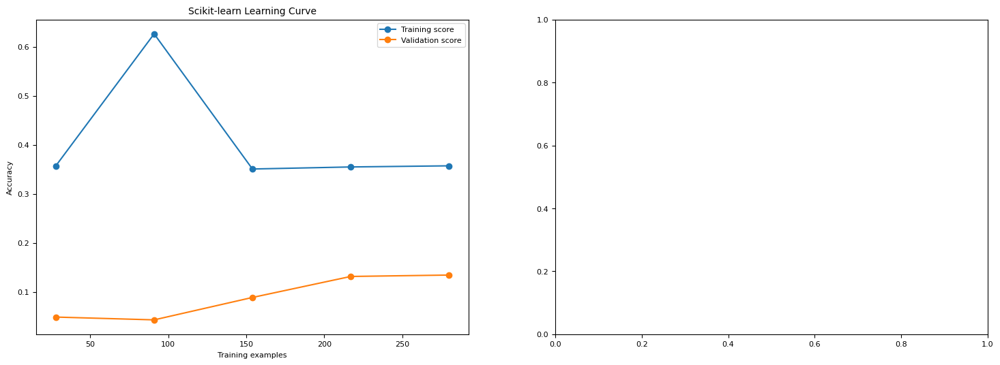

In [138]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV, learning_curve
from time import time

# Use 50 categories
index_seen = np.squeeze(np.where(label_seen < 51, True, False))
index_unseen = np.squeeze(np.where(label_unseen < 51, True, False))

# Filter data for 50 classes
brain_seen = brain_seen[index_seen, :]
label_seen = label_seen[index_seen]

# Data Preparation
num_classes = 50
samples_per_class = 10

# Create training and test sets
new_train_brain, new_test_brain = [], []
new_train_label, new_test_label = [], []

for i in range(num_classes):
    start_idx = i * samples_per_class
    end_idx = start_idx + samples_per_class
    class_data_brain = brain_seen[start_idx:end_idx, :]
    class_data_label = label_seen[start_idx:end_idx, :]
    
    new_train_brain.append(class_data_brain[:7])  # 70% training
    new_test_brain.append(class_data_brain[7:])   # 30% testing
    new_train_label.append(class_data_label[:7])
    new_test_label.append(class_data_label[7:])

# Convert to numpy arrays
X_train = torch.vstack(new_train_brain).numpy()
y_train = torch.vstack(new_train_label).numpy().ravel()
X_test = torch.vstack(new_test_brain).numpy()
y_test = torch.vstack(new_test_label).numpy().ravel()

# Feature scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Custom RBF SVM (Simplified binary implementation)
class CustomRBFSVM:
    def __init__(self, C=1.0, gamma=1.0, max_iter=500):
        self.C = C
        self.gamma = gamma
        self.max_iter = max_iter
        
    def _rbf_kernel(self, X1, X2):
        return np.exp(-self.gamma * np.sum((X1[:, np.newaxis] - X2)**2, axis=2))
    
    def fit(self, X, y):
        self.X_train = X
        self.y_train = y * 2 - 1  # Convert to -1/1 labels
        n_samples = X.shape[0]
        
        self.alpha = np.zeros(n_samples)
        self.b = 0.0
        
        K = self._rbf_kernel(X, X)
        
        for _ in range(self.max_iter):
            for i in range(n_samples):
                score = np.dot(K[i], self.alpha) + self.b
                if self.y_train[i] * score < 1:
                    self.alpha[i] += self.C * (self.y_train[i] - score)
                    self.alpha[i] = np.clip(self.alpha[i], 0, self.C)
                    
            self.b = np.mean(self.y_train - np.dot(K, self.alpha))
    
    def predict(self, X):
        K = self._rbf_kernel(X, self.X_train)
        scores = np.dot(K, self.alpha) + self.b
        return (np.sign(scores) + 1) // 2  # Convert back to 0/1 labels

# Grid Search for Scikit-learn SVM
param_grid = {
    'C': [0.1, 1, 10, 100],
    'gamma': ['scale', 'auto', 0.001, 0.01, 0.1],
    'kernel': ['rbf']
}

print("Performing grid search...")
grid_search = GridSearchCV(
    SVC(class_weight='balanced'),
    param_grid, 
    cv=5,
    n_jobs=-1,
    verbose=1
)
grid_search.fit(X_train_scaled, y_train)

best_svm = grid_search.best_estimator_
print(f"\nBest parameters: {grid_search.best_params_}")

# Train custom SVM with comparable parameters
custom_svm = CustomRBFSVM(
    C=grid_search.best_params_['C'],
    gamma=grid_search.best_params_['gamma'] if isinstance(grid_search.best_params_['gamma'], float) else 0.01,
    max_iter=500
)

print("\nTraining custom SVM...")
custom_start = time()
custom_svm.fit(X_train_scaled, y_train)
custom_time = time() - custom_start

# Evaluate models
custom_pred = custom_svm.predict(X_test_scaled)
sklearn_pred = best_svm.predict(X_test_scaled)

print("\nPerformance Comparison:")
print(f"Custom SVM Accuracy: {accuracy_score(y_test, custom_pred):.4f}")
print(f"Scikit-learn SVM Accuracy: {accuracy_score(y_test, sklearn_pred):.4f}")
print("\nClassification Report (Scikit-learn):")
print(classification_report(y_test, sklearn_pred))
print(f"\nTraining Times:\nCustom: {custom_time:.2f}s\nScikit-learn: {grid_search.refit_time_:.2f}s")

# Visualization settings for 50 classes
plt.rcParams.update({'font.size': 8, 'axes.titlesize': 10})

# Learning Curves
def plot_learning_curve(estimator, title, X, y, ax):
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=5, n_jobs=-1,
        train_sizes=np.linspace(0.1, 1.0, 5),
        random_state=42
    )
    
    ax.plot(train_sizes, np.mean(train_scores, axis=1), 'o-', label="Training score")
    ax.plot(train_sizes, np.mean(test_scores, axis=1), 'o-', label="Validation score")
    ax.set_title(title)
    ax.set_xlabel("Training examples")
    ax.set_ylabel("Accuracy")
    ax.legend()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
plot_learning_curve(best_svm, "Scikit-learn Learning Curve", X_train_scaled, y_train, ax1)
plot_learning_curve(custom_svm, "Custom SVM Learning Curve", X_train_scaled, y_train, ax2)
plt.tight_layout()
plt.show()

# Confusion Matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
ConfusionMatrixDisplay.from_predictions(y_test, custom_pred, ax=ax1, cmap='Blues', colorbar=False)
ConfusionMatrixDisplay.from_predictions(y_test, sklearn_pred, ax=ax2, cmap='Blues', colorbar=False)
ax1.set_title("Custom SVM Confusion Matrix")
ax2.set_title("Scikit-learn SVM Confusion Matrix")
plt.tight_layout()
plt.show()

# PCA Visualization
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train_scaled)

def plot_decision_boundary(model, X_pca, y, title, ax):
    xx, yy = np.meshgrid(np.linspace(X_pca[:,0].min()-1, X_pca[:,0].max()+1, 100),
                        np.linspace(X_pca[:,1].min()-1, X_pca[:,1].max()+1, 100))
    
    if isinstance(model, CustomRBFSVM):
        Z = model.predict(scaler.inverse_transform(pca.inverse_transform(np.c_[xx.ravel(), yy.ravel()])))
    else:
        Z = model.predict(scaler.inverse_transform(pca.inverse_transform(np.c_[xx.ravel(), yy.ravel()])))
    
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, alpha=0.3, cmap='viridis')
    ax.scatter(X_pca[:,0], X_pca[:,1], c=y, cmap='viridis', edgecolors='k', s=20)
    ax.set_title(title)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
plot_decision_boundary(custom_svm, X_pca, y_train, "Custom SVM Decision Boundaries", ax1)
plot_decision_boundary(best_svm, X_pca, y_train, "Scikit-learn SVM Decision Boundaries", ax2)
plt.tight_layout()
plt.show()

# Validation Curves from Grid Search
results_df = pd.DataFrame(grid_search.cv_results_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))

# C parameter validation
for gamma_val in param_grid['gamma']:
    mask = results_df['param_gamma'].astype(str) == str(gamma_val)
    if mask.any():
        ax1.semilogx(results_df[mask]['param_C'], 
                    results_df[mask]['mean_test_score'],
                    marker='o',
                    label=f'gamma={gamma_val}')

# Gamma parameter validation
for c_val in param_grid['C']:
    mask = results_df['param_C'] == c_val
    valid_gamma = results_df[mask]['param_gamma'].apply(lambda x: x if isinstance(x, float) else np.nan)
    ax2.semilogx(valid_gamma,
                results_df[mask]['mean_test_score'],
                marker='o',
                label=f'C={c_val}')

ax1.set_title("Validation Accuracy vs C")
ax2.set_title("Validation Accuracy vs Gamma")
ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
ax2.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Custom model


In [136]:
import numpy as np
import torch

# Assume the data preprocessing steps from the user's code are already done here

# Convert data to numpy arrays
train_features = train_brain_np
train_labels = train_label_np.ravel()
test_features = test_brain_np
test_labels = test_label_np.ravel()

# Define the Node and Leaf classes for the decision tree
class Node:
    def __init__(self, feature, threshold, left, right):
        self.feature = feature
        self.threshold = threshold
        self.left = left
        self.right = right

class Leaf:
    def __init__(self, value):
        self.value = value

# Implement the Decision Tree
class DecisionTree:
    def __init__(self, max_depth=None, min_samples_split=2, min_samples_leaf=1, max_features=None):
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.min_samples_leaf = min_samples_leaf
        self.max_features = max_features
        self.root = None

    def fit(self, X, y):
        self.root = self._build_tree(X, y, depth=0)

    def _build_tree(self, X, y, depth):
        num_samples, num_features = X.shape
        unique_classes = np.unique(y)
        
        # Check stopping criteria
        if (len(unique_classes) == 1) or (num_samples < self.min_samples_split) or \
           (self.max_depth and depth >= self.max_depth):
            return self._create_leaf(y)
        
        # Determine number of features to consider
        max_features = self.max_features if self.max_features else num_features
        selected_features = np.random.choice(num_features, max_features, replace=False)
        
        best_gain = -1
        best_feature, best_threshold = None, None
        
        # Find the best split
        for feature in selected_features:
            feature_values = X[:, feature]
            unique_vals = np.unique(feature_values)
            if len(unique_vals) < 2:
                continue
            thresholds = (unique_vals[:-1] + unique_vals[1:]) / 2
            for threshold in thresholds:
                gain = self._gini_gain(y, feature_values, threshold)
                if gain > best_gain:
                    best_gain = gain
                    best_feature = feature
                    best_threshold = threshold
        
        if best_gain <= 0:  # No gain, create leaf
            return self._create_leaf(y)
        
        # Split the data
        left_mask = X[:, best_feature] <= best_threshold
        right_mask = ~left_mask
        
        # Check leaf samples
        if left_mask.sum() < self.min_samples_leaf or right_mask.sum() < self.min_samples_leaf:
            return self._create_leaf(y)
        
        # Recursively build subtrees
        left = self._build_tree(X[left_mask], y[left_mask], depth + 1)
        right = self._build_tree(X[right_mask], y[right_mask], depth + 1)
        return Node(best_feature, best_threshold, left, right)
    
    def _gini(self, y):
        _, counts = np.unique(y, return_counts=True)
        prob = counts / len(y)
        return 1 - np.sum(prob ** 2)
    
    def _gini_gain(self, y, feature, threshold):
        parent_gini = self._gini(y)
        left_mask = feature <= threshold
        if left_mask.sum() == 0 or left_mask.sum() == len(y):
            return 0
        left_gini = self._gini(y[left_mask])
        right_gini = self._gini(y[~left_mask])
        n = len(y)
        child_gini = (left_mask.sum() / n) * left_gini + ((n - left_mask.sum()) / n) * right_gini
        return parent_gini - child_gini
    
    def _create_leaf(self, y):
        counts = np.bincount(y)
        return Leaf(np.argmax(counts))
    
    def predict(self, X):
        return np.array([self._traverse(x, self.root) for x in X])
    
    def _traverse(self, x, node):
        if isinstance(node, Leaf):
            return node.value
        if x[node.feature] <= node.threshold:
            return self._traverse(x, node.left)
        else:
            return self._traverse(x, node.right)

# Implement the Random Forest
class RandomForest:
    def __init__(self, n_estimators=100, max_depth=None, min_samples_split=2,
                 min_samples_leaf=1, max_features='sqrt'):
        self.n_estimators = n_estimators
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.min_samples_leaf = min_samples_leaf
        self.max_features = max_features
        self.trees = []
    
    def fit(self, X, y):
        n_samples = X.shape[0]
        for _ in range(self.n_estimators):
            # Bootstrap sample
            idx = np.random.choice(n_samples, n_samples, replace=True)
            X_sample, y_sample = X[idx], y[idx]
            # Determine max_features
            if self.max_features == 'sqrt':
                max_feat = int(np.sqrt(X.shape[1]))
            else:
                max_feat = self.max_features
            tree = DecisionTree(max_depth=self.max_depth,
                                min_samples_split=self.min_samples_split,
                                min_samples_leaf=self.min_samples_leaf,
                                max_features=max_feat)
            tree.fit(X_sample, y_sample)
            self.trees.append(tree)
    
    def predict(self, X):
        preds = np.zeros((len(self.trees), X.shape[0]), dtype=int)
        for i, tree in enumerate(self.trees):
            preds[i] = tree.predict(X)
        # Majority vote
        return np.apply_along_axis(lambda x: np.bincount(x).argmax(), axis=0, arr=preds)

# Train and evaluate the model
rf = RandomForest(n_estimators=100, max_depth=10, max_features='sqrt')
rf.fit(train_features, train_labels)
predictions = rf.predict(test_features)
accuracy = np.mean(predictions == test_labels)
print(f"Accuracy: {accuracy:.4f}")

KeyboardInterrupt: 

In [88]:
# --------------------------
# imports and others
# --------------------------
import torch
from collections import defaultdict
from sklearn.preprocessing import RobustScaler
import torch
from collections import defaultdict
import matplotlib.pyplot as plt  # For plotting the confusion matrix
import seaborn as sns            # For enhanced visualization


# Combine features
#X_train = torch.cat((train_brain, train_image, train_text), dim=1)  
#X_test = torch.cat((test_brain, test_image, test_text), dim=1)  
X_train = train_brain
X_test = test_brain

# Squeeze labels to shape [140] and [60]
y_train = train_label.squeeze().type(torch.long)  # Shape: [140]
y_test = test_label.squeeze().type(torch.long)    # Shape: [60]

print("Combined Training Features Shape:", X_train.shape)
print("Combined Testing Features Shape:", X_test.shape)
print("Training Labels Shape:", y_train.shape)
print("Testing Labels Shape:", y_test.shape)

# ------------------- Data Scaling Using PyTorch -------------------

def robust_scale_tensor(X):
    """
    Scales the input tensor X using the median and interquartile range (IQR).

    Parameters:
    X (torch.Tensor): Input tensor of shape [n_samples, n_features]

    Returns:
    torch.Tensor: Scaled tensor
    """
    median = torch.median(X, dim=0).values
    q75, q25 = torch.quantile(X, 0.75, dim=0), torch.quantile(X, 0.25, dim=0)
    iqr = q75 - q25
    # To avoid division by zero, replace zeros in IQR with ones
    iqr = torch.where(iqr == 0, torch.ones_like(iqr), iqr)
    X_scaled = (X - median) / iqr
    return X_scaled

# Apply the scaler
X_train_scaled = robust_scale_tensor(X_train)
X_test_scaled = robust_scale_tensor(X_test)

# Verify scaling
print("\nScaled Features Statistics:")
print("Training Features - Median (approx. 0):", torch.median(X_train_scaled, dim=0).values.mean().item())
print("Training Features - IQR (approx. 1):", (torch.quantile(X_train_scaled, 0.75, dim=0) - torch.quantile(X_train_scaled, 0.25, dim=0)).mean().item())

Combined Training Features Shape: torch.Size([140, 561])
Combined Testing Features Shape: torch.Size([60, 561])
Training Labels Shape: torch.Size([140])
Testing Labels Shape: torch.Size([60])

Scaled Features Statistics:
Training Features - Median (approx. 0): 0.0
Training Features - IQR (approx. 1): 1.0


In [89]:
# ------------------- Decision Tree Implementation -------------------

class DecisionTreeNode:
    def __init__(self, feature_index=None, threshold=None, left=None, right=None, *, value=None):
        self.feature_index = feature_index
        self.threshold = threshold
        self.left = left
        self.right = right
        self.value = value

class DecisionTreeClassifierScratch:
    def __init__(self, max_depth=100, min_samples_split=2, n_features=None):
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.n_features = n_features
        self.root = None

    def fit(self, X, y):
        """
        X: Tensor of shape [n_samples, n_features]
        y: Tensor of shape [n_samples]
        """
        # Determine label range
        self.min_label = torch.min(y).item()
        self.max_label = torch.max(y).item()
        self.n_classes = self.max_label - self.min_label + 1
        self.n_features_total = X.shape[1]
        if self.n_features is None:
            self.n_features = int(torch.sqrt(torch.tensor(self.n_features_total, dtype=torch.float)).item())
        self.root = self._grow_tree(X, y)

    def _gini(self, y):
        m = y.shape[0]
        if m == 0:
            return torch.tensor(0.0)
        # Use minlength to ensure the counts list covers all labels
        counts = torch.bincount(y - self.min_label, minlength=self.n_classes)
        probabilities = counts.float() / m
        return 1.0 - torch.sum(probabilities ** 2)

    def _best_split(self, X, y):
        m, n = X.shape
        if m <= 1:
            return None, None

        parent_gini = self._gini(y)
        best_gini = torch.inf
        best_feature, best_threshold = None, None

        # Randomly select features
        features = torch.randperm(n)[:self.n_features]

        for feature in features:
            # Sort data based on the current feature
            sorted_vals, sorted_indices = torch.sort(X[:, feature])
            sorted_y = y[sorted_indices]

            # Initialize counts
            num_left = torch.zeros(self.n_classes, dtype=torch.long)
            num_right = torch.bincount(sorted_y - self.min_label, minlength=self.n_classes).clone()

            for i in range(1, m):
                c = sorted_y[i - 1] - self.min_label
                num_left[c] += 1
                num_right[c] -= 1

                # Avoid splits with the same feature value
                if sorted_vals[i] == sorted_vals[i - 1]:
                    continue

                # Compute Gini impurity for left and right splits
                gini_left = 1.0
                if i > 0:
                    prob_left = num_left.float() / i
                    gini_left -= torch.sum(prob_left ** 2)

                gini_right = 1.0
                if (m - i) > 0:
                    prob_right = num_right.float() / (m - i)
                    gini_right -= torch.sum(prob_right ** 2)

                # Weighted average of Gini impurity
                gini = (i * gini_left + (m - i) * gini_right) / m

                # Update the best split if needed
                if gini < best_gini:
                    best_gini = gini
                    best_feature = feature.item()
                    best_threshold = (sorted_vals[i] + sorted_vals[i - 1]) / 2.0

        return best_feature, best_threshold

    def _grow_tree(self, X, y, depth=0):
        num_samples_per_class = torch.zeros(self.n_classes, dtype=torch.long)
        for cls in range(self.min_label, self.max_label + 1):
            num_samples_per_class[cls - self.min_label] = torch.sum(y == cls).item()
        predicted_class = self.min_label + torch.argmax(num_samples_per_class).item()
        node = DecisionTreeNode(value=predicted_class)

        # Check stopping criteria
        if depth < self.max_depth and y.shape[0] >= self.min_samples_split:
            feature, threshold = self._best_split(X, y)
            if feature is not None:
                # Split the data
                indices_left = X[:, feature] < threshold
                X_left, y_left = X[indices_left], y[indices_left]
                X_right, y_right = X[~indices_left], y[~indices_left]
                if X_left.shape[0] > 0 and X_right.shape[0] > 0:
                    node.feature_index = feature
                    node.threshold = threshold
                    node.left = self._grow_tree(X_left, y_left, depth + 1)
                    node.right = self._grow_tree(X_right, y_right, depth + 1)
                    node.value = None  # Not a leaf node
        return node

    def predict(self, X):
        """
        X: Tensor of shape [n_samples, n_features]
        Returns: List of predicted labels
        """
        return [self._predict(inputs) for inputs in X]

    def _predict(self, inputs):
        node = self.root
        while node.value is None:
            if inputs[node.feature_index] < node.threshold:
                node = node.left
            else:
                node = node.right
        return node.value

In [91]:
# ------------------- Random Forest Implementation -------------------

class RandomForestClassifierScratch:
    def __init__(self, n_trees=50, max_depth=1000, min_samples_split=2, n_features=None):
        self.n_trees = n_trees
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.n_features = n_features
        self.trees = []

    def fit(self, X, y):
        """
        X: Tensor of shape [n_samples, n_features]
        y: Tensor of shape [n_samples]
        """
        self.trees = []
        for i in range(self.n_trees):
            print(f"Training tree {i+1}/{self.n_trees}")
            # Bootstrap sampling
            indices = torch.randint(0, X.shape[0], (X.shape[0],))
            X_sample = X[indices]
            y_sample = y[indices]

            # Initialize and train a decision tree
            tree = DecisionTreeClassifierScratch(
                max_depth=self.max_depth,
                min_samples_split=self.min_samples_split,
                n_features=self.n_features if self.n_features else int(torch.sqrt(torch.tensor(X.shape[1], dtype=torch.float)).item())
            )
            tree.fit(X_sample, y_sample)
            self.trees.append(tree)

    def predict(self, X):
        """
        X: Tensor of shape [n_samples, n_features]
        Returns: Tensor of predicted labels [n_samples]
        """
        # Collect predictions from all trees
        tree_preds = torch.stack([torch.tensor(tree.predict(X)) for tree in self.trees], dim=1)  # Shape: [n_samples, n_trees]
        
        # Majority vote
        y_pred = torch.tensor([self._most_common_label(tree_pred) for tree_pred in tree_preds])
        return y_pred

    def _most_common_label(self, y):
        """
        y: Tensor of shape [n_trees]
        Returns: Most common label (int)
        """
        labels, counts = torch.unique(y, return_counts=True)
        max_count, _ = torch.max(counts, dim=0)
        most_common = labels[counts == max_count]
        return most_common[0].item()  # Return the first most common label
    

In [92]:
# ------------------- Evaluation Metrics -------------------

def accuracy_score_custom(y_true, y_pred):
    """
    Computes the accuracy between true and predicted labels.
    """
    return (y_true == y_pred).sum().item() / y_true.numel()

def classification_report_custom(y_true, y_pred):
    """
    Generates a classification report.
    """
    report = defaultdict(dict)
    classes = torch.unique(y_true)
    for cls in classes:
        tp = ((y_pred == cls) & (y_true == cls)).sum().item()
        fp = ((y_pred == cls) & (y_true != cls)).sum().item()
        fn = ((y_pred != cls) & (y_true == cls)).sum().item()
        precision = tp / (tp + fp) if (tp + fp) != 0 else 0.0
        recall = tp / (tp + fn) if (tp + fn) != 0 else 0.0
        f1 = 2 * precision * recall / (precision + recall) if (precision + recall) !=0 else 0.0
        support = (y_true == cls).sum().item()
        report[cls.item()]['precision'] = precision
        report[cls.item()]['recall'] = recall
        report[cls.item()]['f1-score'] = f1
        report[cls.item()]['support'] = support
    return report

def print_classification_report(report):
    """
    Prints the classification report in a readable format.
    """
    print(f"{'Class':<10}{'Precision':<10}{'Recall':<10}{'F1-Score':<10}{'Support':<10}")
    for cls, metrics in sorted(report.items()):
        print(f"{cls:<10}{metrics['precision']:<10.2f}{metrics['recall']:<10.2f}{metrics['f1-score']:<10.2f}{metrics['support']:<10}")

def confusion_matrix_custom(y_true, y_pred):
    """
    Computes the confusion matrix.

    Parameters:
    y_true (torch.Tensor): True labels of shape [n_samples]
    y_pred (torch.Tensor): Predicted labels of shape [n_samples]

    Returns:
    torch.Tensor: Confusion matrix of shape [n_classes, n_classes]
    torch.Tensor: Sorted unique labels
    """
    unique_labels = torch.unique(torch.cat((y_true, y_pred)))
    n_labels = unique_labels.size(0)
    cm = torch.zeros(n_labels, n_labels, dtype=torch.long)
    label_to_index = {label.item(): idx for idx, label in enumerate(unique_labels)}
    for true, pred in zip(y_true, y_pred):
        if true.item() in label_to_index and pred.item() in label_to_index:
            cm[label_to_index[true.item()], label_to_index[pred.item()]] +=1
    return cm, unique_labels

def print_confusion_matrix(cm, labels):
    """
    Prints the confusion matrix in a readable format.

    Parameters:
    cm (torch.Tensor): Confusion matrix of shape [n_classes, n_classes]
    labels (torch.Tensor): Sorted unique labels
    """
    print("\nConfusion Matrix:")
    header = "\t" + "\t".join([str(label.item()) for label in labels])
    print(header)
    for i, label in enumerate(labels):
        row = [str(cm[i, j].item()) for j in range(len(labels))]
        print(f"{label.item()}\t" + "\t".join(row))
    
    # Optional: Visualize using seaborn
    cm_np = cm.numpy()
    labels_np = labels.numpy()
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm_np, annot=True, fmt='d', cmap='Blues', xticklabels=labels_np, yticklabels=labels_np)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()

Training tree 1/20
Training tree 2/20
Training tree 3/20
Training tree 4/20
Training tree 5/20
Training tree 6/20
Training tree 7/20
Training tree 8/20
Training tree 9/20
Training tree 10/20
Training tree 11/20
Training tree 12/20
Training tree 13/20
Training tree 14/20
Training tree 15/20
Training tree 16/20
Training tree 17/20
Training tree 18/20
Training tree 19/20
Training tree 20/20

Random Forest trained successfully.

Test Accuracy: 0.1667

Classification Report:
Class     Precision Recall    F1-Score  Support   
1         0.67      0.67      0.67      3         
2         0.17      0.33      0.22      3         
3         0.33      0.33      0.33      3         
4         0.00      0.00      0.00      3         
5         0.20      0.33      0.25      3         
6         0.00      0.00      0.00      3         
7         0.00      0.00      0.00      3         
8         0.00      0.00      0.00      3         
9         0.00      0.00      0.00      3         
10        0.33 

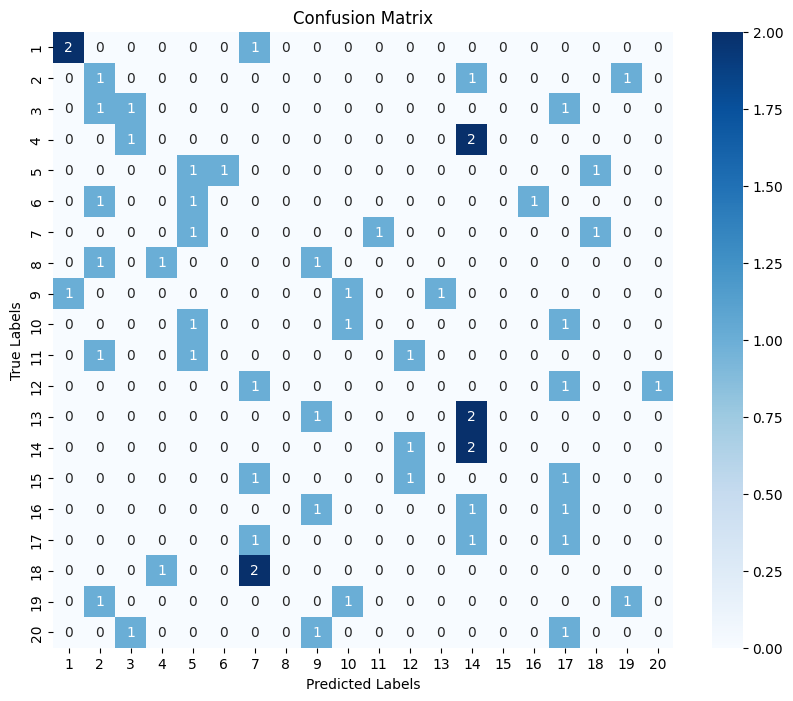

In [94]:

from sklearn.preprocessing import RobustScaler

# ------------------- Training and Evaluation -------------------

X_train_torch = train_brain
X_test_torch = test_brain  

# Convert PyTorch tensors to NumPy arrays
X_train = X_train_torch.numpy()
X_test = X_test_torch.numpy()
y_train = train_label.numpy().ravel()
y_test = test_label.numpy().ravel()

# Initialize the Random Forest
rf = RandomForestClassifierScratch(
    n_trees=20,           # Adjust as needed
    max_depth=200,         # Adjust based on data complexity
    min_samples_split=2,  # Default value
    n_features=None       # Defaults to sqrt(n_features_total)
)

# Convert scaled data back to PyTorch tensors
X_train_torch = torch.tensor(X_train, dtype=torch.float32)
y_train_torch = torch.tensor(y_train, dtype=torch.long)

# Train the model with scaled data
rf.fit(X_train_torch, y_train_torch)
print("\nRandom Forest trained successfully.")

# Make predictions on the test set
y_pred = rf.predict(X_test_torch)

# Convert y_test to a PyTorch tensor
y_test_torch = torch.tensor(y_test, dtype=torch.long)

# Calculate accuracy
accuracy = accuracy_score_custom(y_test_torch, y_pred)
print(f"\nTest Accuracy: {accuracy:.4f}")

# Generate a classification report
report = classification_report_custom(y_test_torch, y_pred)
print("\nClassification Report:")
print_classification_report(report)

# Compute confusion matrix
cm, labels = confusion_matrix_custom(y_test_torch, y_pred)
print_confusion_matrix(cm, labels)



In [95]:
# ------------------- Cross-Validation -------------------

def k_fold_cross_validation(X, y, k=5, n_trees=10, max_depth=10, min_samples_split=2):
    """
    Performs k-fold cross-validation on the dataset.

    Parameters:
    X (torch.Tensor): Features tensor of shape [n_samples, n_features]
    y (torch.Tensor): Labels tensor of shape [n_samples]
    k (int): Number of folds
    n_trees (int): Number of trees in the Random Forest
    max_depth (int): Maximum depth of each tree
    min_samples_split (int): Minimum samples required to split a node

    Returns:
    List of accuracy scores for each fold
    """
    from sklearn.model_selection import KFold
    kf = KFold(n_splits=k, shuffle=True, random_state=42)
    accuracies = []

    for fold, (train_index, val_index) in enumerate(kf.split(X)):
        print(f"\nStarting Fold {fold+1}/{k}")
        X_fold_train, X_fold_val = X[train_index], X[val_index]
        y_fold_train, y_fold_val = y[train_index], y[val_index]

        # Scale the training and validation data
        X_fold_train_scaled = robust_scale_tensor(X_fold_train)
        # Use the median and IQR from training to scale validation
        median = torch.median(X_fold_train, dim=0).values
        q75, q25 = torch.quantile(X_fold_train, 0.75, dim=0), torch.quantile(X_fold_train, 0.25, dim=0)
        iqr = q75 - q25
        iqr = torch.where(iqr == 0, torch.ones_like(iqr), iqr)
        X_fold_val_scaled = (X_fold_val - median) / iqr

        # Initialize the Random Forest
        rf_fold = RandomForestClassifierScratch(
            n_trees=n_trees,
            max_depth=max_depth,
            min_samples_split=min_samples_split,
            n_features=None
        )

        # Train the model
        rf_fold.fit(X_fold_train_scaled, y_fold_train)
        print(f"Fold {fold+1} Random Forest trained.")

        # Make predictions on the validation set
        y_fold_pred = rf_fold.predict(X_fold_val_scaled)

        # Calculate accuracy
        fold_accuracy = accuracy_score_custom(y_fold_val, y_fold_pred)
        accuracies.append(fold_accuracy)
        print(f"Fold {fold+1} Accuracy: {fold_accuracy:.4f}")

    return accuracies

In [ ]:
from itertools import product

def grid_search_rf(X, y, param_grid, n_jobs=4):
    """
    Performs grid search over the specified hyperparameters.
    
    Parameters:
    X (torch.Tensor): Features tensor
    y (torch.Tensor): Labels tensor
    param_grid (dict): Dictionary with parameters names as keys and lists of parameter settings to try as values
    n_jobs (int): Number of parallel processes
    
    Returns:
    best_params (dict): Parameters with the highest accuracy
    best_score (float): Highest accuracy achieved
    """
    keys = list(param_grid.keys())
    values = list(param_grid.values())
    best_score = 0
    best_params = {}
    
    for instance in product(*values):
        params = dict(zip(keys, instance))
        rf = RandomForestClassifierScratch(
            n_trees=params.get('n_trees', 100),
            max_depth=params.get('max_depth', 10),
            min_samples_split=params.get('min_samples_split', 2),
            min_samples_leaf=params.get('min_samples_leaf', 1),
            n_features=params.get('n_features', None),
            n_jobs=n_jobs
        )
        rf.fit(X, y)
        y_pred = rf.predict(X_test_scaled)
        accuracy = accuracy_score_custom(y_test, y_pred)
        print(f"Params: {params}, Accuracy: {accuracy:.4f}")
        if accuracy > best_score:
            best_score = accuracy
            best_params = params
    
    return best_params, best_score

# Define the parameter grid
param_grid = {
    'n_trees': [10, 50, 100],
    'max_depth': [10, 15, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2, 5],
    'n_features': [None, 50, 100]
}

# Perform grid search
best_params, best_score = grid_search_rf(X_train_balanced, y_train_balanced, param_grid, n_jobs=4)
print(f"\nBest Params: {best_params}, Best Accuracy: {best_score:.4f}")

# evaluation

In [43]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, f1_score
# (A) Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

# (B) Classification Report (includes precision, recall, F1-score for each class)
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# (C) Accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")

# (D) F1-scores
f1_macro = f1_score(y_test, y_pred, average='macro')
f1_weighted = f1_score(y_test, y_pred, average='weighted')
print(f"F1 Score (Macro): {f1_macro:.4f}")
print(f"F1 Score (Weighted): {f1_weighted:.4f}")

Confusion Matrix:
[[3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0]
 [0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 2 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]
 [0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 1 0 0 2 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 2 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3]]

Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.0

# Model Pardigms 

In [112]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# ==================================================================
# 1. Data Preparation & Conversion
# ==================================================================

# Convert all data to float32 and create datasets
train_brain = train_brain.float()
train_text = train_text.float()
train_image = train_image.float()
test_brain = test_brain.float()
test_text = test_text.float()
test_image = test_image.float()

# Create fused semantic embeddings (text + image)
train_semantic = torch.cat([train_text, train_image], dim=1)
test_semantic = torch.cat([test_text, test_image], dim=1)

# Create class prototypes for unseen classes (assuming 20 classes with 3 samples each)
num_unseen_classes = 20
samples_per_class = 3
test_semantic_proto = test_semantic.reshape(num_unseen_classes, samples_per_class, -1).mean(dim=1)

# Create validation split
val_size = int(0.1 * len(train_brain))
train_dataset = TensorDataset(train_brain[:-val_size], train_semantic[:-val_size])
val_dataset = TensorDataset(train_brain[-val_size:], train_semantic[-val_size:])

# ==================================================================
# 2. Model Architecture (Enhanced)
# ==================================================================

class EEGSemanticMapper(nn.Module):
    def __init__(self, eeg_dim=561, semantic_dim=612):
        super().__init__()
        self.main = nn.Sequential(
            nn.Linear(eeg_dim, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(512, 768),
            nn.BatchNorm1d(768),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(768, semantic_dim)
        )
        
    def forward(self, x):
        return self.main(x)

# ==================================================================
# 3. Contrastive Loss Function
# ==================================================================

def nt_xent_loss(projections, targets, temperature=0.1):
    """
    Normalized Temperature-scaled Cross Entropy Loss (SimCLR style)
    """
    # Normalize projections and targets
    projections = nn.functional.normalize(projections, p=2, dim=1)
    targets = nn.functional.normalize(targets, p=2, dim=1)
    
    # Compute similarity matrix
    sim_matrix = torch.mm(projections, targets.T) / temperature
    
    # Create labels (diagonal represents positive pairs)
    labels = torch.arange(projections.size(0)).to(projections.device)
    
    return nn.CrossEntropyLoss()(sim_matrix, labels)

# ==================================================================
# 4. Training Setup
# ==================================================================

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = EEGSemanticMapper().to(device)
optimizer = optim.AdamW(model.parameters(), lr=1e-3, weight_decay=1e-4)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)
best_val_loss = float('inf')

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32)

# ==================================================================
# 5. Training Loop with Early Stopping
# ==================================================================

for epoch in range(100):
    # Training
    model.train()
    train_loss = 0.0
    for batch_eeg, batch_sem in train_loader:
        batch_eeg, batch_sem = batch_eeg.to(device), batch_sem.to(device)
        
        optimizer.zero_grad()
        projections = model(batch_eeg)
        loss = nt_xent_loss(projections, batch_sem)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    # Validation
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for batch_eeg, batch_sem in val_loader:
            batch_eeg, batch_sem = batch_eeg.to(device), batch_sem.to(device)
            projections = model(batch_eeg)
            val_loss += nt_xent_loss(projections, batch_sem).item()

    # Update learning rate
    avg_val_loss = val_loss / len(val_loader)
    scheduler.step(avg_val_loss)

    print(f"Epoch {epoch+1}: Train Loss {train_loss/len(train_loader):.4f}, Val Loss {avg_val_loss:.4f}")

    # Early stopping
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model.state_dict(), 'best_model.pth')
    else:
        print(f"Early stopping at epoch {epoch+1}")
        break

# ==================================================================
# 6. Zero-Shot Evaluation
# ==================================================================

# Load best model
model.load_state_dict(torch.load('best_model.pth'))
model.eval()

# Project test EEG to semantic space
with torch.no_grad():
    test_projections = model(test_brain.to(device))
    
# Convert to numpy for easier handling
test_proj_np = test_projections.cpu().numpy()
test_proto_np = test_semantic_proto.numpy()
test_labels_np = test_label.squeeze().numpy()

# Calculate similarity to class prototypes
similarities = test_proj_np @ test_proto_np.T
predicted_classes = similarities.argmax(axis=1)

# Calculate accuracy
accuracy = (predicted_classes == test_labels_np).mean()
print(f"Zero-Shot Accuracy: {accuracy * 100:.2f}%")

# Optional: Detailed classification report
from sklearn.metrics import classification_report
print("\nClassification Report:")
print(classification_report(test_labels_np, predicted_classes))

Epoch 1: Train Loss 3.4785, Val Loss 2.6323
Epoch 2: Train Loss 2.4767, Val Loss 2.5407
Epoch 3: Train Loss 1.7187, Val Loss 2.4626
Epoch 4: Train Loss 1.2724, Val Loss 2.4223
Epoch 5: Train Loss 0.9524, Val Loss 2.3960
Epoch 6: Train Loss 0.7723, Val Loss 2.3814
Epoch 7: Train Loss 0.5618, Val Loss 2.3652
Epoch 8: Train Loss 0.4762, Val Loss 2.3496
Epoch 9: Train Loss 0.3880, Val Loss 2.3463
Epoch 10: Train Loss 0.3330, Val Loss 2.3481
Early stopping at epoch 10
Zero-Shot Accuracy: 1.67%

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         3
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         3
           4       0.00      0.00      0.00         3
           5       0.00      0.00      0.00         3
           6       0.00      0.00      0.00         3
           7       0.00      0.00      0.00      

/var/folders/fg/6yv7dd5s2xj427fzbf0__bmw0000gn/T/ipykernel_1014/3698123067.py:134: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_model

In [113]:
import torch
import numpy as np

# ------------------------------------------------------------------
# Use ALL brain_seen for training and ALL brain_unseen for testing
# ------------------------------------------------------------------

# No train/test split on brain_seen
train_brain = brain_seen  # Shape: [N_seen, 561]
train_text = text_seen    # Shape: [N_seen, 512]
train_image = image_seen  # Shape: [N_seen, 100]
train_label = label_seen  # Shape: [N_seen, 1]

# Use ALL brain_unseen for testing
test_brain = brain_unseen  # Shape: [N_unseen, 561]
test_text = text_unseen    # Shape: [N_unseen, 512]
test_image = image_unseen  # Shape: [N_unseen, 100]
test_label = label_unseen  # Shape: [N_unseen, 1]

# Convert to float32 (critical for PyTorch compatibility)
train_brain = train_brain.float()
train_text = train_text.float()
train_image = train_image.float()

test_brain = test_brain.float()
test_text = test_text.float()
test_image = test_image.float()

# ------------------------------------------------------------------
# Create class prototypes for unseen classes (from test_text/test_image)
# ------------------------------------------------------------------
# Get unique unseen classes and average their embeddings
unseen_classes = torch.unique(test_label)
test_semantic_proto = torch.stack([
    torch.mean(test_text[test_label.squeeze() == cls], dim=0)
    for cls in unseen_classes
])

# Verify shapes
print(f"Train Brain: {train_brain.shape}")  # e.g., [140, 561]
print(f"Test Brain: {test_brain.shape}")    # e.g., [60, 561]
print(f"Test Semantic Prototypes: {test_semantic_proto.shape}")  # [num_unseen_classes, 512]

Train Brain: torch.Size([500, 561])
Test Brain: torch.Size([4000, 561])
Test Semantic Prototypes: torch.Size([50, 512])


In [114]:
class EEGtoText(nn.Module):
    def __init__(self, eeg_dim=561, text_dim=512):
        super().__init__()
        self.fc1 = nn.Linear(eeg_dim, 512)
        self.fc2 = nn.Linear(512, text_dim)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x

# Initialize model and optimizer
model = EEGtoText()
criterion = nn.CosineEmbeddingLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Train on ALL seen data
for epoch in range(100):
    optimizer.zero_grad()
    eeg_proj = model(train_brain)
    loss = criterion(eeg_proj, train_text, torch.ones(len(train_brain), dtype=torch.float32))
    loss.backward()
    optimizer.step()
    print(f"Epoch {epoch+1}, Loss: {loss.item():.4f}")

Epoch 1, Loss: 1.0037
Epoch 2, Loss: 0.7298
Epoch 3, Loss: 0.5806
Epoch 4, Loss: 0.5002
Epoch 5, Loss: 0.4528
Epoch 6, Loss: 0.4212
Epoch 7, Loss: 0.3968
Epoch 8, Loss: 0.3757
Epoch 9, Loss: 0.3566
Epoch 10, Loss: 0.3393
Epoch 11, Loss: 0.3241
Epoch 12, Loss: 0.3115
Epoch 13, Loss: 0.3016
Epoch 14, Loss: 0.2939
Epoch 15, Loss: 0.2881
Epoch 16, Loss: 0.2838
Epoch 17, Loss: 0.2805
Epoch 18, Loss: 0.2774
Epoch 19, Loss: 0.2743
Epoch 20, Loss: 0.2713
Epoch 21, Loss: 0.2689
Epoch 22, Loss: 0.2670
Epoch 23, Loss: 0.2652
Epoch 24, Loss: 0.2634
Epoch 25, Loss: 0.2616
Epoch 26, Loss: 0.2599
Epoch 27, Loss: 0.2582
Epoch 28, Loss: 0.2566
Epoch 29, Loss: 0.2550
Epoch 30, Loss: 0.2535
Epoch 31, Loss: 0.2519
Epoch 32, Loss: 0.2504
Epoch 33, Loss: 0.2488
Epoch 34, Loss: 0.2472
Epoch 35, Loss: 0.2457
Epoch 36, Loss: 0.2441
Epoch 37, Loss: 0.2426
Epoch 38, Loss: 0.2412
Epoch 39, Loss: 0.2398
Epoch 40, Loss: 0.2384
Epoch 41, Loss: 0.2370
Epoch 42, Loss: 0.2355
Epoch 43, Loss: 0.2340
Epoch 44, Loss: 0.23

In [115]:
with torch.no_grad():
    test_proj = model(test_brain)  # Project all unseen EEG to text space

# Compute similarity to class prototypes (not individual test samples)
similarity = test_proj @ test_semantic_proto.T  # Shape: [N_unseen_samples, num_unseen_classes]

# Predict labels by finding the closest prototype
predicted_labels = torch.argmax(similarity, dim=1)

# Calculate accuracy
accuracy = (predicted_labels == test_label.squeeze()).float().mean()
print(f"Zero-Shot Accuracy: {accuracy * 100:.2f}%")

Zero-Shot Accuracy: 1.55%


try zero shot learning 

1. Data Preparation

Goal:
Structure the data to enforce a strict separation between seen and unseen classes during training and testing.

Steps:

Use All Seen Data for Training:
train_brain (EEG data for seen classes)
train_text/train_image (semantic embeddings for seen classes)
No train-test split on seen data – maximize training data usage.
Use All Unseen Data for Testing:
test_brain (EEG data for unseen classes)
test_text/test_image (semantic embeddings for unseen classes)
No overlap between train_label and test_label.
Class Prototypes:
For each unseen class, compute the average semantic embedding (text or image) across all its samples:

In [ ]:
# Example: Compute text prototypes for 3 unseen classes
test_text_proto = torch.stack([
    test_text[test_label.squeeze() == cls].mean(dim=0) 
    for cls in torch.unique(test_label)
])

In [117]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.kernel_ridge import KernelRidge
from sklearn.metrics.pairwise import cosine_similarity

# Convert PyTorch tensors to numpy arrays
X_train = brain_seen.numpy()
y_text_train = text_seen.numpy()
X_test = brain_unseen.numpy()
text_unseen = text_unseen.numpy()
label_unseen = label_unseen.numpy().flatten()

# Standardize data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Train kernel ridge regression to map EEG → text embeddings
krr = KernelRidge(
    kernel='rbf',   # Non-linear mapping
    alpha=1e-3,     # Regularization strength
    gamma=0.01      # RBF kernel bandwidth
)
krr.fit(X_train, y_text_train)

# Get predicted text embeddings for test EEG data
pred_text = krr.predict(X_test)

# Create class prototypes for unseen classes
unique_classes = np.unique(label_unseen)
class_prototypes = []
for cls in unique_classes:
    # Average all text embeddings for this class
    cls_mask = (label_unseen == cls)
    class_prototypes.append(text_unseen[cls_mask].mean(axis=0))
class_prototypes = np.array(class_prototypes)

# Normalize for cosine similarity
pred_text_norm = pred_text / np.linalg.norm(pred_text, axis=1, keepdims=True)
prototypes_norm = class_prototypes / np.linalg.norm(class_prototypes, axis=1, keepdims=True)

# Find closest prototype for each test sample
similarities = cosine_similarity(pred_text_norm, prototypes_norm)
predicted_classes = unique_classes[np.argmax(similarities, axis=1)]

# Calculate accuracy
accuracy = np.mean(predicted_classes == label_unseen)
print(f"Zero-Shot Accuracy: {accuracy*100:.2f}%")

AttributeError: 'numpy.ndarray' object has no attribute 'numpy'

In [119]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.kernel_ridge import KernelRidge
from sklearn.metrics.pairwise import cosine_similarity

# Convert PyTorch tensors to numpy arrays (if they are tensors)
X_train = brain_seen.numpy() if hasattr(brain_seen, 'numpy') else brain_seen
y_text_train = text_seen.numpy() if hasattr(text_seen, 'numpy') else text_seen
X_test = brain_unseen.numpy() if hasattr(brain_unseen, 'numpy') else brain_unseen

# Remove .numpy() for text_unseen and label_unseen as they are already arrays
text_unseen = text_unseen  # Now handles both tensors and arrays
label_unseen = label_unseen.flatten()  # Ensure it's 1D

# Standardize data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Train kernel ridge regression to map EEG → text embeddings
krr = KernelRidge(
    kernel='rbf',   # Non-linear mapping
    alpha=1e-3,     # Regularization strength
    gamma=0.01      # RBF kernel bandwidth
)
krr.fit(X_train, y_text_train)

# Get predicted text embeddings for test EEG data
pred_text = krr.predict(X_test)


# Create class prototypes for unseen classes
unique_classes = np.unique(label_unseen)
class_prototypes = []
for cls in unique_classes:
    # Average all text embeddings for this class
    cls_mask = (label_unseen == cls)
    class_prototypes.append(text_unseen[cls_mask].mean(axis=0))
class_prototypes = np.array(class_prototypes)

# Check for NaN in predictions
assert not np.isnan(pred_text).any(), "NaN values found in predicted text embeddings"

# Check for NaN in prototypes
assert not np.isnan(class_prototypes).any(), "NaN values found in class prototypes"

# Handle zero-norm vectors in normalization
def safe_normalize(arr):
    norms = np.linalg.norm(arr, axis=1, keepdims=True)
    norms[norms == 0] = 1e-10  # Prevent division by zero
    return arr / norms

# Normalize for cosine similarity with safety checks
pred_text_norm = safe_normalize(pred_text)
prototypes_norm = safe_normalize(class_prototypes)

# Check normalized outputs
assert not np.isnan(pred_text_norm).any(), "NaN in normalized predictions"
assert not np.isnan(prototypes_norm).any(), "NaN in normalized prototypes"

# Find closest prototype for each test sample
similarities = cosine_similarity(pred_text_norm, prototypes_norm)
predicted_classes = unique_classes[np.argmax(similarities, axis=1)]

# Calculate accuracy
accuracy = np.mean(predicted_classes == label_unseen)
print(f"Zero-Shot Accuracy: {accuracy*100:.2f}%")

Zero-Shot Accuracy: 2.43%


In [ ]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import accuracy_score

# Assuming your data is already loaded as follows:
# brain_seen, text_seen, brain_unseen, text_unseen, label_unseen

# Convert PyTorch tensors to numpy arrays (if they are tensors)
X_train = brain_seen.numpy() if hasattr(brain_seen, 'numpy') else brain_seen
y_text_train = text_seen.numpy() if hasattr(text_seen, 'numpy') else text_seen
X_test = brain_unseen.numpy() if hasattr(brain_unseen, 'numpy') else brain_unseen

# Ensure label_unseen is a 1D array
label_unseen = label_unseen.flatten()

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize SVR with RBF kernel
svr = SVR(kernel='rbf', C=10, gamma=0.001)

# Wrap SVR with MultiOutputRegressor for multi-dimensional outputs
multi_svr = MultiOutputRegressor(svr)

# Train the model
print("Training SVR for Zero-Shot Learning...")
multi_svr.fit(X_train_scaled, y_text_train)
print("Training completed.")

# Predict text embeddings for test EEG data
print("Predicting embeddings for test data...")
pred_text = multi_svr.predict(X_test_scaled)

# Create class prototypes for unseen classes
unique_classes = np.unique(label_unseen)
class_prototypes = []
for cls in unique_classes:
    cls_mask = (label_unseen == cls)
    # Ensure there are samples for the class
    if np.sum(cls_mask) == 0:
        raise ValueError(f"No samples found for class {cls} in test data.")
    class_mean = text_unseen[cls_mask].mean(axis=0)
    class_prototypes.append(class_mean)
class_prototypes = np.array(class_prototypes)

# Check for NaN in predictions and prototypes
assert not np.isnan(pred_text).any(), "NaN values found in predicted text embeddings"
assert not np.isnan(class_prototypes).any(), "NaN values found in class prototypes"

# Define safe normalization function
def safe_normalize(arr):
    norms = np.linalg.norm(arr, axis=1, keepdims=True)
    norms[norms == 0] = 1e-10  # Prevent division by zero
    return arr / norms

# Normalize predicted embeddings and class prototypes
pred_text_norm = safe_normalize(pred_text)
prototypes_norm = safe_normalize(class_prototypes)

# Check normalized outputs
assert not np.isnan(pred_text_norm).any(), "NaN in normalized predictions"
assert not np.isnan(prototypes_norm).any(), "NaN in normalized prototypes"

# Compute cosine similarity
similarities = cosine_similarity(pred_text_norm, prototypes_norm)

# Assign classes based on highest similarity
predicted_classes = unique_classes[np.argmax(similarities, axis=1)]

# Calculate accuracy
accuracy = np.mean(predicted_classes == label_unseen)
print(f"Zero-Shot Accuracy: {accuracy * 100:.2f}%")

Training SVR for Zero-Shot Learning...
